In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
import pandas as pd
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 500)
import scipy as sp
from scipy import signal
from scipy import stats
import scikit_posthocs as scph
import warnings
warnings.filterwarnings("ignore")


import scipy.signal as scisig
import matplotlib 
from scipy.integrate import simps
matplotlib.rcParams.update({'figure.max_open_warning': 0})
#import scikit_posthocs as spost
#%matplotlib notebook
from sympy import Point, Line, pi
import re

import tkinter as tk
import glob
from tkinter import filedialog as fd
import os

#from tqdm.notebook import tqdm, trange
#import time    # to be used in loop iterations

from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from matplotlib import cm

#import scikit_posthocs as spost

In [2]:
frame_rate = 30
save_location = "C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Graphs/231121/"
my_pal = {"empty":"#00ADEF","MSB4":"#FFBA86","MSB5":"#F6635C","MSB6":"#C23373","MSB7":"#974EC3","MSB":"#ED2424","ChO":"yellow"}

arena_width_px = 144 #pixels
arena_height_px = 990 #pixels
arena_width = 6.08 #mm
arena_height = 44.5 #mm
height_conversion = arena_height/arena_height_px
width_conversion = arena_width/arena_width_px

print(height_conversion)
print(width_conversion)

laser_height_all = 3.5 #mm
print(laser_height_all)

measurements = pd.read_excel("C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Measurements_Arenas.xlsx")
#NEED TO CHANGE THE OTHER LASER HEIGHTS

0.04494949494949495
0.042222222222222223
3.5


In [3]:
def file_loader(path = r"/Users/alexandravieiradasilva/Dropbox/Paper MS Bristes activation/Laser Avoidance Analysis",titlez = "",dirname = ""):
    if len(dirname) == 0:
        root = tk.Tk()
        dirname = fd.askdirectory(parent=root,initialdir=path,title=titles)
        root.destroy()
    dataz_all = pd.DataFrame()
    for direct, folders, files in os.walk(dirname):
        filenamez1 = glob.glob(direct + '/*' + '.csv')
        if len(filenamez1) > 0:
            for filez in filenamez1:
                
                dataz = pd.read_csv(filez,header=None,names=["x","y","laser_y","laser_height"])
                dataz = dataz.iloc[:5400]
                
                if dataz.iloc[0].y > dataz.iloc[0].laser_y: #putting them all in the same orientation
                    dataz.y = dataz.y*-1 + dataz.laser_y*2 + dataz.laser_height
                
                #normalisation of the pixels: use the max width to calculate the width, normalise to this and multiply by the real numbers
                conversion_factor = arena_width/(dataz["x"].max()-dataz["x"].min())
                #print(dataz["y"].max(),dataz["y"].min())
                
                if dataz["y"].max()-dataz["y"].min() > 700: # this is an indication that the flies explored the whole arena
                    conversion_factor_y = arena_height/(dataz["y"].max()-dataz["y"].min())
                else:
                    for meas in measurements.File.unique():
                        if meas in filez:
                            height = measurements.query("File == @meas").Height
                            #print(height)
                            
                            conversion_factor_y = arena_height/float(height)*1.07
                            break
      
                #print(conversion_factor_y)
        
                dataz["x"] = dataz["x"]*conversion_factor
                dataz["norm_x"] = dataz["x"]-((dataz["x"].max()+dataz["x"].min())/2)
                
                
                dataz["y"] = dataz["y"]*conversion_factor_y
                
                
                dataz["laser_y"] = dataz["laser_y"]*conversion_factor_y
                dataz["laser_height"] = dataz["laser_height"]*conversion_factor_y
                dataz["norm_y"] = dataz["y"]-dataz["laser_y"]
                #print(dataz['norm_y'].max(),dataz['norm_y'].min())
                
                filez2 = filez.split("\\")
                
                dataz["Filename"] = filez2[-1]
                
                
                
                dataz_all = pd.concat([dataz_all,dataz])
                #print(filez2)
                
                
                
                #dataz_all_filled["norm_y"] = dataz_all_filled["y"]-dataz_all_filled["laser_y"]
                #dataz_all_filled["norm_x"] = dataz_all_filled["x"]-((dataz_all_filled["x"].max()+dataz_all_filled["x"].min())/2)
                #print(dataz_all_filled["x"].max(),dataz_all_filled["x"].min())
                #print(dataz_all_filled["norm_x"].max(),dataz_all_filled["norm_x"].min())
                
                
                
    dataz_all_filled = interpolate_nans(dataz_all)            
    dataz_all_dist = distance_travelled(dataz_all_filled)
    
    dataz_all_dist["speed"] = dataz_all_dist["Distance"]*frame_rate
    
    #print(dataz_all_dist.laser_height.max())
    #print(titlez)
    #print("")
    return dataz_all_dist

def interpolate_nans(datas):
    data_all = pd.DataFrame()
    for file in datas.Filename.unique():
        #print(file)
        data = datas.query("Filename == @file")
        data_filled = data.copy()
        nans = data_filled.query('y.isnull()', engine='python')
        if nans.shape[0] > 0:
            nans = pd.concat([nans,data_filled.iloc[-2:-1]])
            g = nans.index[0]
            post = 0
            count = 0
            for f in nans.index:
                if f-g == 0: # this is the first one: 
                    pre_y = data_filled.iloc[f-1].y
                    pre_x = data_filled.iloc[f-1].x
                    pre_normx = data_filled.iloc[f-1].norm_x
                    pre_normy = data_filled.iloc[f-1].norm_y
                else:
                    if f-g == 1:
                        count +=1
                    if f-g > 1:
                        count+=1
                        post_y = data_filled.iloc[g+1].y
                        post_x = data_filled.iloc[g+1].x
                        post_normy = data_filled.iloc[g+1].norm_y
                        post_normx = data_filled.iloc[g+1].norm_x
                        
                        interp_y = np.linspace(pre_y,post_y,count+2)
                        interp_x = np.linspace(pre_x,post_x,count+2)
                        interp_normy = np.linspace(pre_normy,post_normy,count+2)
                        interp_normx = np.linspace(pre_normx,post_normx,count+2)
                        
                        for n,q in enumerate(interp_y[1:-1]):
                            data_filled.at[g-count+n+1,'y'] = q
                        for n,q in enumerate(interp_x[1:-1]):
                            data_filled.at[g-count+n+1,'x'] = q
                        for n,q in enumerate(interp_normx[1:-1]):
                            data_filled.at[g-count+n+1,'norm_x'] = q
                        for n,q in enumerate(interp_normy[1:-1]):
                            data_filled.at[g-count+n+1,'norm_y'] = q
                        
                        
                        count = 0
                        pre_y = data_filled.iloc[f-1].y
                        pre_x = data_filled.iloc[f-1].x
                        pre_normy = data_filled.iloc[f-1].norm_y
                        pre_normx = data_filled.iloc[f-1].norm_x
                g=f
        data_all = pd.concat([data_all,data_filled])    
    return data_all


        
def crosses(data,condition,threshold_out = 15,threshold_in = 7.5):
    crosses_all = pd.DataFrame()
    crosses_tot = []
    reversals_tot = []
    distance_tot = []
    for file in data.Filename.unique():
        #print(file)
        dataz = data.query("Filename == @file")
        lim = dataz.laser_y.iloc[0]
        laser_pass = dataz.query("y > @dataz.laser_y.iloc[0] and y < @laser_height_all+@dataz.laser_y.iloc[0]")# and "y" > data.laser_y.iloc[0]+data.laser_height.iloc[0])
        if laser_pass.shape[0] > 0:
            laser_pass = pd.concat([laser_pass,dataz.iloc[-2:-1]])
            g = laser_pass.index[0]
            post = laser_pass.index.max()
            reversals = 0
            crosses = 0
            for f in laser_pass.index:
                if f-g == 0: # this is the first one:
                    pre = dataz.iloc[f-1].y
                else:
                    if f-g > 1:
                        new_pre = f
                        post = dataz.iloc[g+1].y
                        if pre < dataz.laser_y.iloc[0]:
                            if post < dataz.laser_y.iloc[0]:
                                reversals +=1
                            else:
                                crosses +=1
                        if pre > dataz.laser_y.iloc[0]+laser_height_all:
                            if post > dataz.laser_y.iloc[0]+laser_height_all:
                                reversals +=1
                            else:
                                crosses +=1 
                        pre = dataz.iloc[new_pre-1].y
                g=f
        else:
            crosses = 0
            reversals = 0
        
        distance = dataz.Distance.sum()
        #crosses_tot.append(crosses)
        #reversals_tot.append(reversals)
        #distance_tot.append(distance)
        upp_u = laser_height_all + threshold_out
        upp_l = laser_height_all + threshold_in
        
        low_u = -threshold_in
        low_l = -threshold_out
        
        threshed_up = dataz.query("norm_y > @upp_l and norm_y < @upp_u")
        threshed_down = dataz.query("norm_y > @low_l and norm_y < @low_u")
        
        threshed_all = pd.concat([threshed_up,threshed_down])
        
        speed_mean = threshed_all.speed.mean()
        speed_median = threshed_all.speed.median()
        
        #print(speed_mean)
        #print(speed_median)
        threshed_all.to_csv('C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/'+file+'_threshed_file.csv')
        
        crosses_all = pd.concat([crosses_all,pd.DataFrame({"Filename":[file],"Condition":[condition],"Crosses":[crosses],
                                                           "Distance":[distance],"Speed_median":[speed_median],
                                                          "Speed_mean":[speed_mean]})])
        
    #crosses = pd.DataFrame({"Condition":condition,"Crosses":crosses_tot,"Distance":distance_tot})
    return crosses_all,reversals_tot
        

    
    

def distance_travelled(datas):
    data_all = pd.DataFrame()
    for file in datas.Filename.unique():
        #print(file)
        datam = datas.query("Filename == @file")
        data = datam.reset_index()
        diffs_x = data["x"].diff()
        diffs_y = data["y"].diff()
        distance = np.sqrt((diffs_x*diffs_x)+(diffs_y*diffs_y))
        datam["Distance"] = distance
        
        data_all = pd.concat([data_all,datam])
    
    return data_all

def graphs_indivs_edges(data_filled,threshold_out,threshold_in,time = None):
    for file in data_filled.Filename.unique():
        print(file)
        datax = data_filled.query("Filename == @file")
        fig, ax = plt.subplots(figsize = [5,10])
        plt.plot(datax['norm_x'],datax['norm_y'])
        
        #print(datax["laser_height"].iloc[0])
        #plt.hlines(datax["laser_y"].iloc[0],0,1000,color='r')
        #plt.hlines(datax["laser_y"].iloc[0]+datax["laser_height"].iloc[0],0,1000,color='r')
        if time == None:
            plt.hlines(0,-6,6,color='r')
            #plt.hlines(datax["laser_height"].iloc[0],0,1000,color='r')
            plt.hlines(laser_height_all,-6,6,color='r')
            plt.fill_between([-6,6],[0,0],[laser_height_all,laser_height_all],color='r',alpha=0.3)
            plt.title(file)#[-50:-30])
        else:
            plt.hlines(-threshold_out,-6,6,color='r')
            plt.hlines(-threshold_in,-6,6,color='r')

            plt.hlines(laser_height_all+threshold_out,-6,6,color='r')
            plt.hlines(laser_height_all+threshold_in,-6,6,color='r')
            plt.title(file+" "+str(time))#[-50:-30])
            
        ax.set_xlim(-5,5)
        ax.set_ylim(-25,30)
        plt.show()
        
def perc_time(data,condition):
    perc_all = []
    for file in data.Filename.unique():
        datz = data.query("Filename == @file")
        lim = datz.iloc[0].laser_y + datz.iloc[0].laser_height
        low = datz.iloc[0].laser_y
        upper = datz.query("y > @lim")
        lower = datz.query("y < @low")
        perc = upper.shape[0]/(upper.shape[0]+lower.shape[0])
        perc_all.append(perc)
    perc_all = pd.DataFrame({"Perc":perc_all,"Condition":condition})
    return perc_all



In [4]:
MSB = file_loader(titlez = "MSB",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_MSATR")

In [5]:
empty = file_loader(titlez = "empty",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_empty")
MSB4 = file_loader(titlez = "MSB4",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_MSB4")
MSB5 = file_loader(titlez = "MSB5",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_MSB5")
MSB6 = file_loader(titlez = "MSB6",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_MSB6")
MSB7 = file_loader(titlez = "MSB7",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_MSB7")
MSB = file_loader(titlez = "MSB",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_MSATR")
CHO = file_loader(titlez = "ChO",dirname="C:/Users/Anna/Documents/Science/MendesLab/codes/Xana/laser_Avoidance/Data_CHOATR")

In [6]:
def graphs_indivs(data_filled,threshold = None,time = None,save_loc = ""):
    for file in data_filled.Filename.unique():
        print(file)
        datax = data_filled.query("Filename == @file")
        print(datax.norm_x.max())
        print(datax.norm_x.min())
        fig, ax = plt.subplots(figsize = [5,10])
        plt.plot(datax['norm_x'],datax['norm_y'])
        
        #print(datax["laser_height"].iloc[0])
        #plt.hlines(datax["laser_y"].iloc[0],0,1000,color='r')
        #plt.hlines(datax["laser_y"].iloc[0]+datax["laser_height"].iloc[0],0,1000,color='r')
        if threshold == None:
            plt.hlines(0,-6,6,color='r')
            #plt.hlines(datax["laser_height"].iloc[0],0,1000,color='r')
            plt.hlines(laser_height_all,-6,6,color='r')
            plt.fill_between([-6,6],[0,0],[laser_height_all,laser_height_all],color='r',alpha=0.3)
            plt.title(file)#[-50:-30])
        else:
            plt.hlines(-threshold,-6,6,color='r')
            plt.hlines(laser_height_all+threshold,-6,6,color='r')
            plt.title(file+" "+str(time))#[-50:-30])
            
        ax.set_xlim(-5,5)
        ax.set_ylim(-25,30)
        
        plt.savefig(save_location+save_loc+file+'_traj.png')
        plt.show()

20230223_Sens30ATR_laser_16-03062023144903-0000.tracked.csv
3.04
-3.0400000000000005


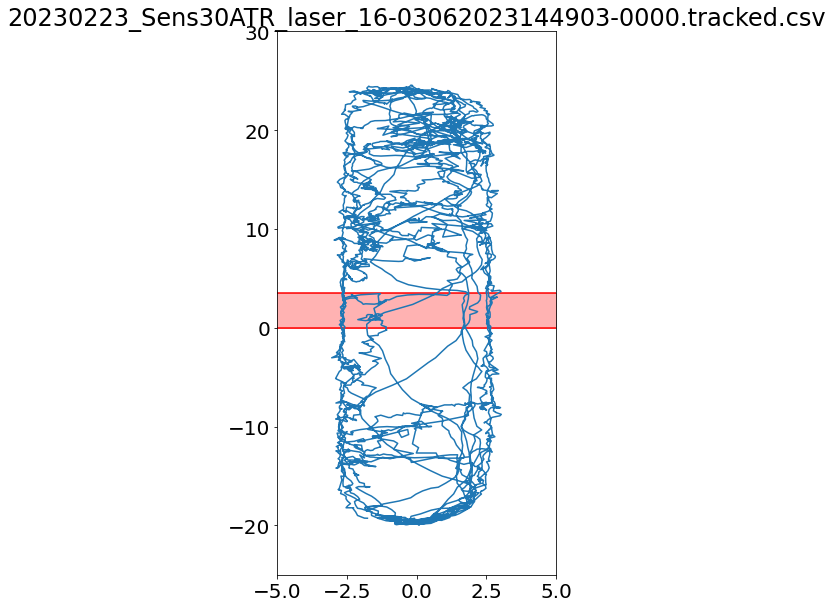

20230223_Sens30ATR_laser_18-03062023145722-0000.tracked.csv
3.039999999999999
-3.04


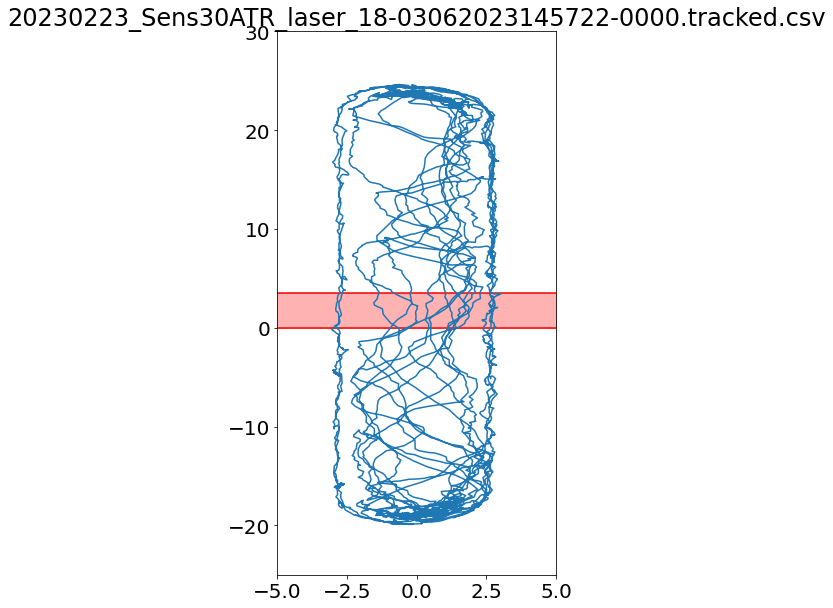

20230223_Sens30ATR_laser_19-03062023150303-0000.tracked.csv
3.04
-3.0399999999999996


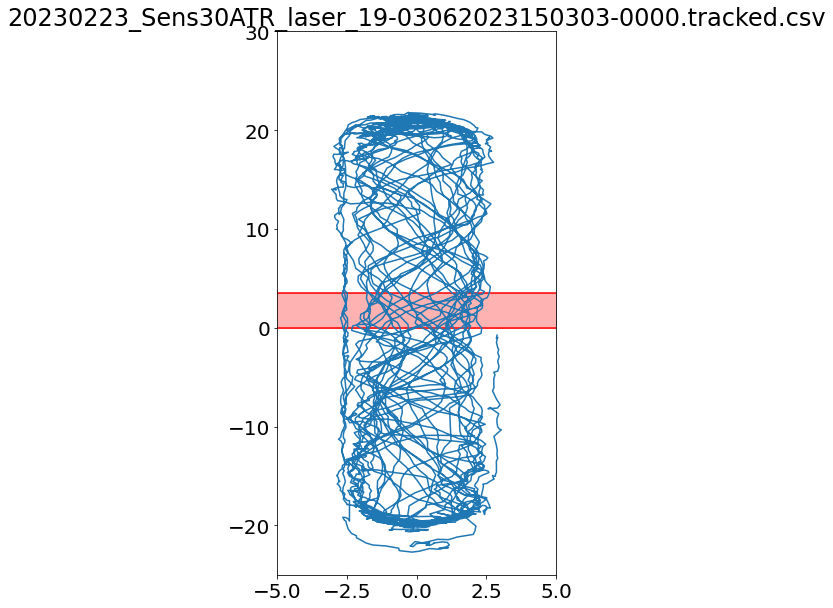

20230223_Sens30ATR_laser_20-03062023150725-0000.tracked.csv
3.040000000000001
-3.04


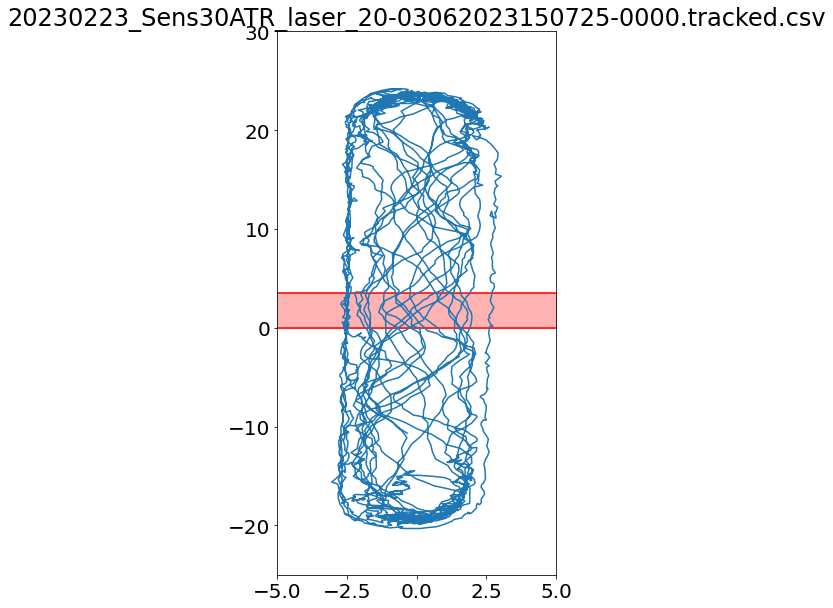

2023028_Sens30ATR_laser_1-02282023160149-0000.tracked.csv
3.040000000000001
-3.04


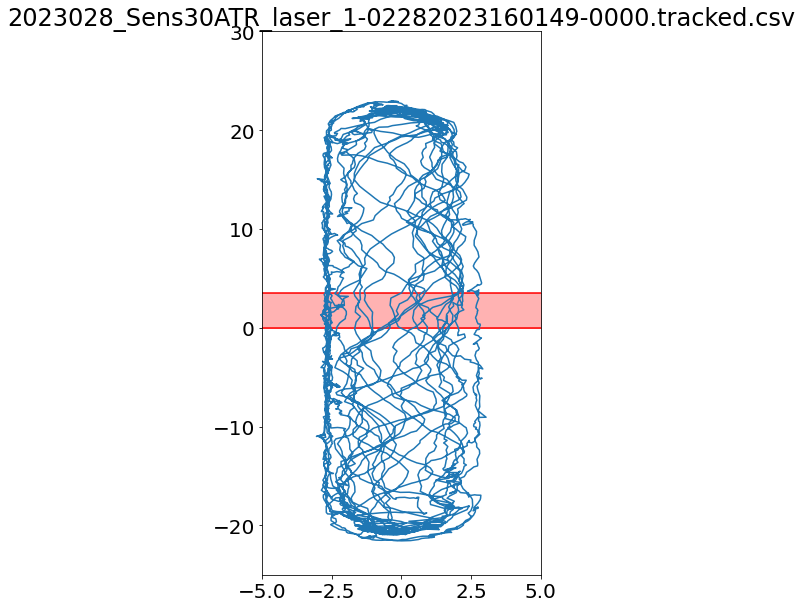

2023028_Sens30ATR_laser_10-02282023165028-0000.tracked.csv
3.04
-3.04


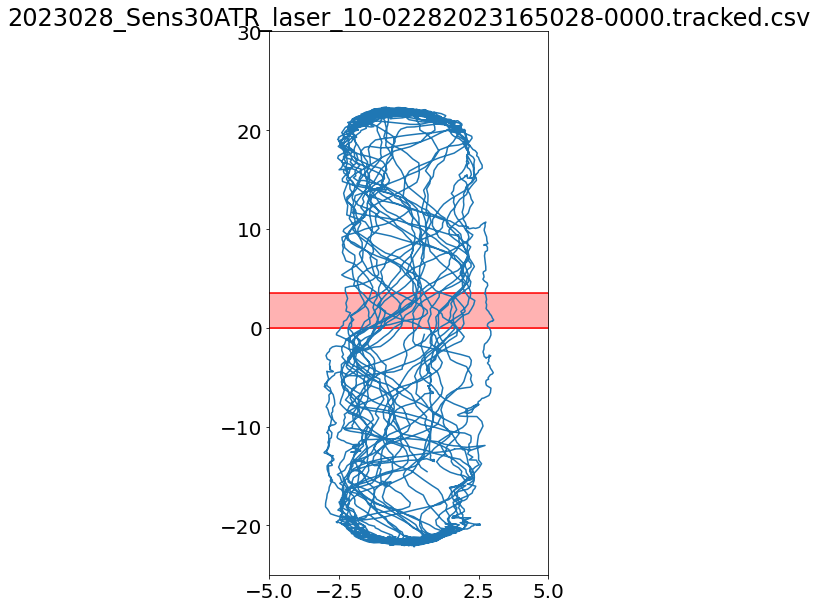

2023028_Sens30ATR_laser_11-02282023165518-0000.tracked.csv
3.04
-3.04


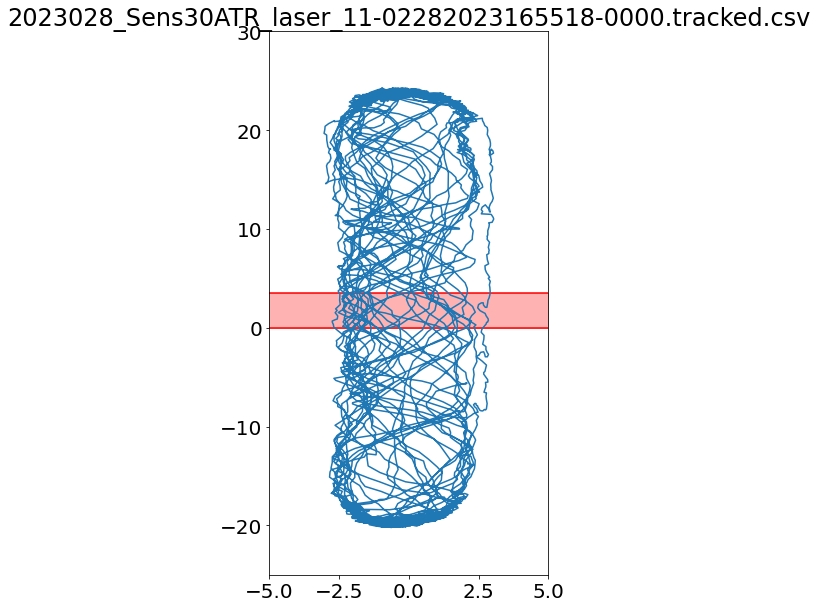

2023028_Sens30ATR_laser_12-02282023165947-0000.tracked.csv
3.04
-3.04


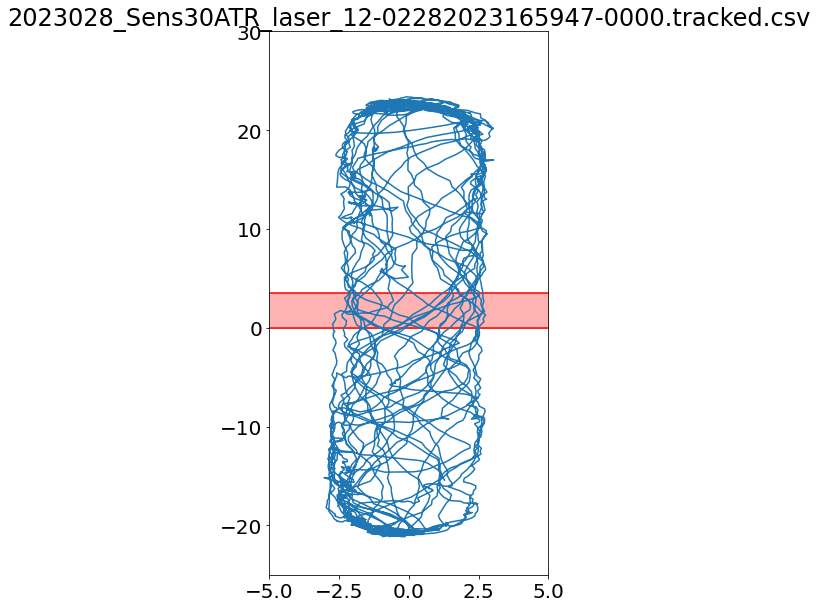

2023028_Sens30ATR_laser_13-02282023170406-0000.tracked.csv
3.04
-3.04


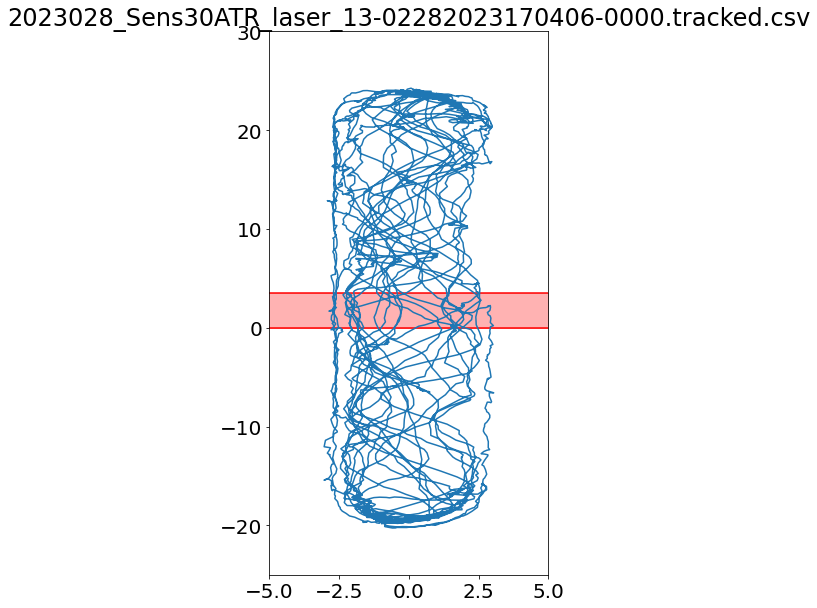

2023028_Sens30ATR_laser_14-02282023170850-0000.tracked.csv
3.040000000000001
-3.04


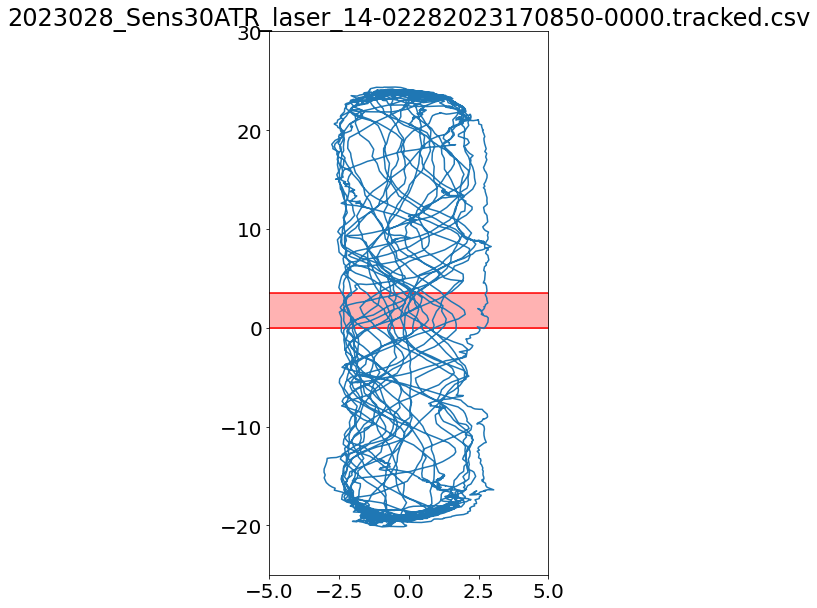

2023028_Sens30ATR_laser_2-02282023160613-0000.tracked.csv
3.04
-3.04


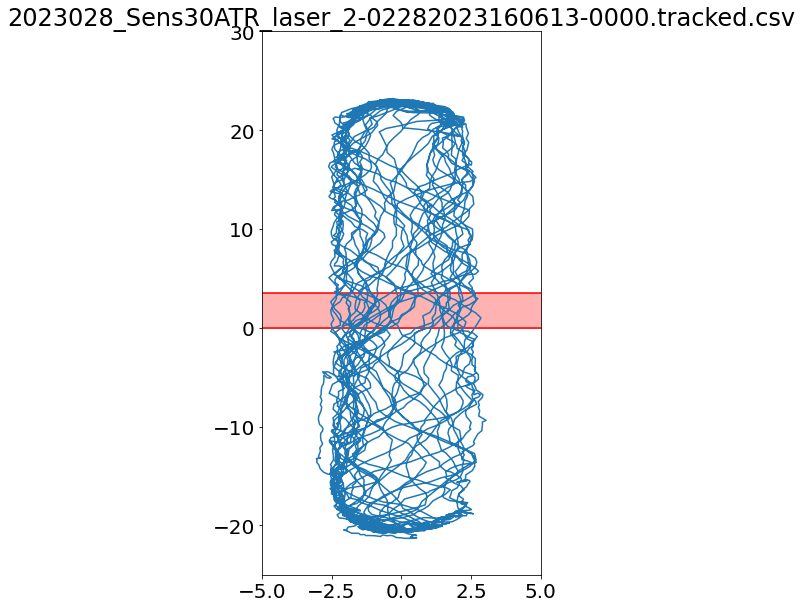

2023028_Sens30ATR_laser_3-02282023161014-0000.tracked.csv
3.04
-3.0400000000000005


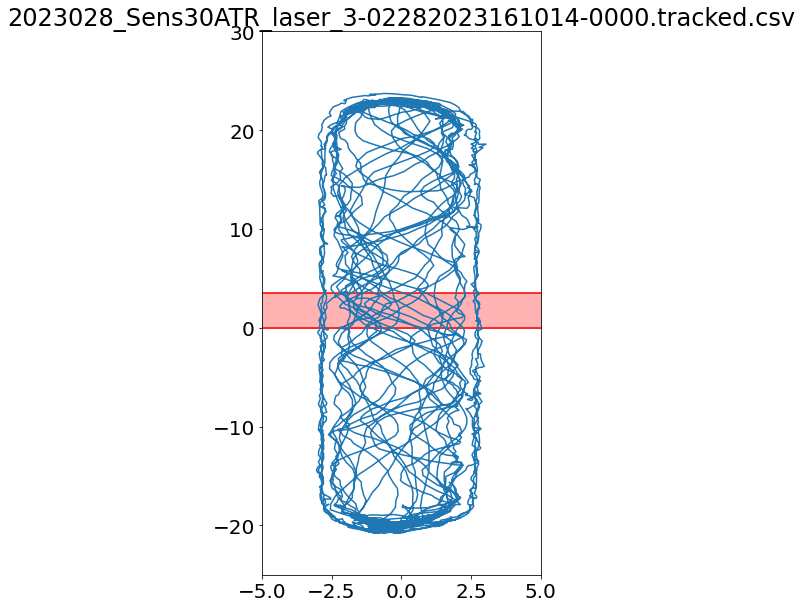

2023028_Sens30ATR_laser_4-02282023161432-0000.tracked.csv
3.039999999999999
-3.04


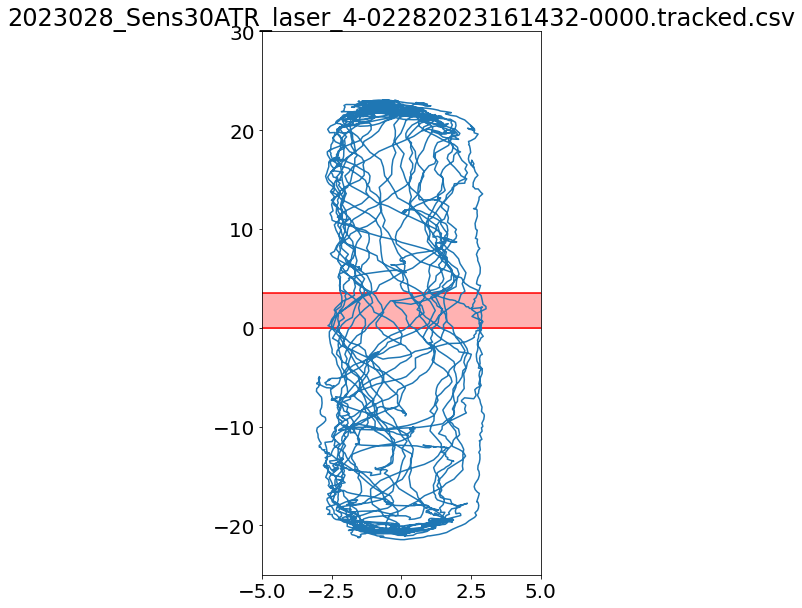

2023028_Sens30ATR_laser_5-02282023161937-0000.tracked.csv
3.04
-3.04


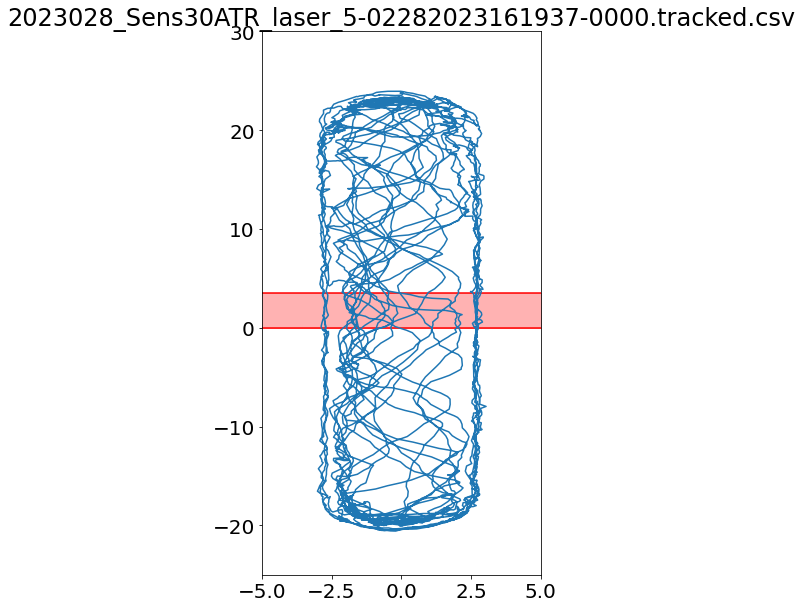

2023028_Sens30ATR_laser_6-02282023162350-0000.tracked.csv
3.039999999999999
-3.04


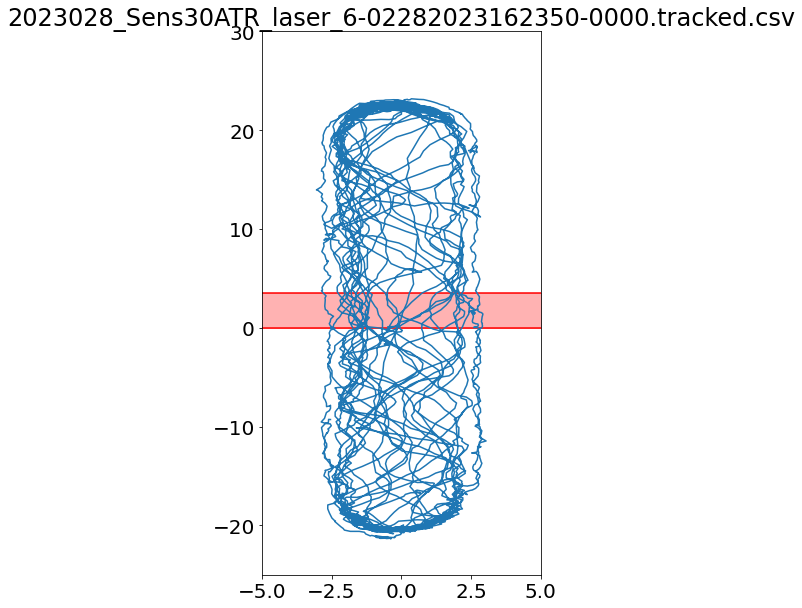

2023028_Sens30ATR_laser_7-02282023162800-0000.tracked.csv
3.040000000000001
-3.04


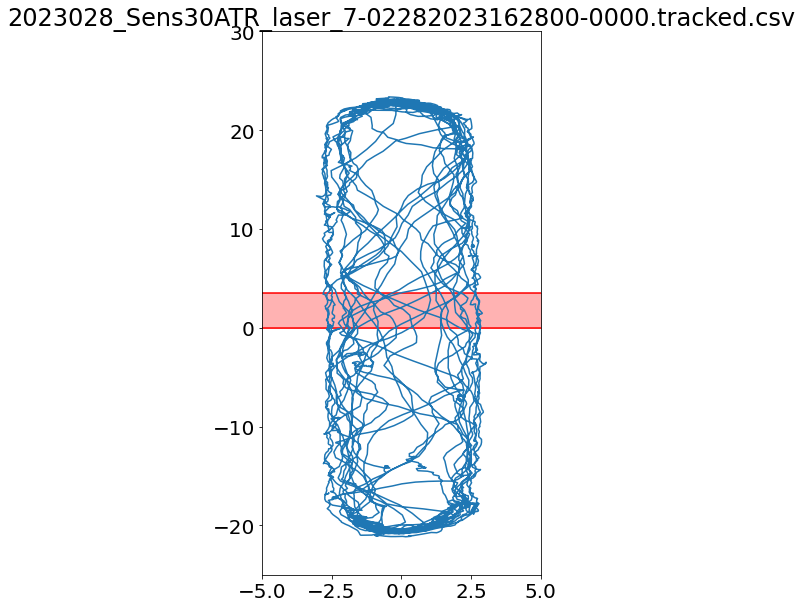

2023028_Sens30ATR_laser_8-02282023163206-0000.tracked.csv
3.04
-3.04


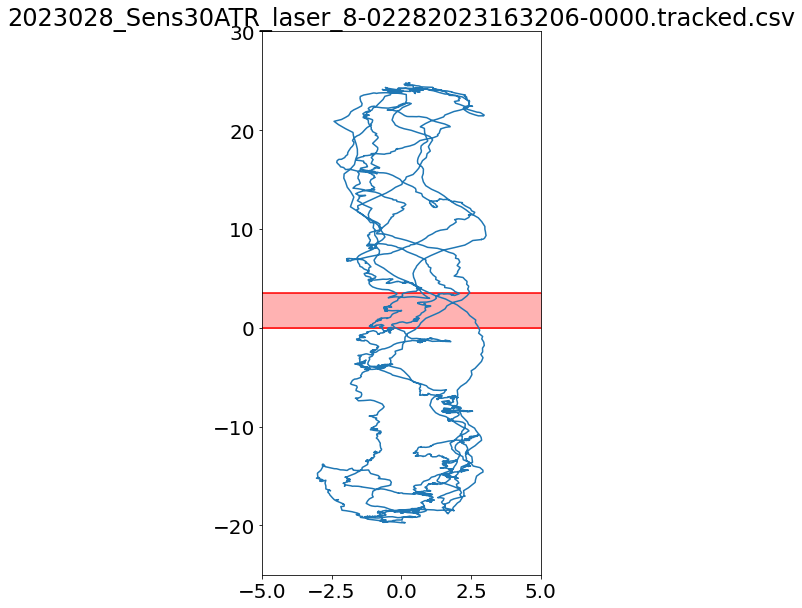

2023028_Sens30ATR_laser_9-02282023163923-0000.tracked.csv
3.040000000000001
-3.04


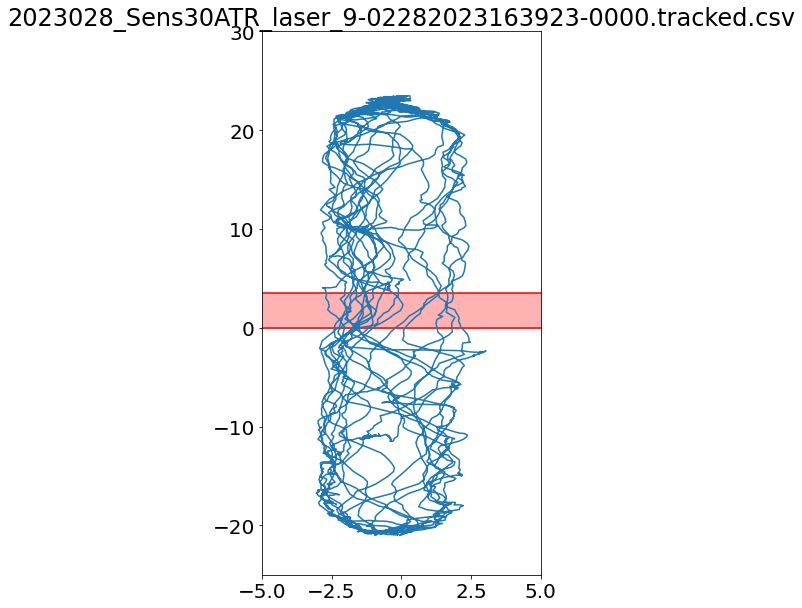

20230223_EmptyGal4_laser_10-03092023181742-0000.tracked.csv
3.04
-3.04


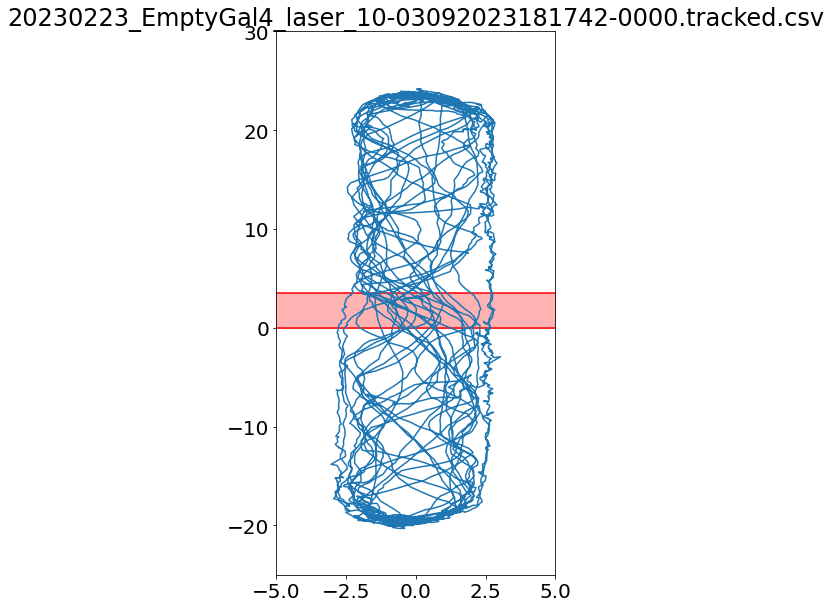

20230223_EmptyGal4_laser_11-03092023182232-0000.tracked.csv
3.040000000000001
-3.04


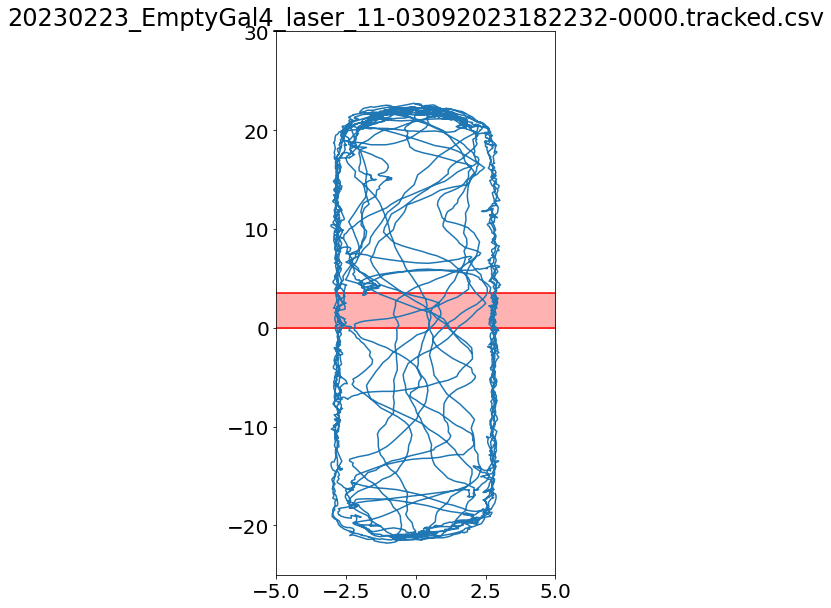

20230223_EmptyGal4_laser_12-03092023182734-0000.tracked.csv
3.040000000000001
-3.0400000000000005


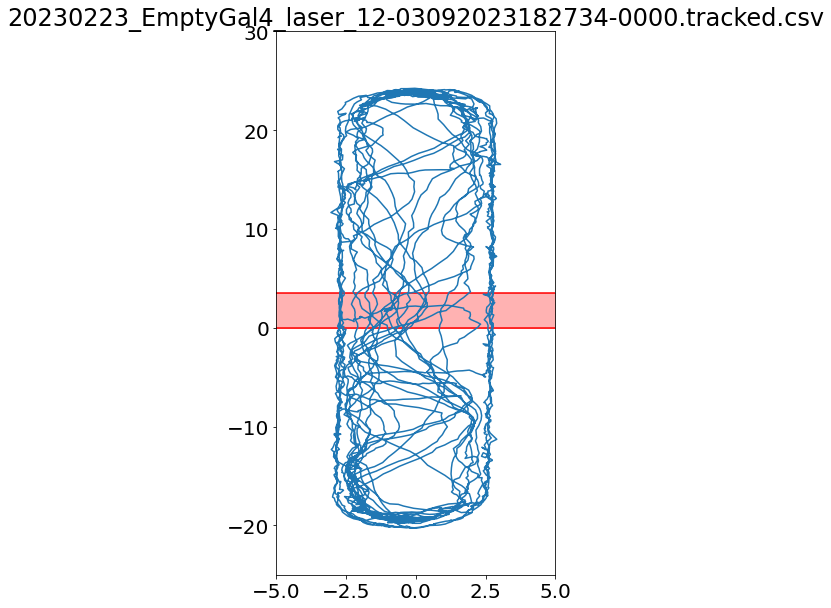

20230223_EmptyGal4_laser_13-03092023183137-0000.tracked.csv
3.039999999999999
-3.0399999999999996


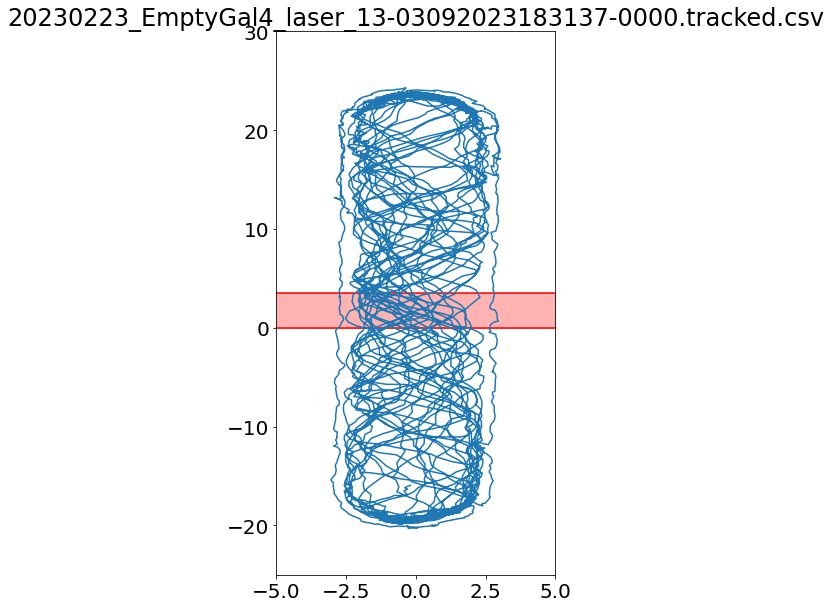

20230223_EmptyGal4_laser_14-03092023183630-0000.tracked.csv
3.04
-3.0399999999999996


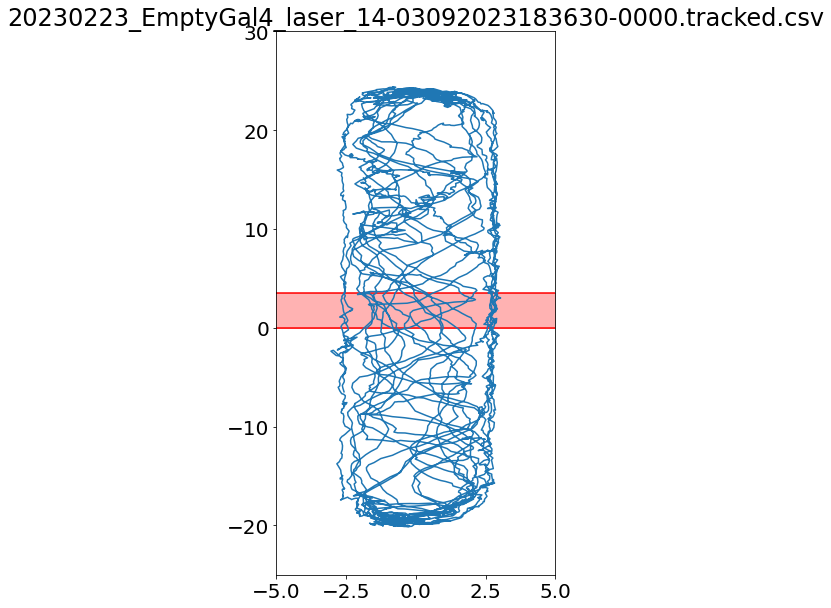

20230223_EmptyGal4_laser_15-03102023144901-0000.tracked.csv
3.040000000000001
-3.04


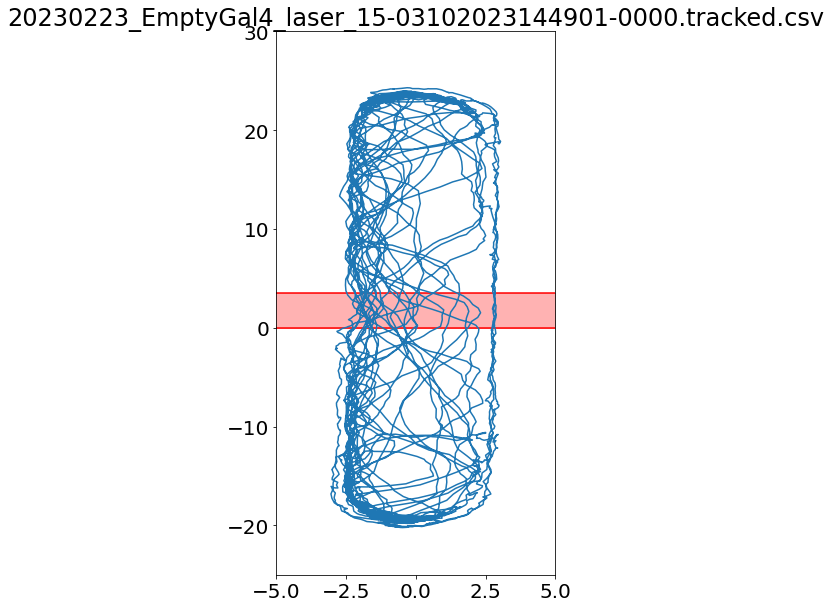

20230223_EmptyGal4_laser_16-03102023145308-0000.tracked.csv
3.04
-3.04


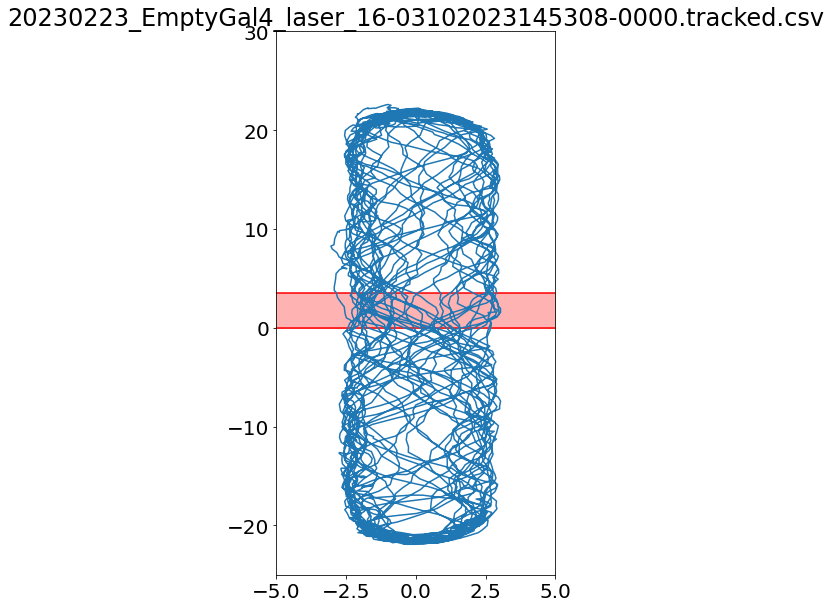

20230223_EmptyGal4_laser_17-03102023145824-0000.tracked.csv
3.040000000000001
-3.04


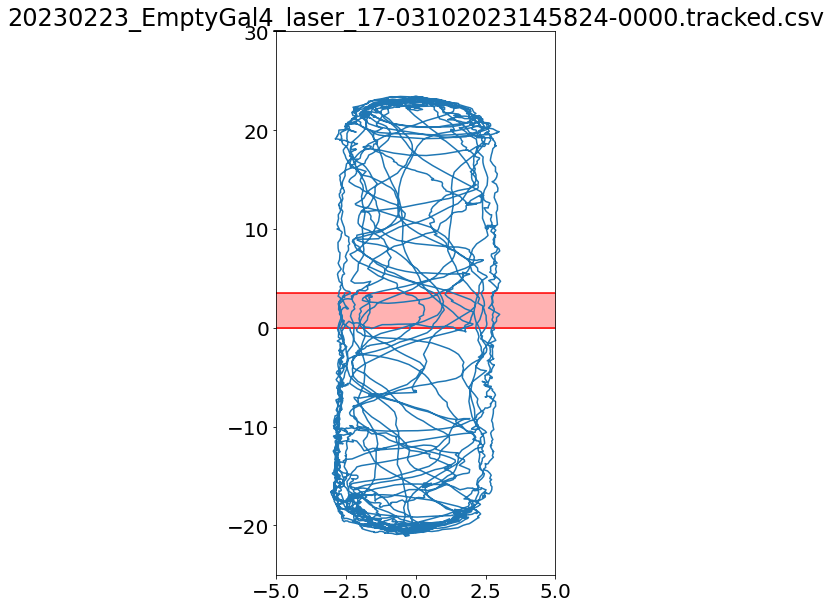

20230223_EmptyGal4_laser_18-03102023150219-0000.tracked.csv
3.04
-3.0399999999999996


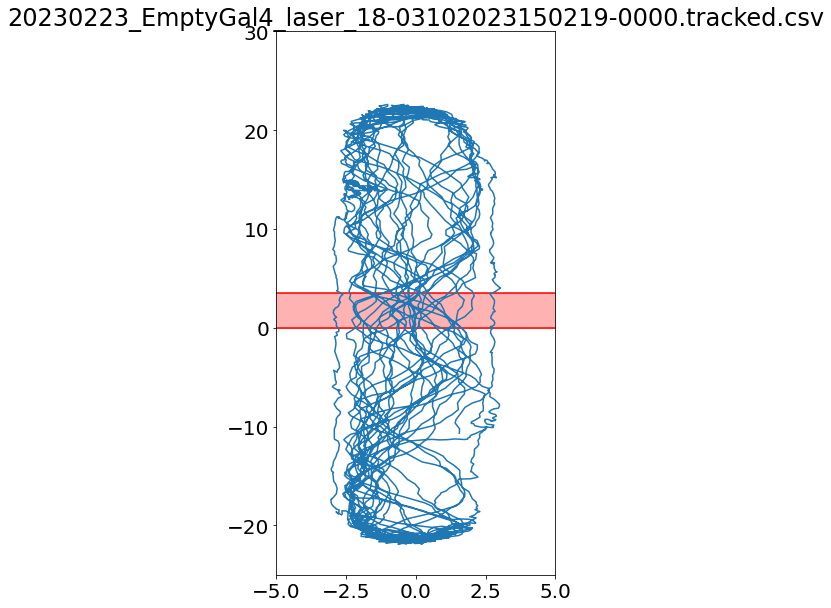

20230223_EmptyGal4_laser_19-03102023150608-0000.tracked.csv
3.04
-3.04


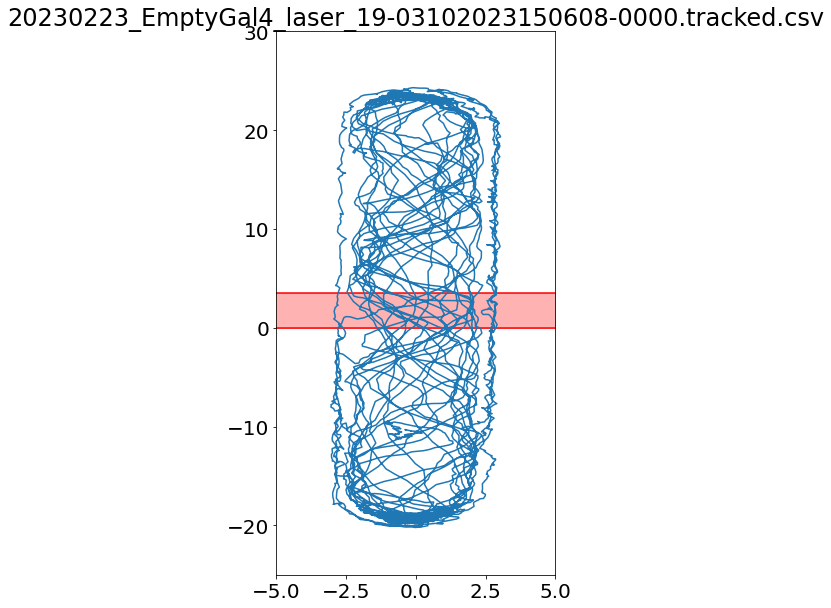

20230223_EmptyGal4_laser_2-03092023174032-0000.tracked.csv
3.039999999999999
-3.04


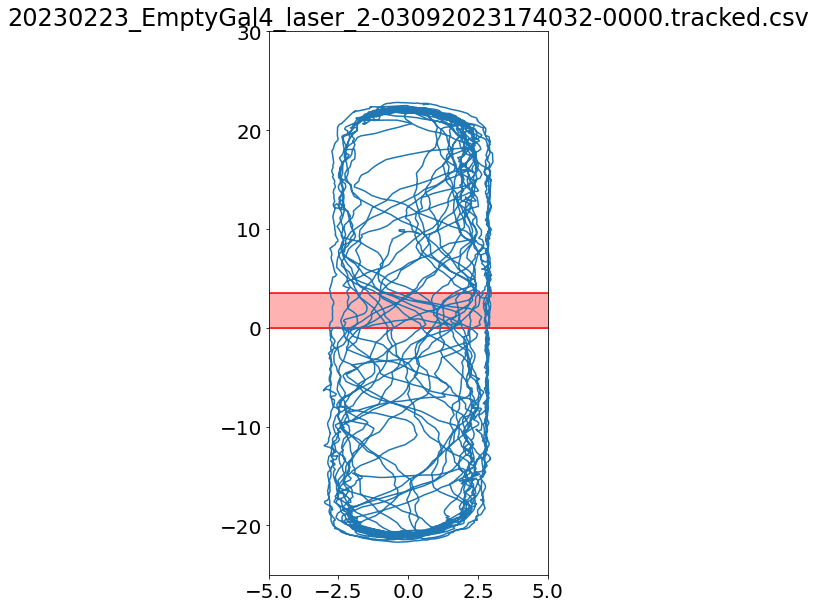

20230223_EmptyGal4_laser_20-03102023151003-0000.tracked.csv
3.040000000000001
-3.04


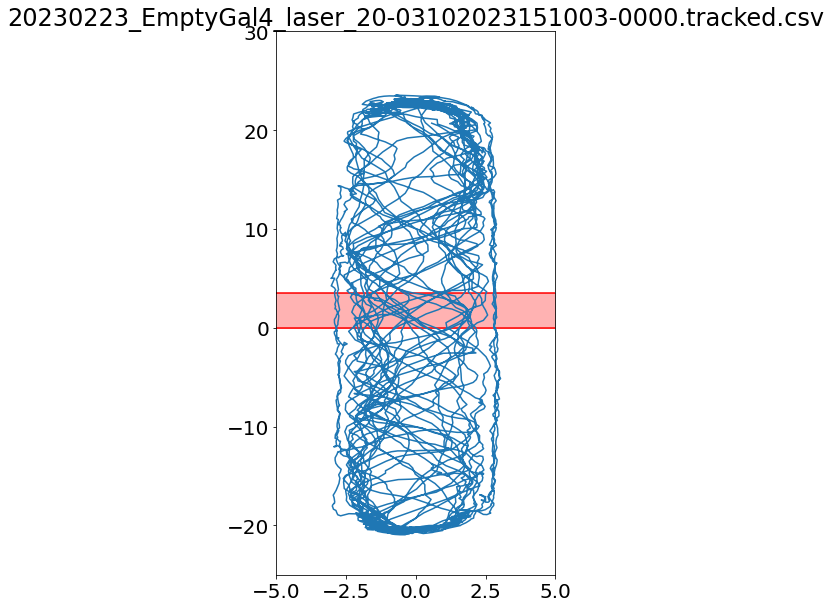

20230223_EmptyGal4_laser_3-03092023174512-0000.tracked.csv
3.04
-3.04


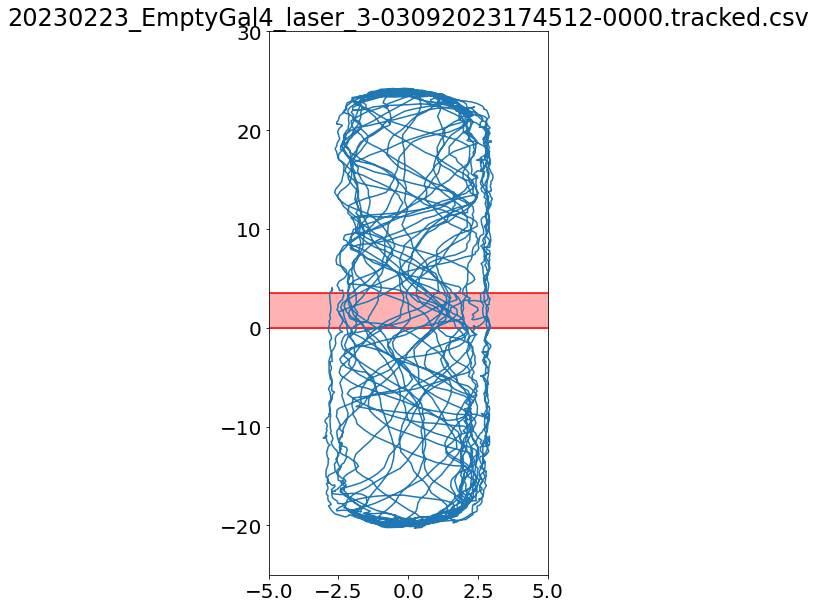

20230223_EmptyGal4_laser_4-03092023174917-0000.tracked.csv
3.04
-3.0399999999999996


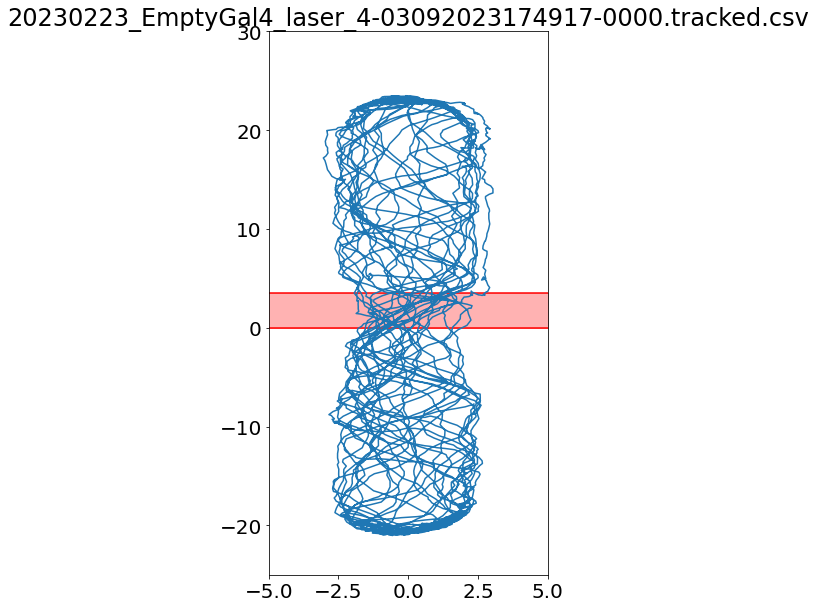

20230223_EmptyGal4_laser_5-03092023175420-0000.tracked.csv
3.040000000000001
-3.04


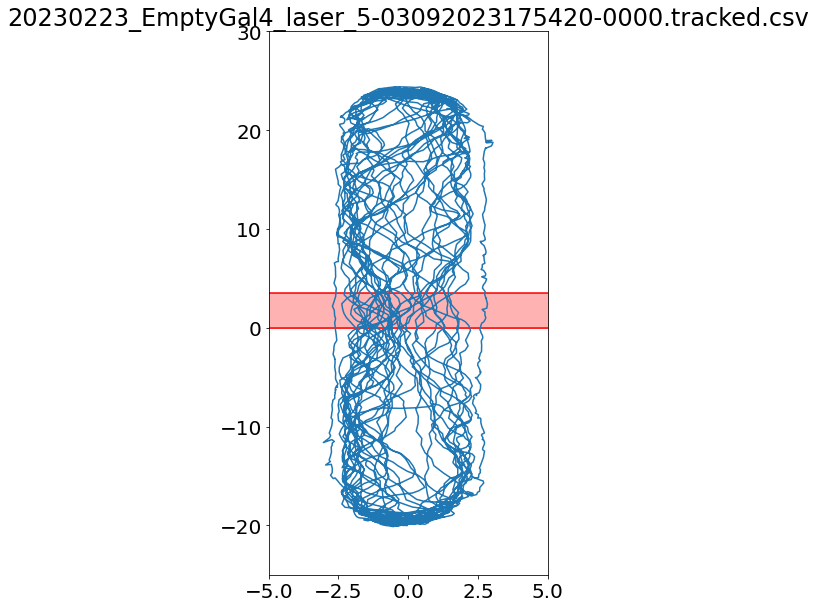

20230223_EmptyGal4_laser_6-03092023180122-0000.tracked.csv
3.039999999999999
-3.04


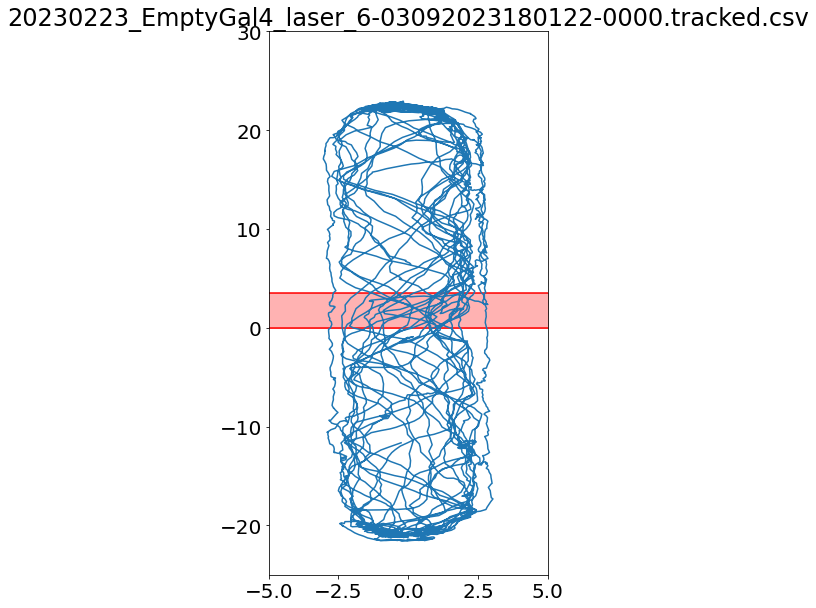

20230223_EmptyGal4_laser_7-03092023180527-0000.tracked.csv
3.040000000000001
-3.040000000000001


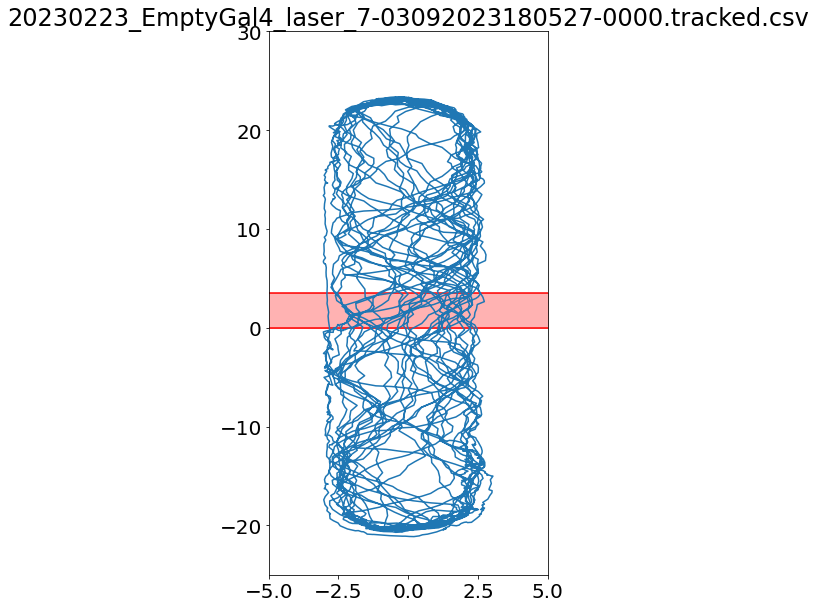

20230223_EmptyGal4_laser_8-03092023180927-0000.tracked.csv
3.04
-3.04


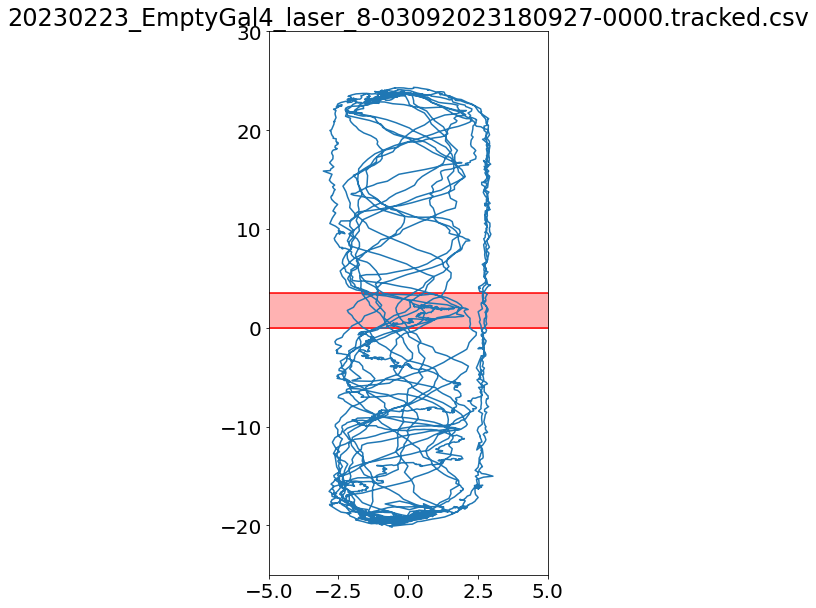

20230223_EmptyGal4_laser_9-03092023181330-0000.tracked.csv
3.04
-3.0400000000000005


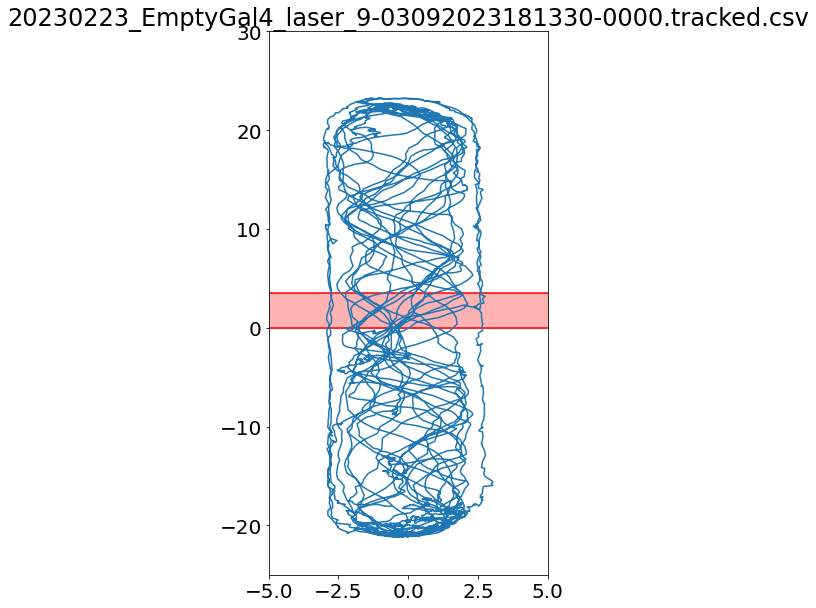

20230223_Sens37ATR_laser_1-02232023155608-0000.tracked.csv
3.04
-3.04


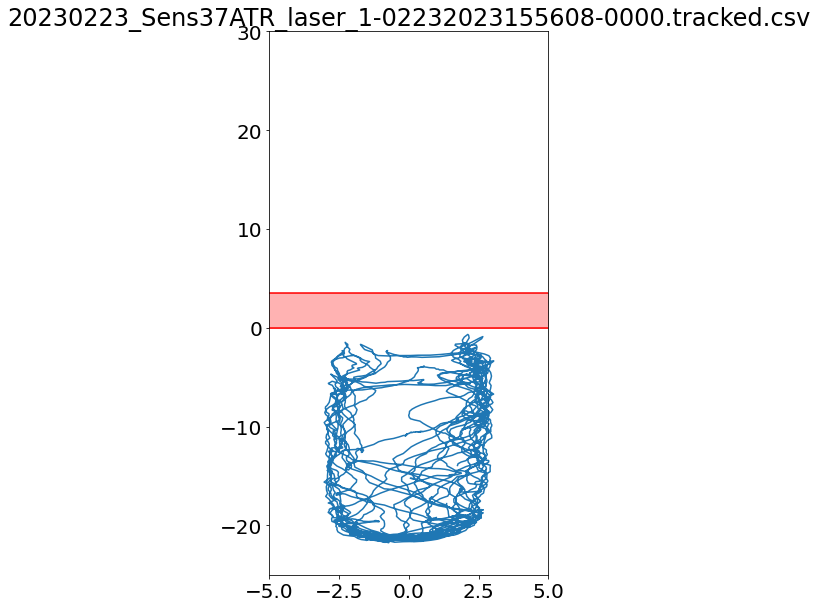

20230223_Sens37ATR_laser_10-02232023164758-0000.tracked.csv
3.040000000000001
-3.04


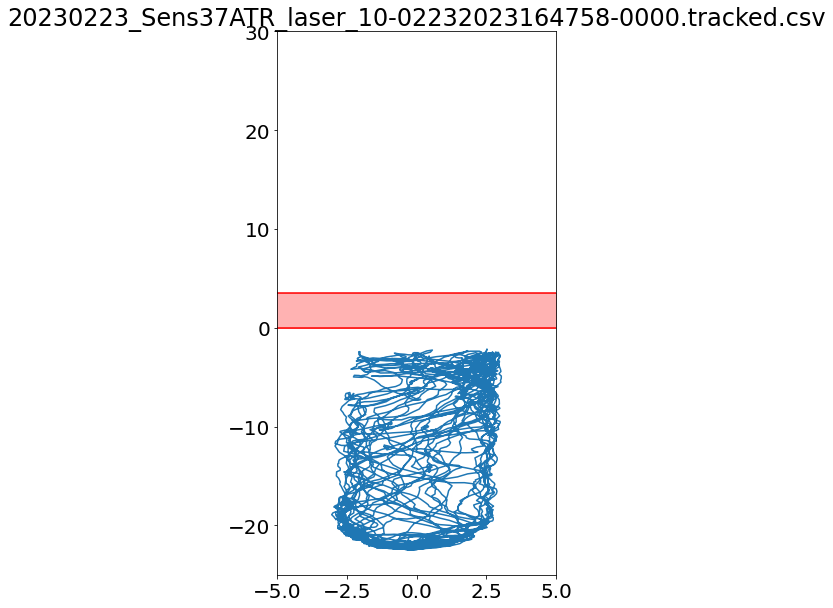

20230223_Sens37ATR_laser_11-02232023165155-0000.tracked.csv
3.039999999999999
-3.04


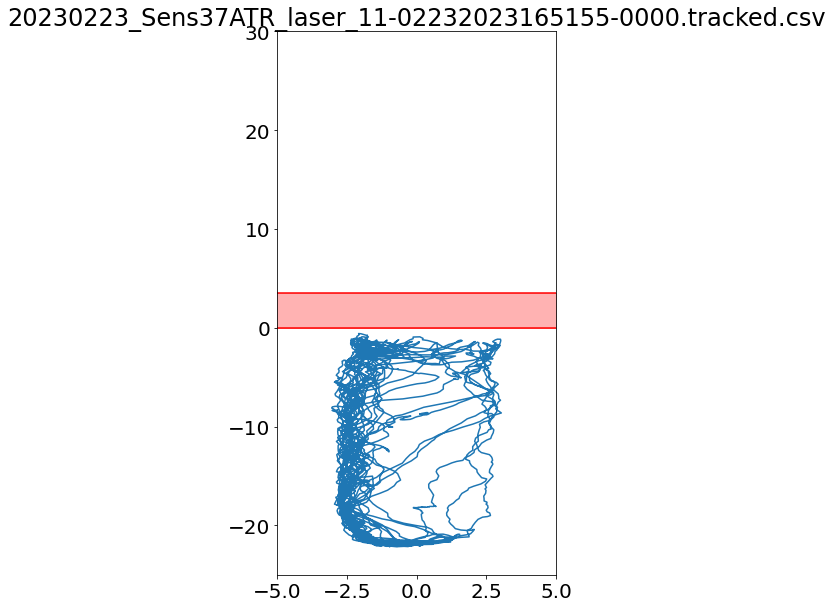

20230223_Sens37ATR_laser_12-02232023165551-0000.tracked.csv
3.040000000000001
-3.04


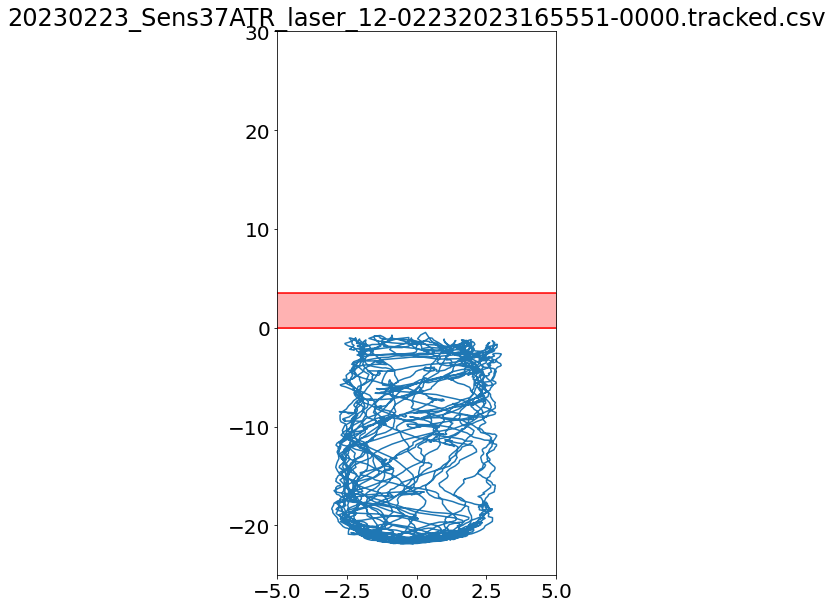

20230223_Sens37ATR_laser_13-02232023165949-0000.tracked.csv
3.04
-3.04


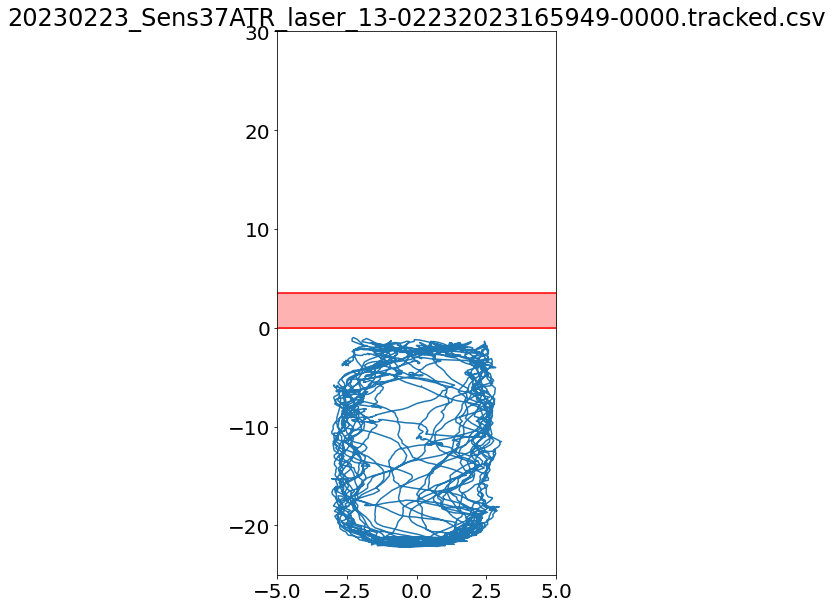

20230223_Sens37ATR_laser_14-02232023170546-0000.tracked.csv
3.04
-3.0400000000000005


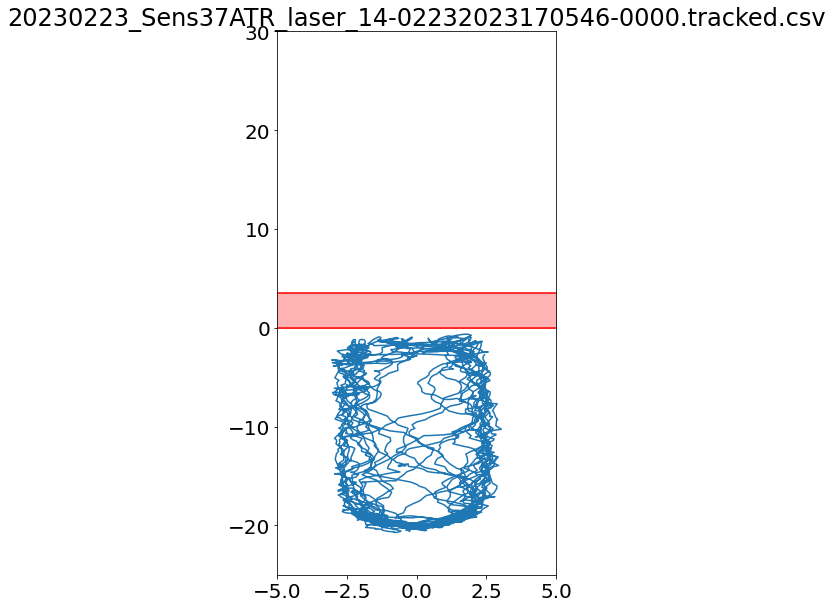

20230223_Sens37ATR_laser_15-02232023170947-0000.tracked.csv
3.039999999999999
-3.04


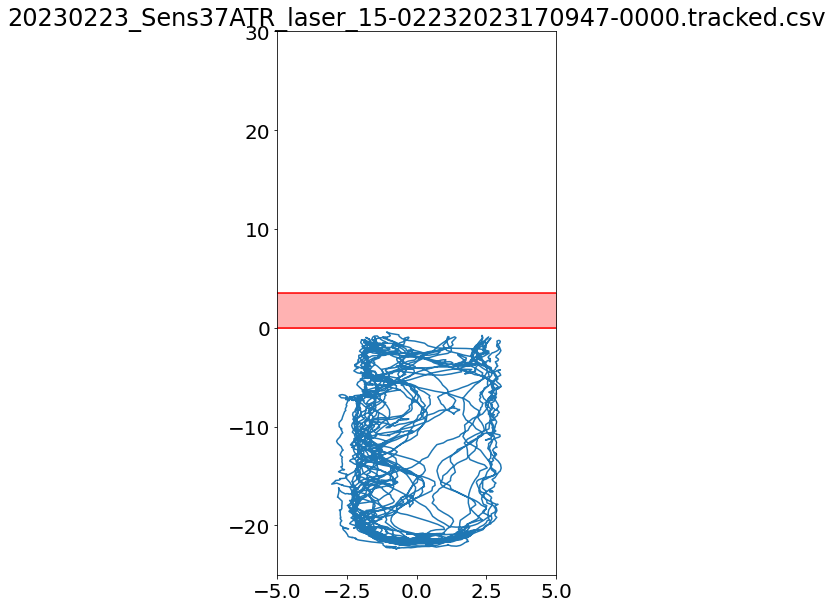

20230223_Sens37ATR_laser_16-02232023171417-0000.tracked.csv
3.040000000000001
-3.04


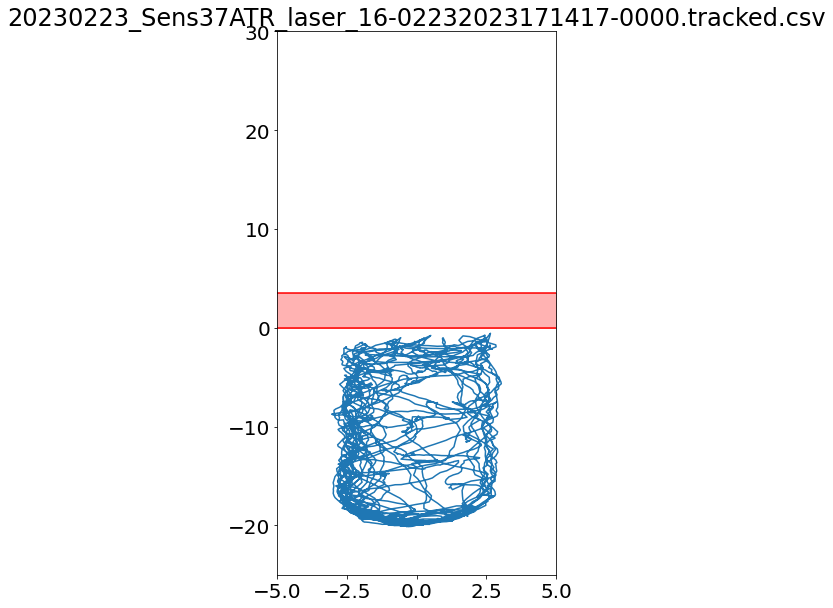

20230223_Sens37ATR_laser_17-03062023140117-0000.tracked.csv
3.04
-3.04


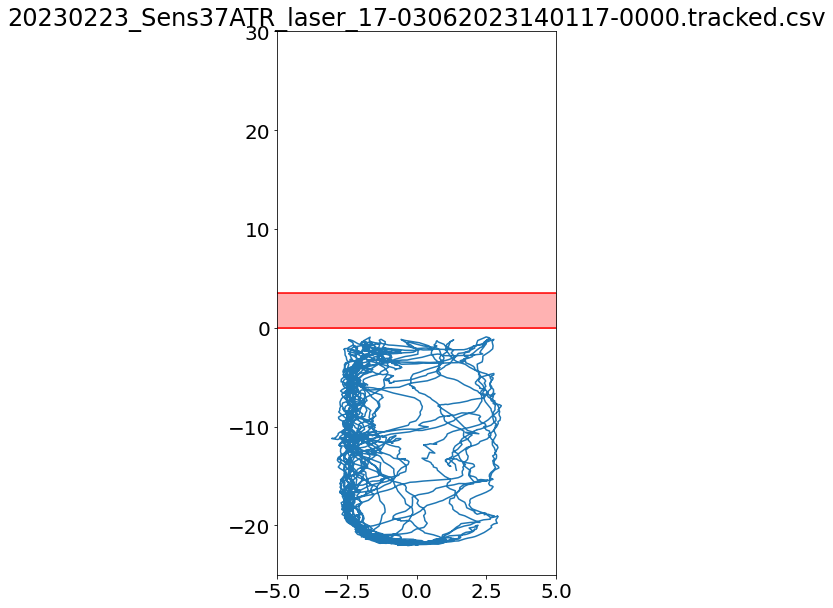

20230223_Sens37ATR_laser_18-03062023140616-0000.tracked.csv
3.04
-3.0400000000000005


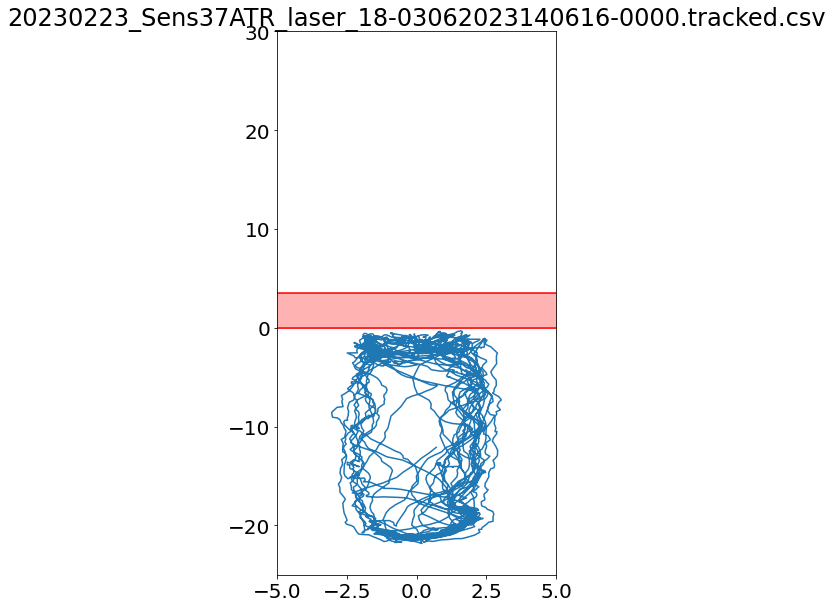

20230223_Sens37ATR_laser_19-03062023141018-0000.tracked.csv
3.04
-3.04


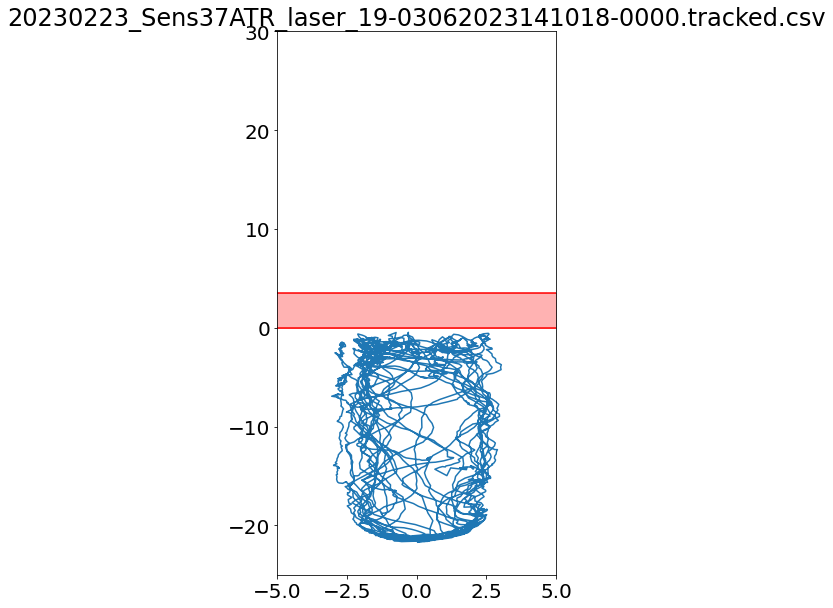

20230223_Sens37ATR_laser_2-02232023160157-0000.tracked.csv
3.040000000000001
-3.04


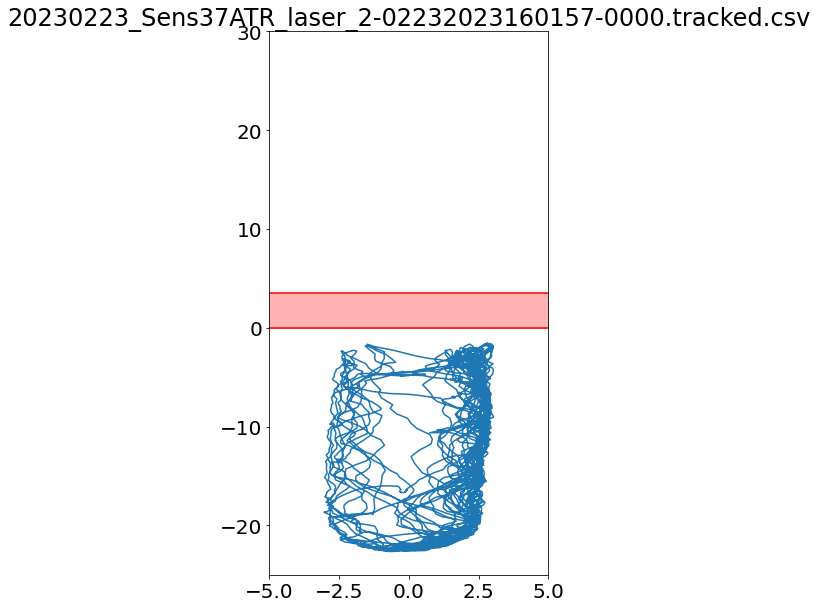

20230223_Sens37ATR_laser_20-03062023141440-0000.tracked.csv
3.039999999999999
-3.04


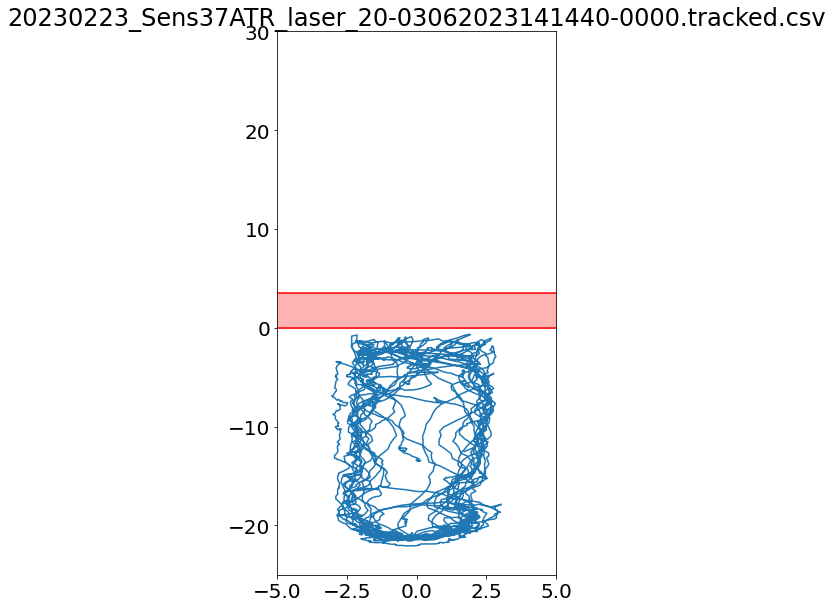

20230223_Sens37ATR_laser_3-02232023160603-0000.tracked.csv
3.039999999999999
-3.04


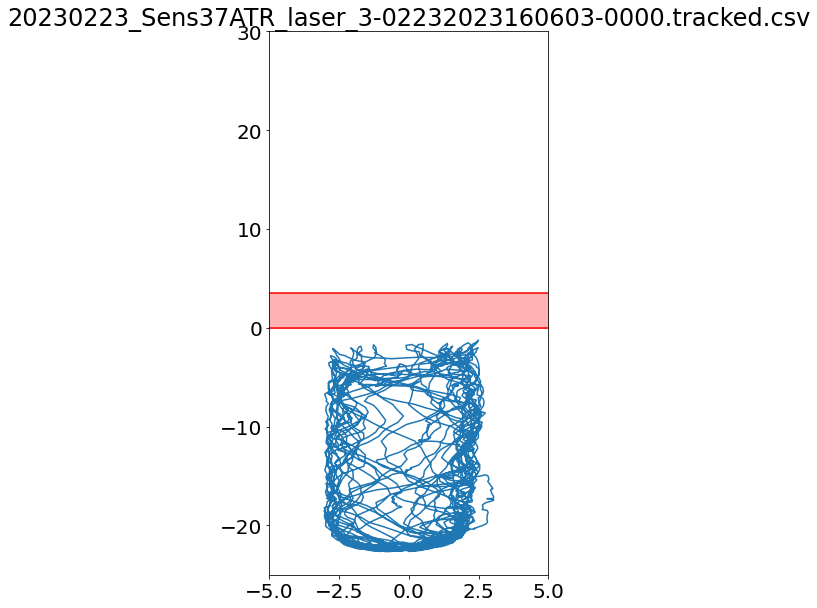

20230223_Sens37ATR_laser_4-02232023161046-0000.tracked.csv
3.040000000000001
-3.04


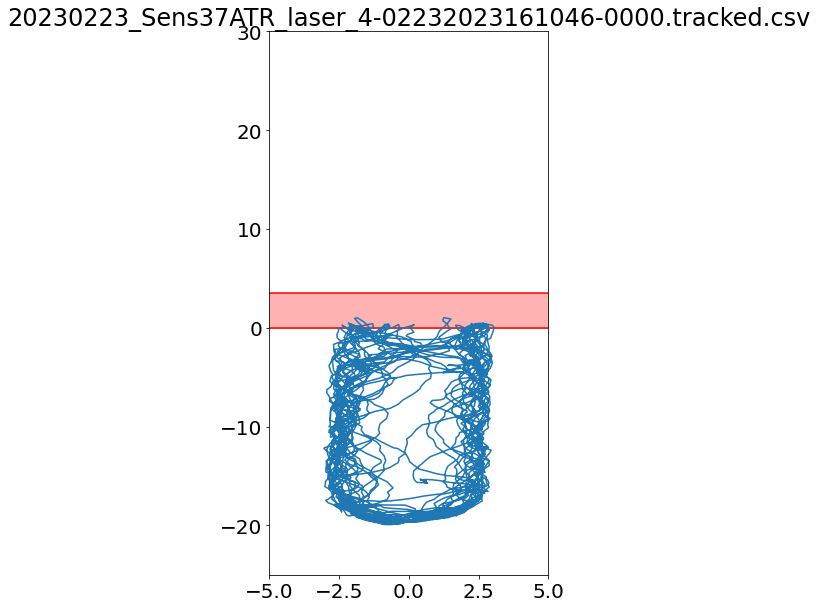

20230223_Sens37ATR_laser_5-02232023161437-0000.tracked.csv
3.04
-3.04


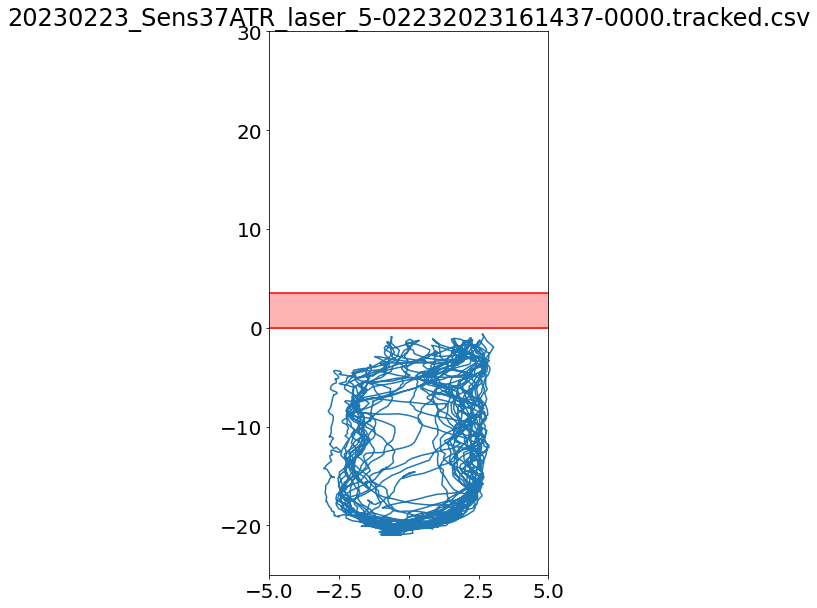

20230223_Sens37ATR_laser_6-02232023162909-0000.tracked.csv
3.04
-3.04


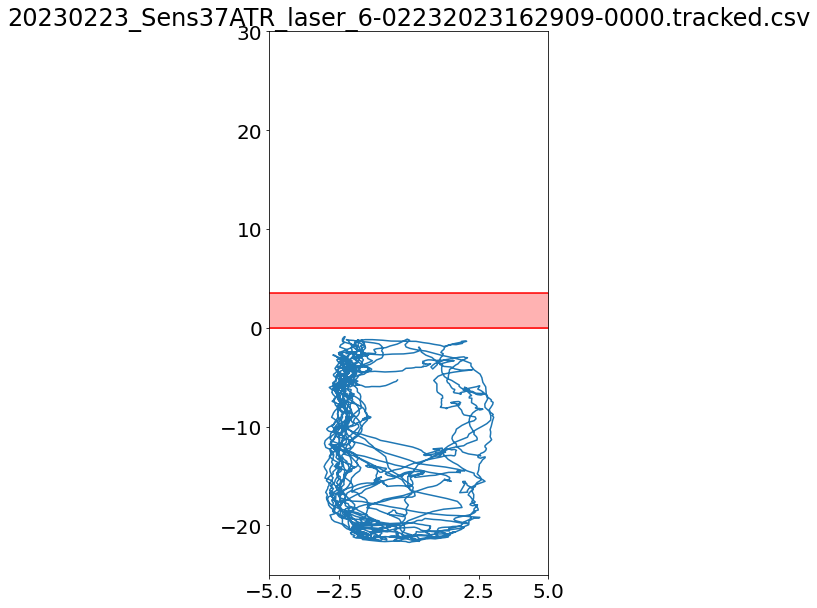

20230223_Sens37ATR_laser_7-02232023163326-0000.tracked.csv
3.04
-3.04


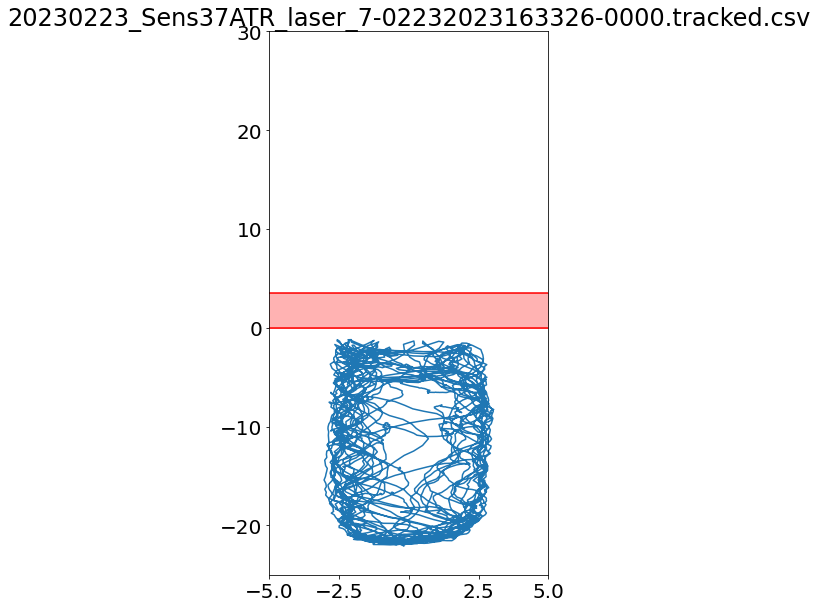

20230223_Sens37ATR_laser_8-02232023163849-0000.tracked.csv
3.04
-3.0400000000000005


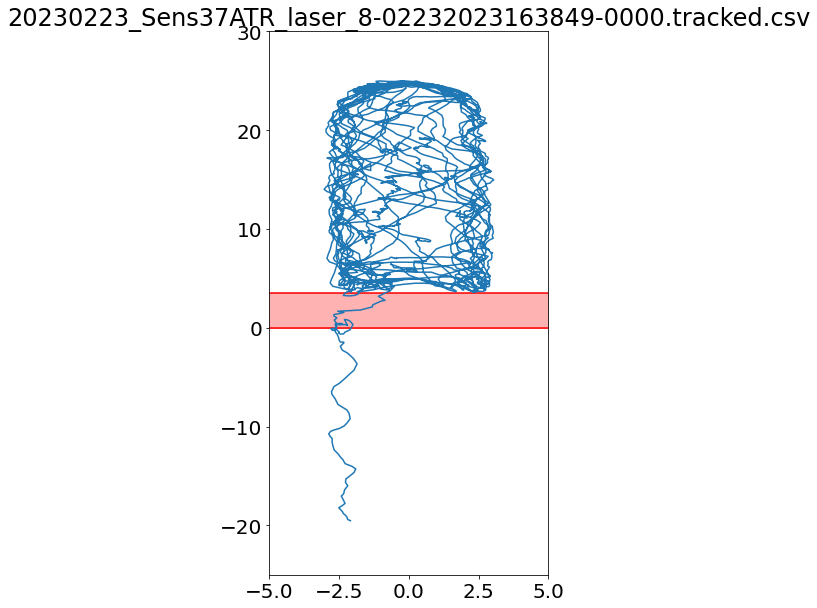

20230223_Sens37ATR_laser_9-02232023164351-0000.tracked.csv
3.039999999999999
-3.04


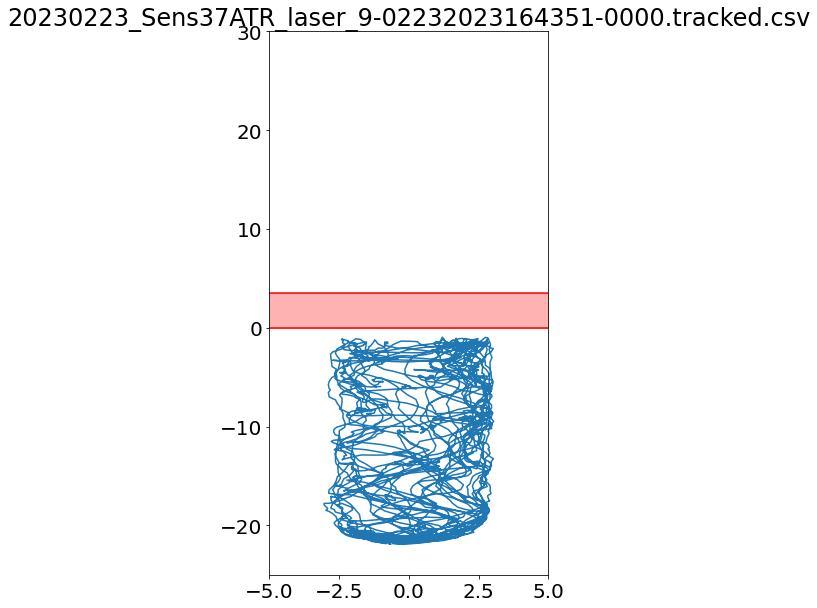

20230725_Sens6_Intact_laserwall_1_corrected-08072023170010-0000-1.tracked.csv
3.04
-3.0400000000000005


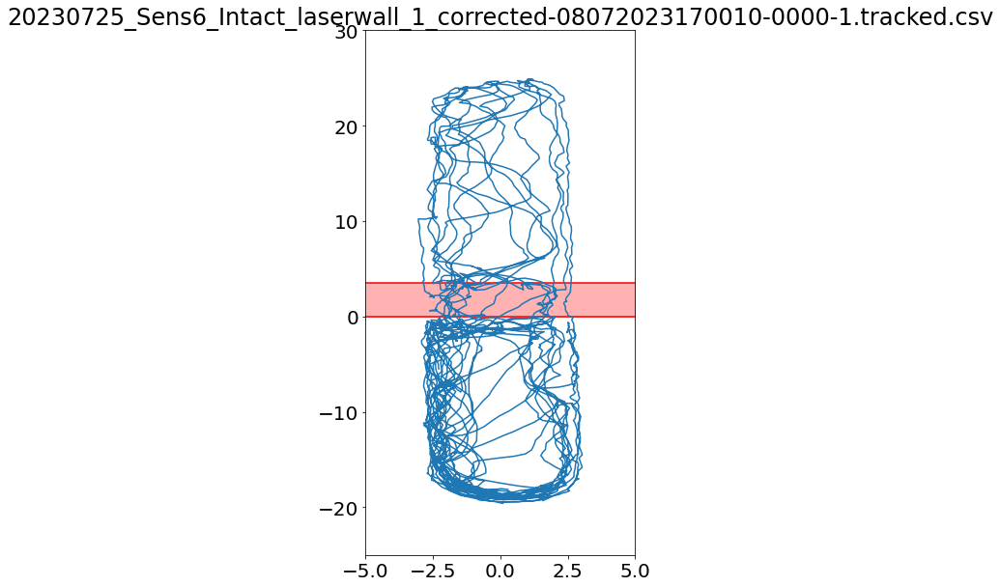

20230725_Sens6_Intact_laserwall_2_corrected-08072023170511-0000-1.tracked.csv
3.040000000000001
-3.04


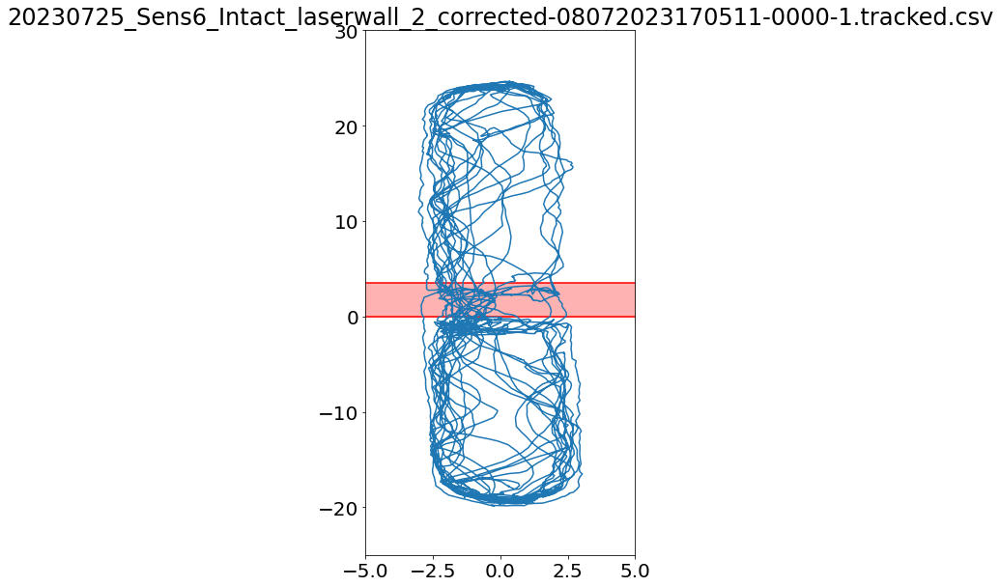

20230725_Sens6_Intact_laserwall_3-08072023171408-0000.tracked.csv
3.04
-3.0399999999999996


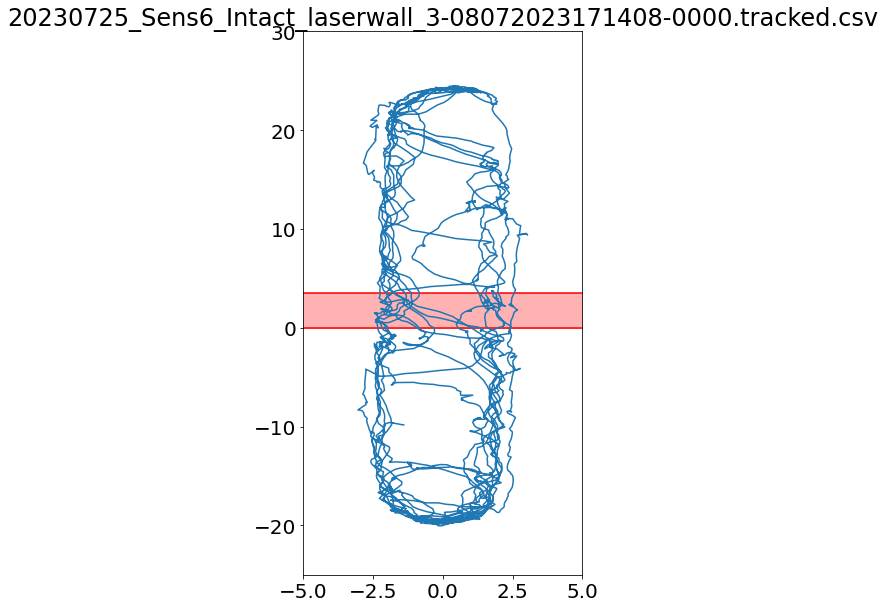

20230725_Sens6_Intact_laserwall_4_Corrected-08072023171845-0000-1.tracked.csv
3.039999999999999
-3.0399999999999996


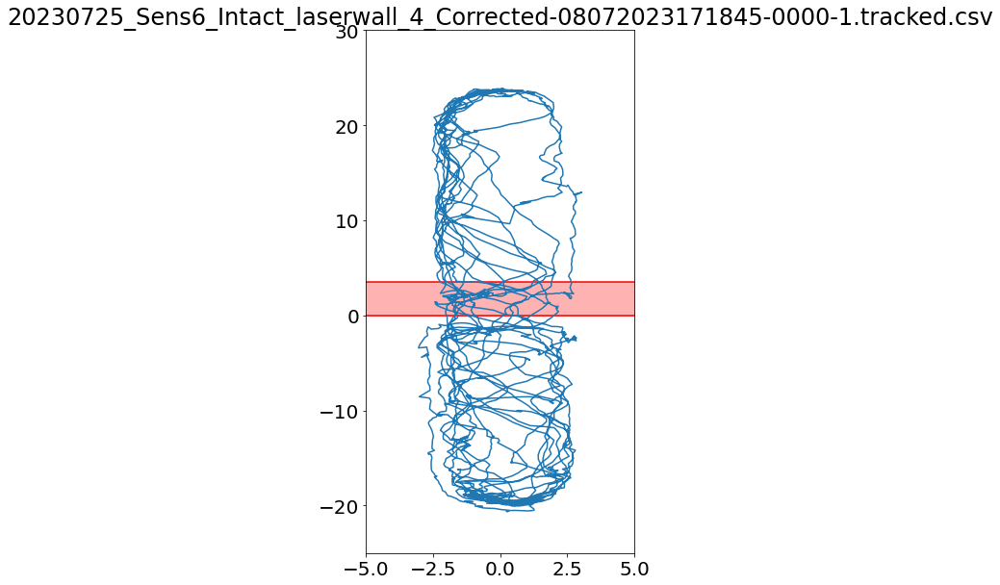

20230810_Sens6_Intact_laserwall_10-08102023175122-0000.tracked.csv
3.040000000000001
-3.04


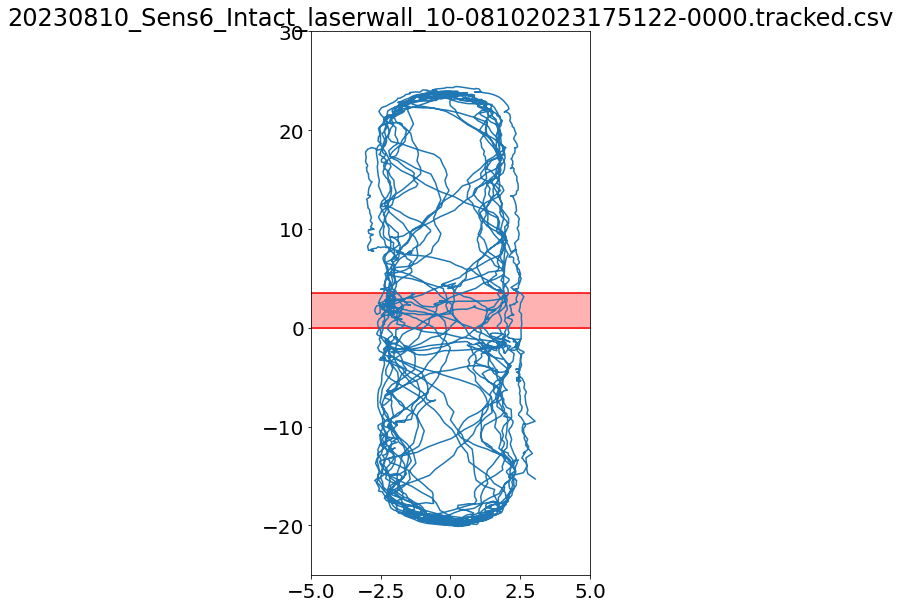

20230810_Sens6_Intact_laserwall_11-08102023175515-0000.tracked.csv
3.04
-3.04


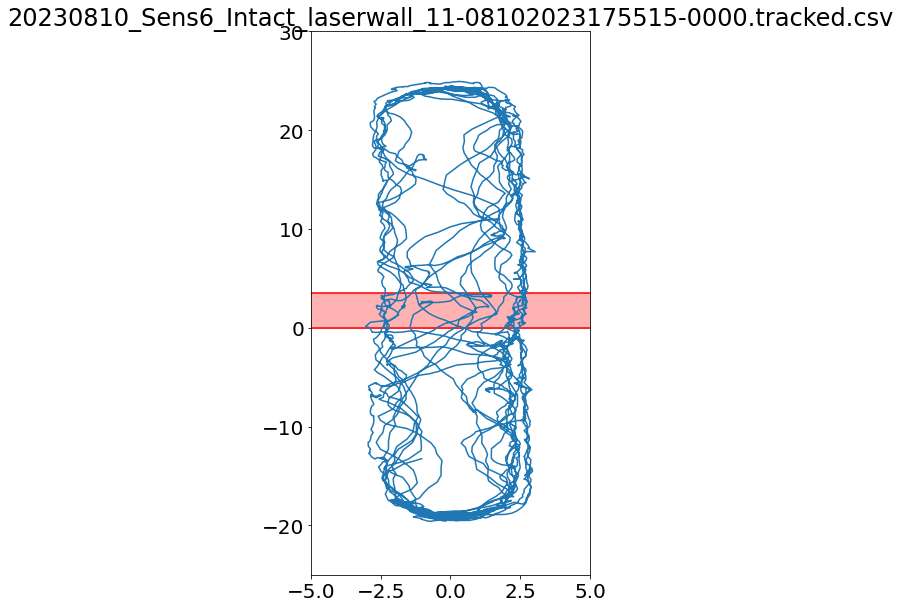

20230810_Sens6_Intact_laserwall_12-08102023180006-0000.tracked.csv
3.04
-3.0399999999999996


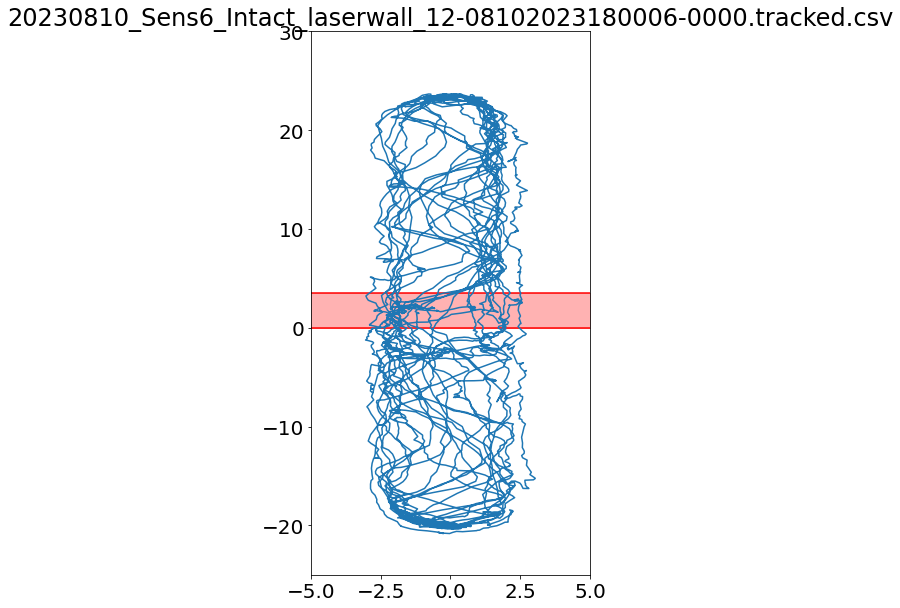

20230810_Sens6_Intact_laserwall_13-08102023180408-0000.tracked.csv
3.04
-3.0399999999999996


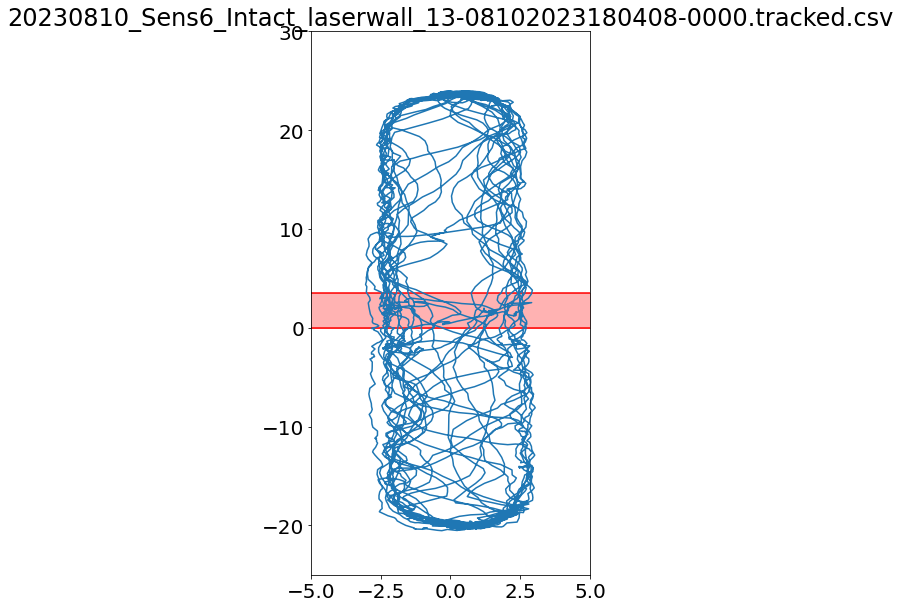

20230810_Sens6_Intact_laserwall_14-08102023180905-0000.tracked.csv
3.04
-3.0399999999999996


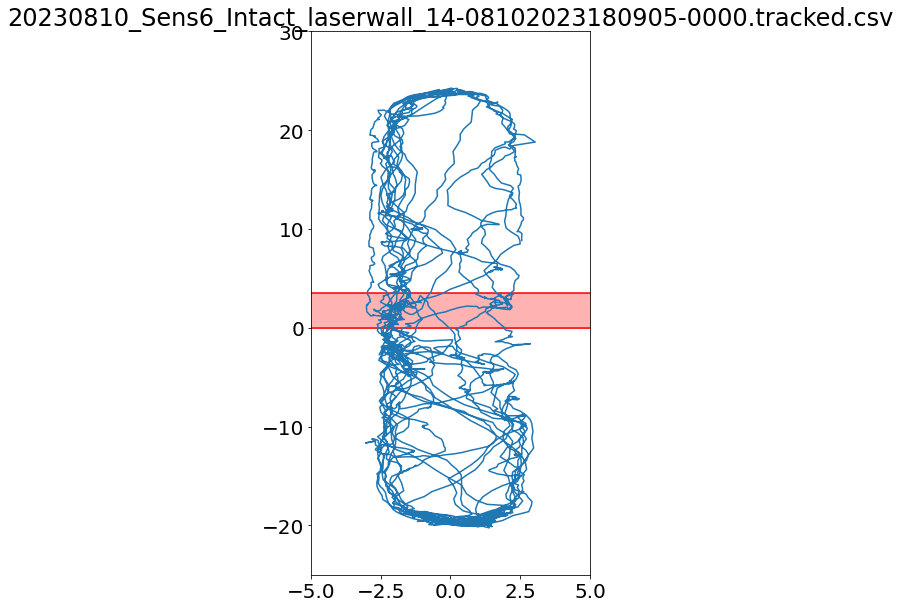

20230810_Sens6_Intact_laserwall_15-08102023181300-0000.tracked.csv
3.04
-3.04


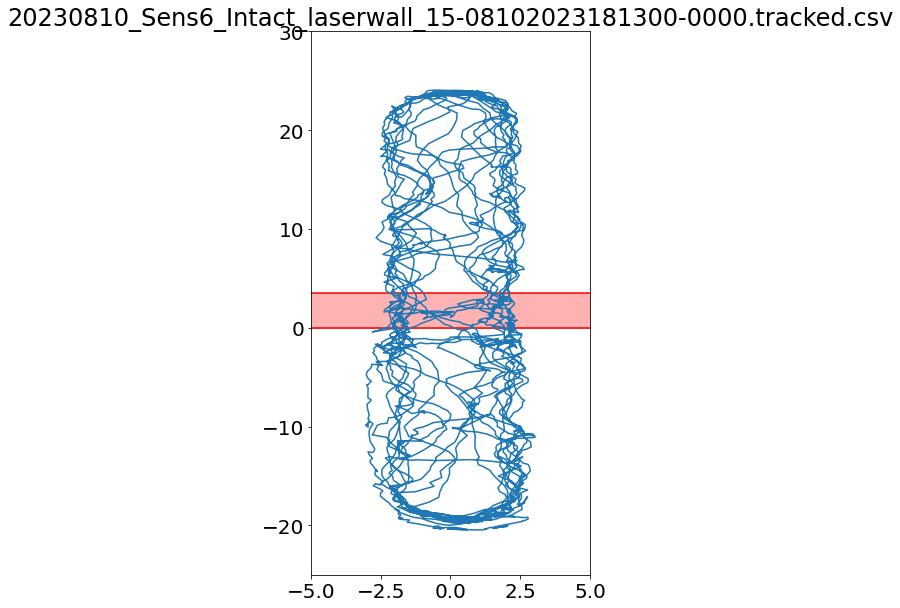

20230810_Sens6_Intact_laserwall_16-08102023181700-0000.tracked.csv
3.04
-3.04


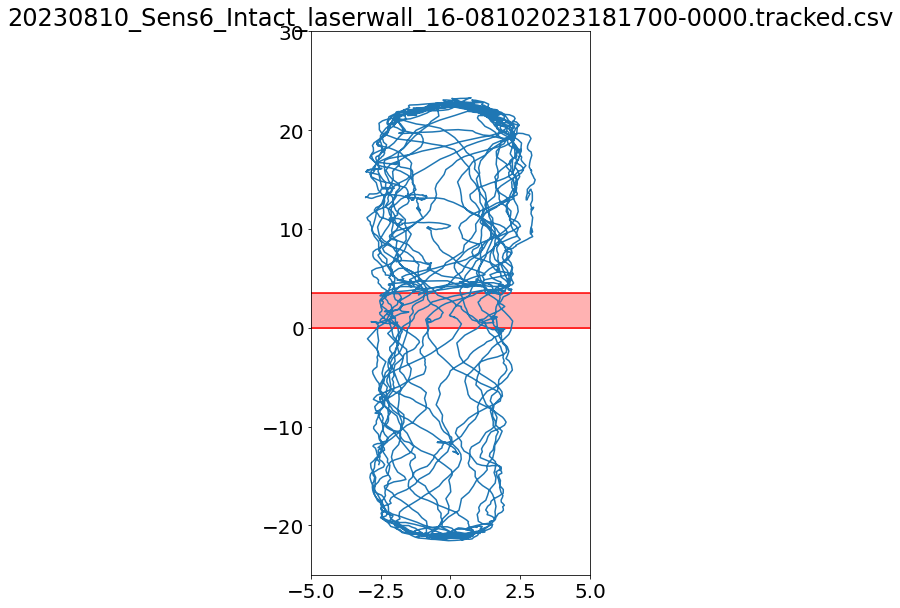

20230810_Sens6_Intact_laserwall_17-08102023182101-0000.tracked.csv
3.04
-3.04


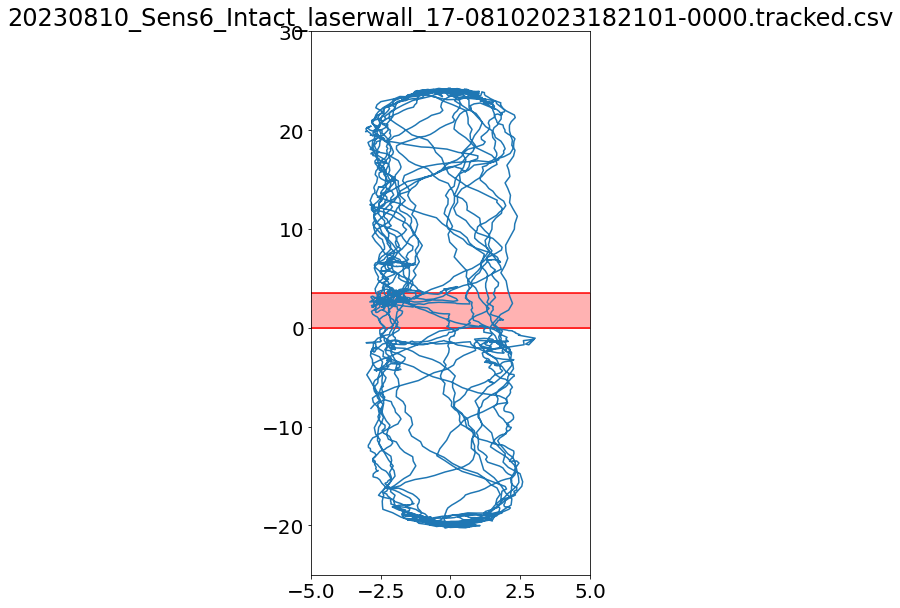

20230810_Sens6_Intact_laserwall_18-08102023182517-0000.tracked.csv
3.04
-3.04


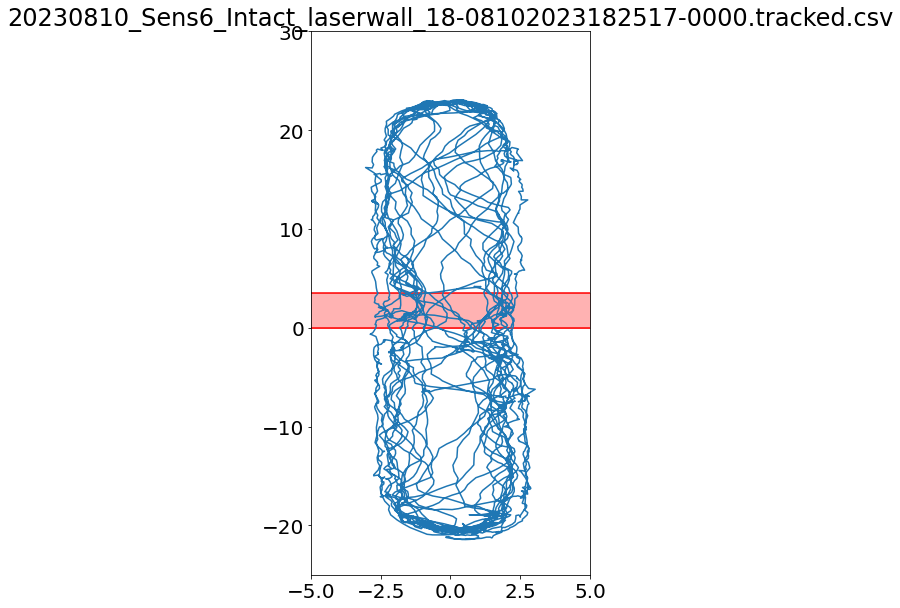

20230810_Sens6_Intact_laserwall_19-08102023182920-0000.tracked.csv
3.04
-3.0400000000000005


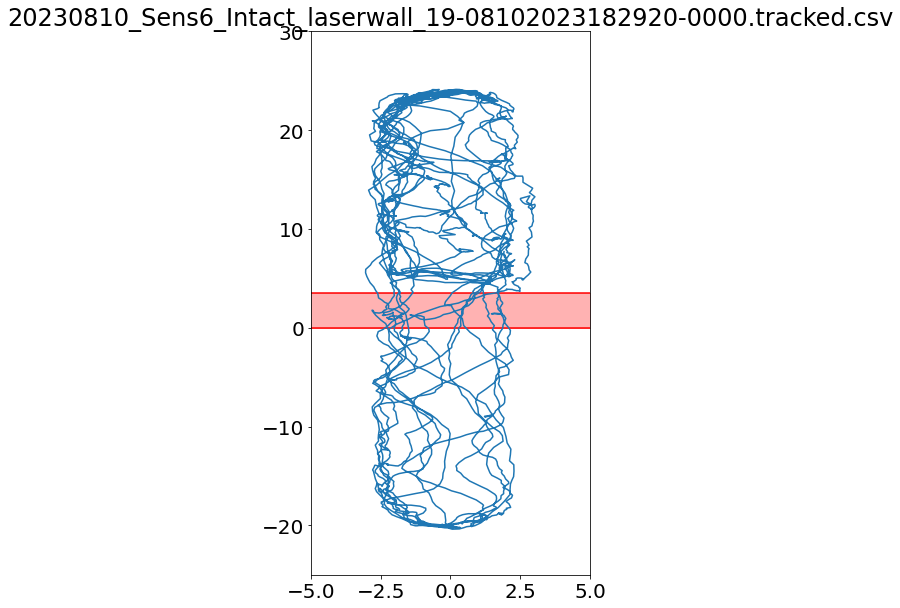

20230810_Sens6_Intact_laserwall_20-08122023124157-0000.tracked.csv
3.04
-3.0400000000000005


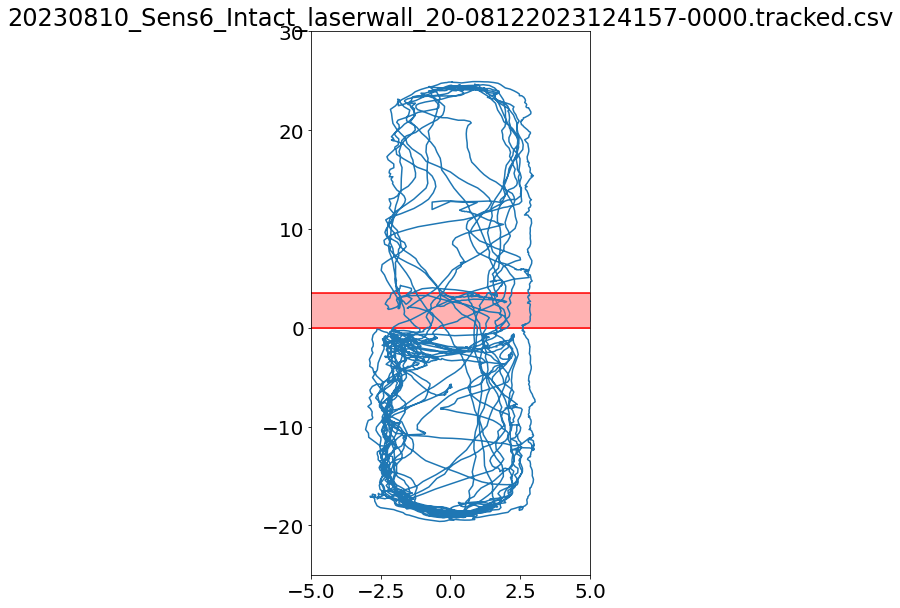

20230810_Sens6_Intact_laserwall_5-08102023172927-0000.tracked.csv
3.040000000000001
-3.04


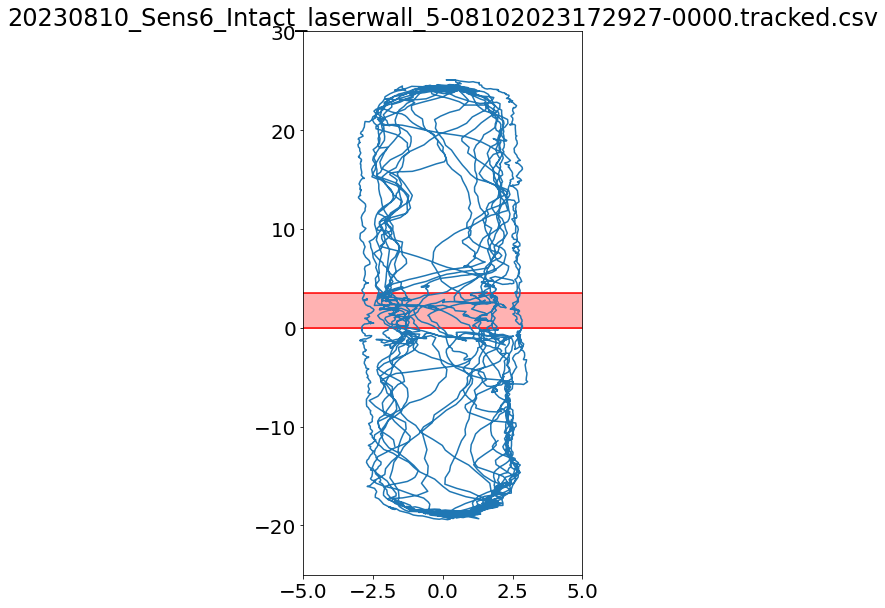

20230810_Sens6_Intact_laserwall_6-08102023173400-0000.tracked.csv
3.04
-3.04


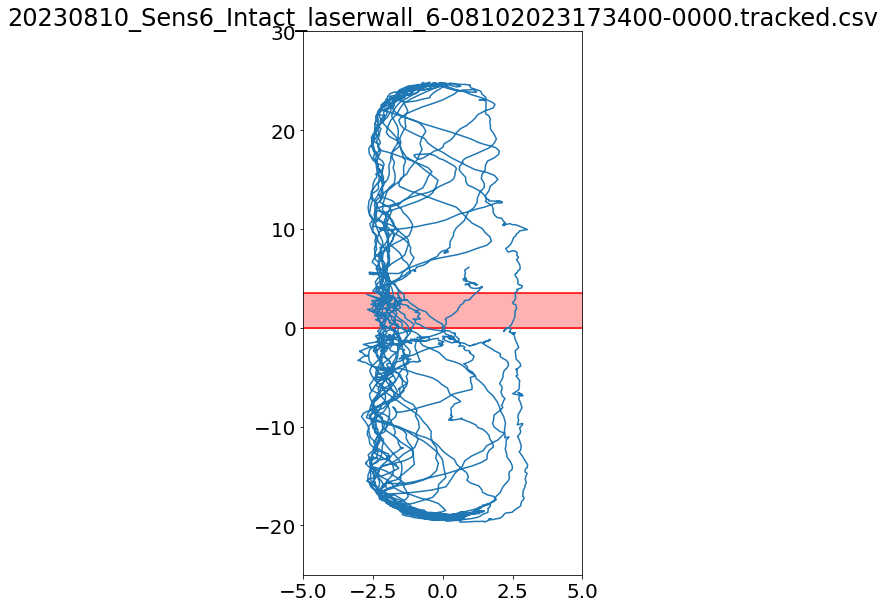

20230810_Sens6_Intact_laserwall_7-08102023173822-0000.tracked.csv
3.04
-3.04


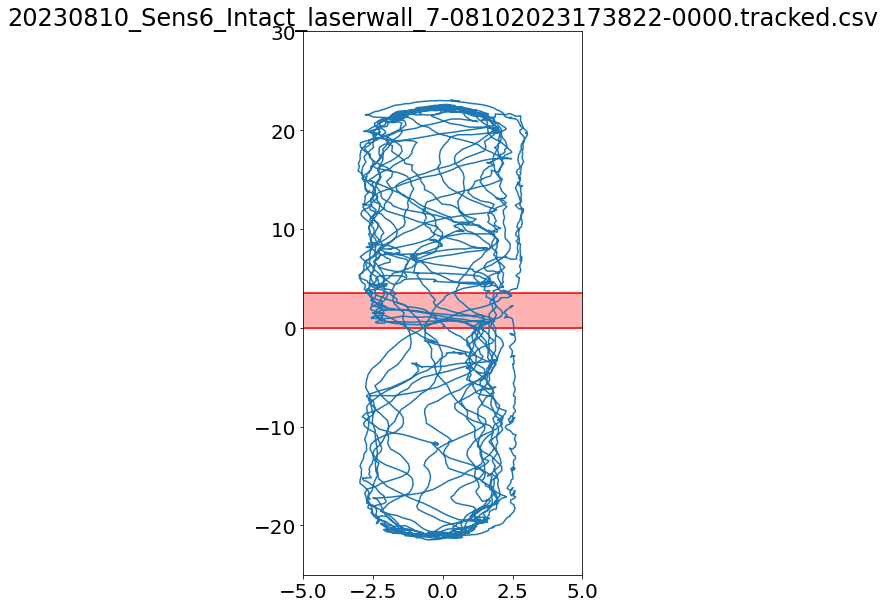

20230810_Sens6_Intact_laserwall_8-08102023174216-0000.tracked.csv
3.04
-3.0399999999999996


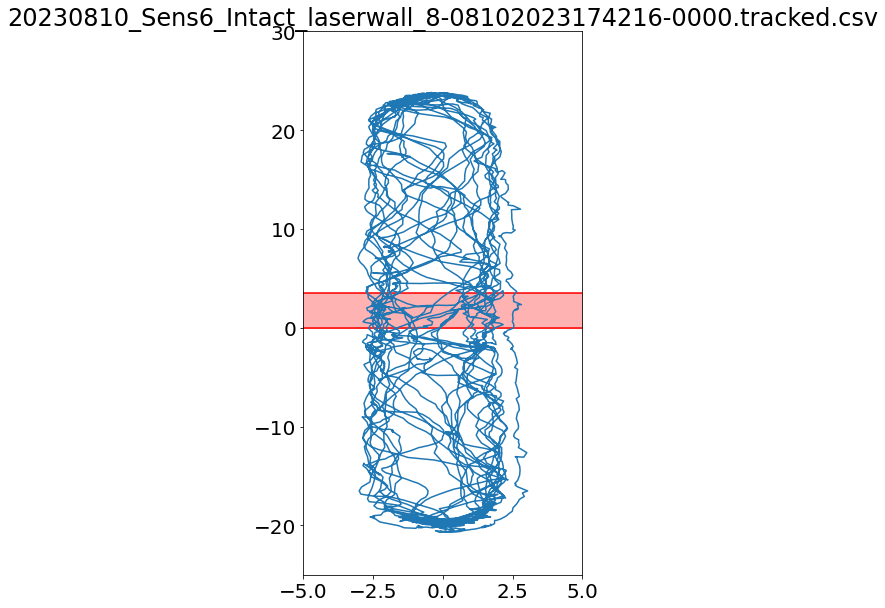

20230810_Sens6_Intact_laserwall_9-08102023174633-0000.tracked.csv
3.039999999999999
-3.04


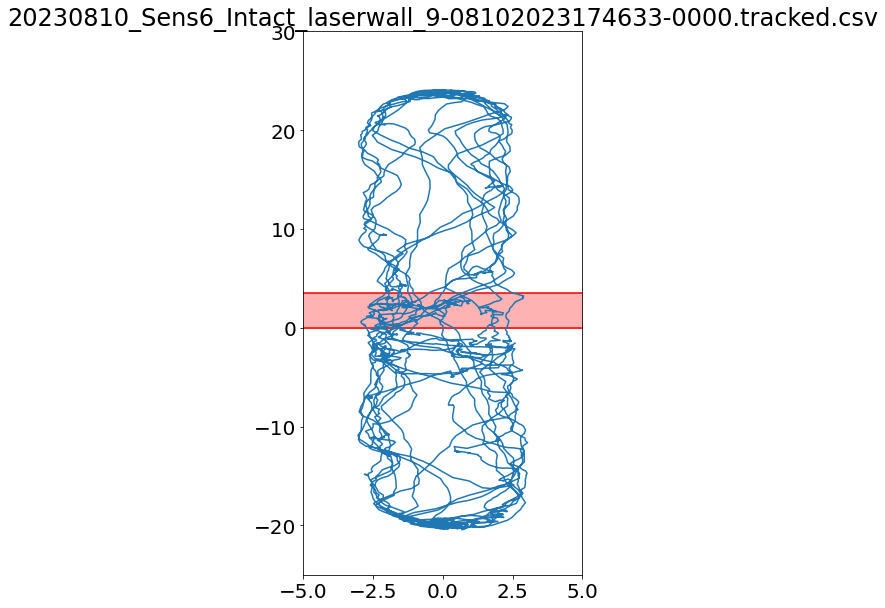

20230801_Sens36_Intact_laserwall_10-08122023122040-0000.tracked.csv
3.040000000000001
-3.04


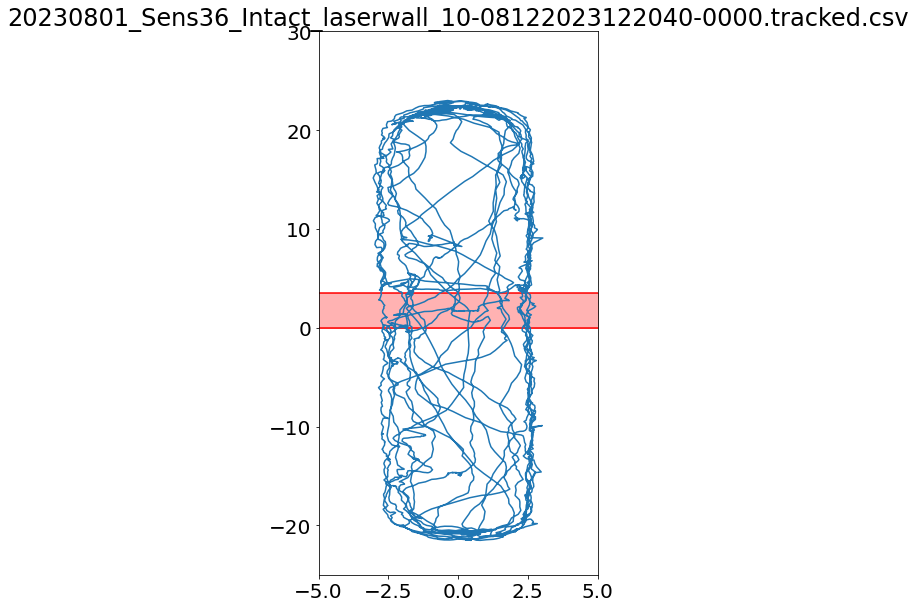

20230801_Sens36_Intact_laserwall_11-08122023122441-0000.tracked.csv
3.04
-3.04


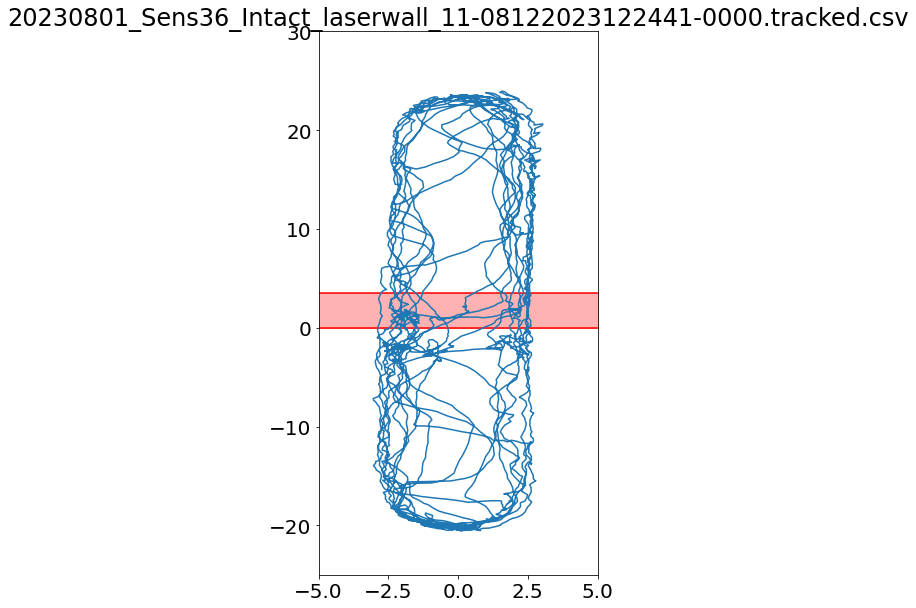

20230801_Sens36_Intact_laserwall_12-08122023122841-0000.tracked.csv
3.04
-3.04


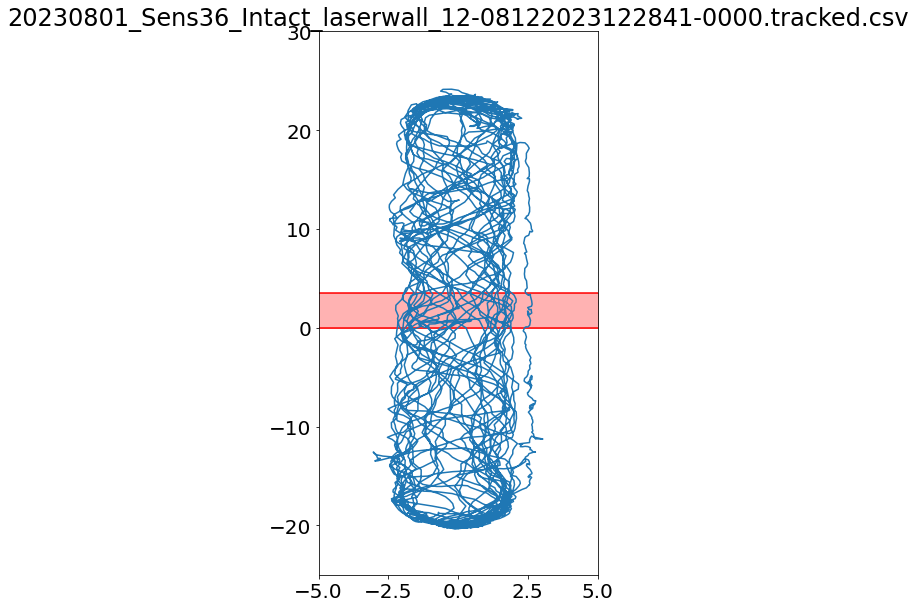

20230801_Sens36_Intact_laserwall_13-08122023123250-0000.tracked.csv
3.04
-3.0399999999999996


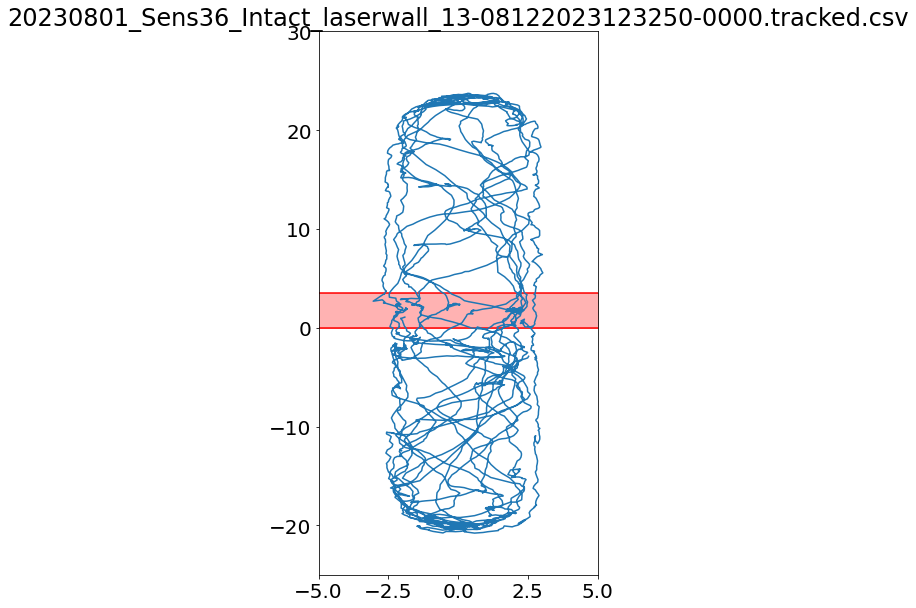

20230801_Sens36_Intact_laserwall_14-08122023123727-0000.tracked.csv
3.04
-3.0400000000000005


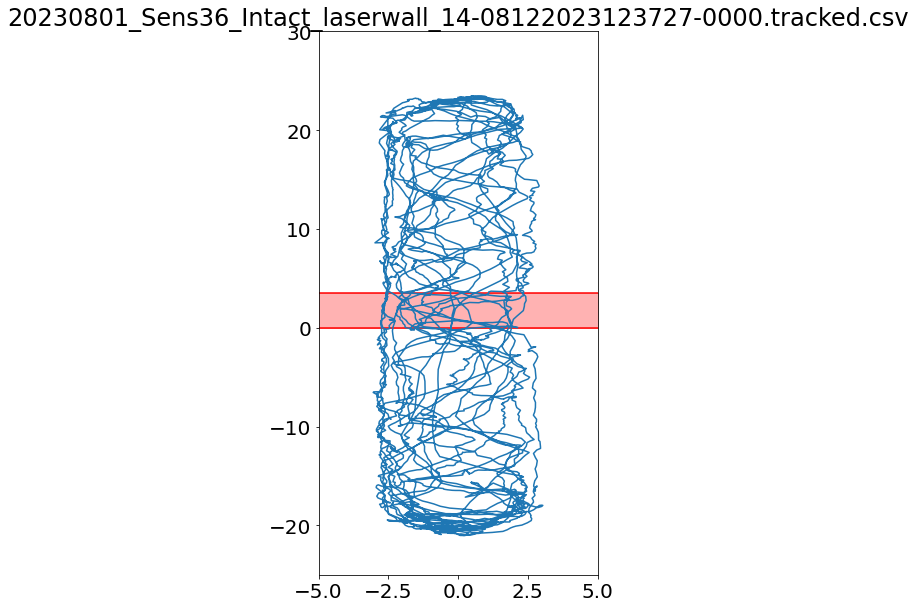

20230810_Sens36_Intact_laserwall_1-08102023135152-0000.tracked.csv
3.04
-3.04


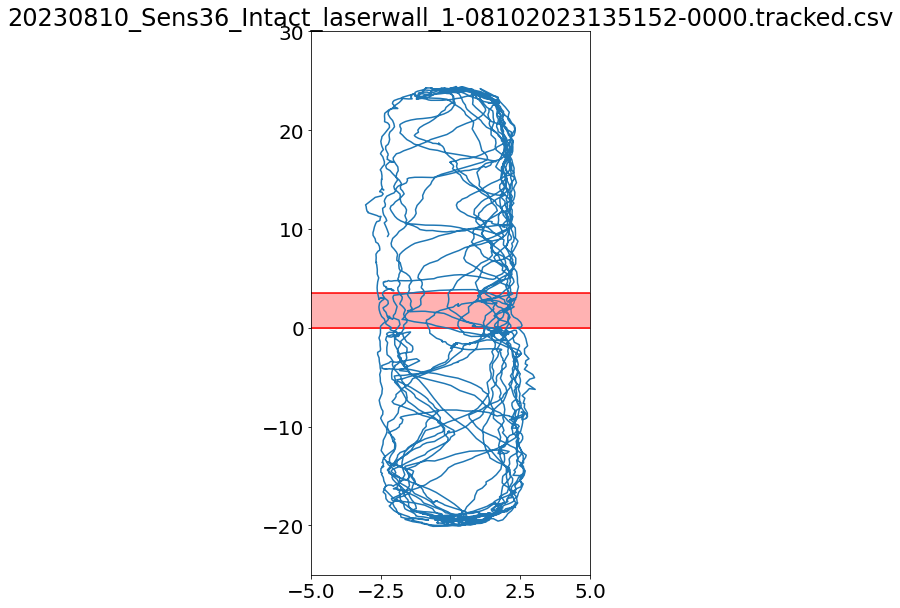

20230810_Sens36_Intact_laserwall_15_Corrected-08222023153011-0000-1.tracked.csv
3.04
-3.0400000000000005


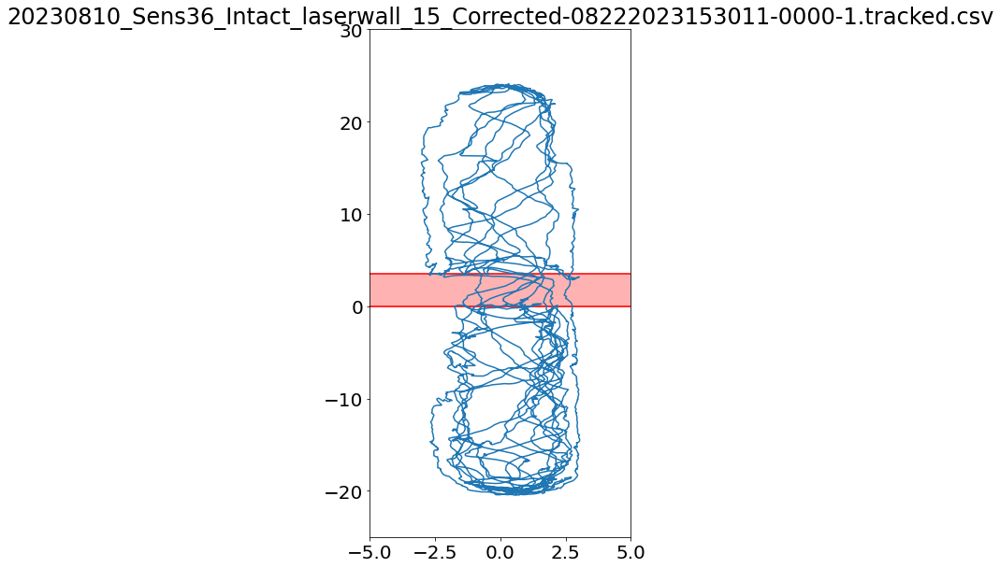

20230810_Sens36_Intact_laserwall_16_corrected-08222023153804-0000-1.tracked.csv
3.039999999999999
-3.04


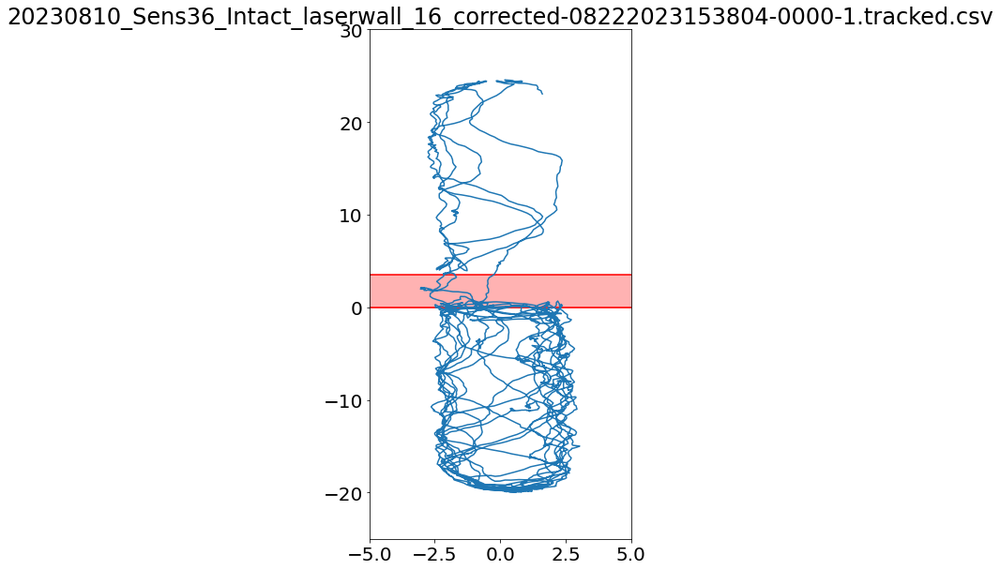

20230810_Sens36_Intact_laserwall_17-08222023154208-0000.tracked.csv
3.04
-3.0399999999999996


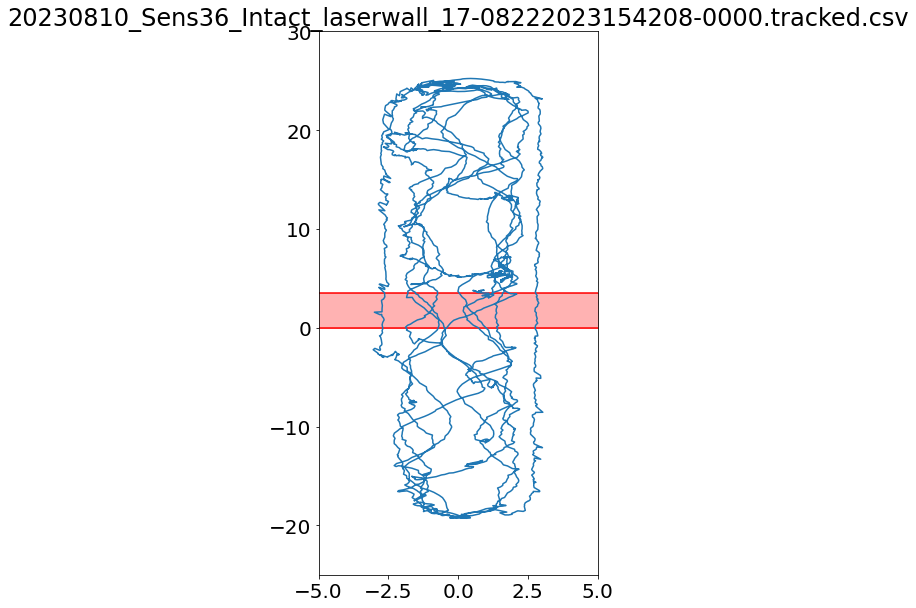

20230810_Sens36_Intact_laserwall_18-08222023154556-0000.tracked.csv
3.039999999999999
-3.04


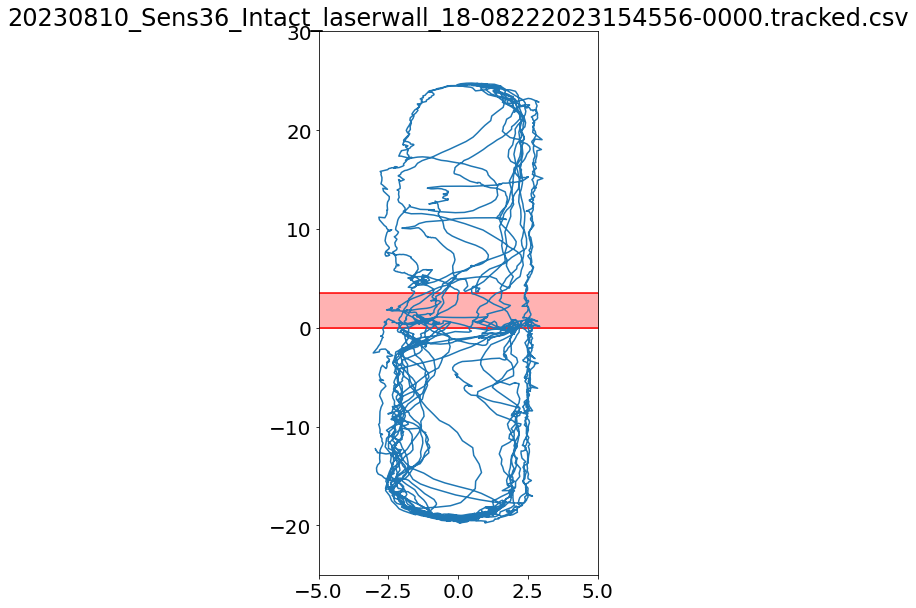

20230810_Sens36_Intact_laserwall_19_corrected-08222023154945-0000-1.tracked.csv
3.04
-3.0400000000000005


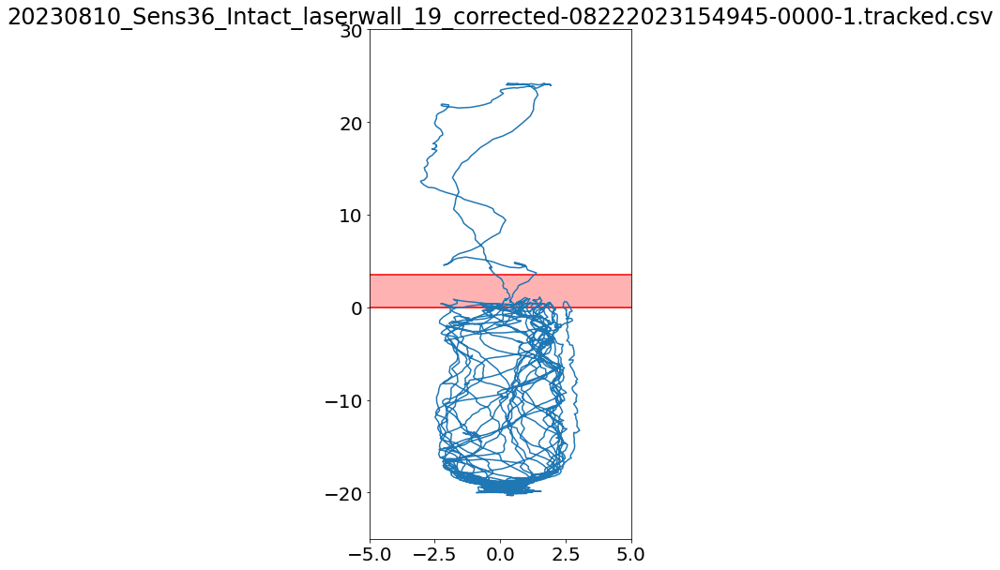

20230810_Sens36_Intact_laserwall_20-08222023155340-0000.tracked.csv
3.039999999999999
-3.04


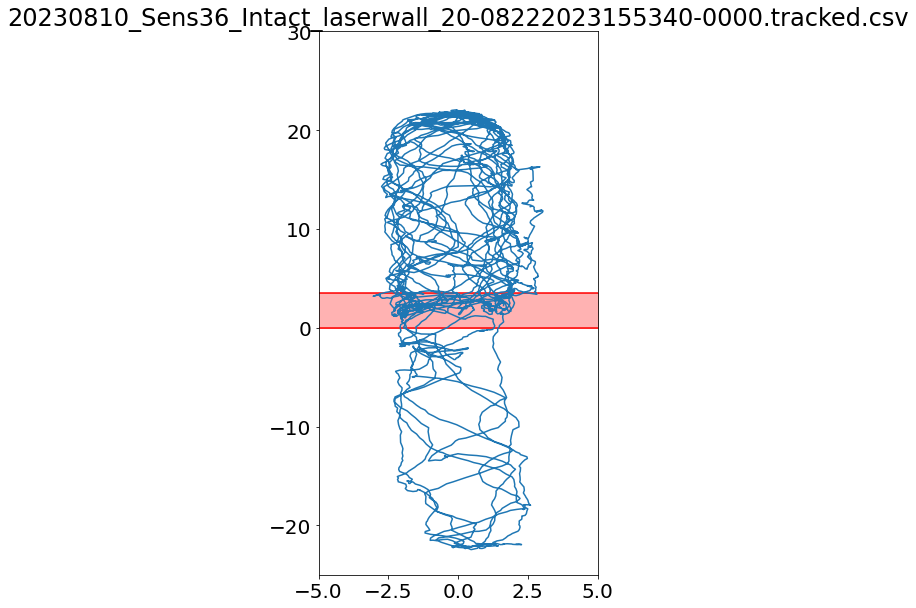

20230810_Sens36_Intact_laserwall_3-08102023135732-0000.tracked.csv
3.04
-3.0399999999999996


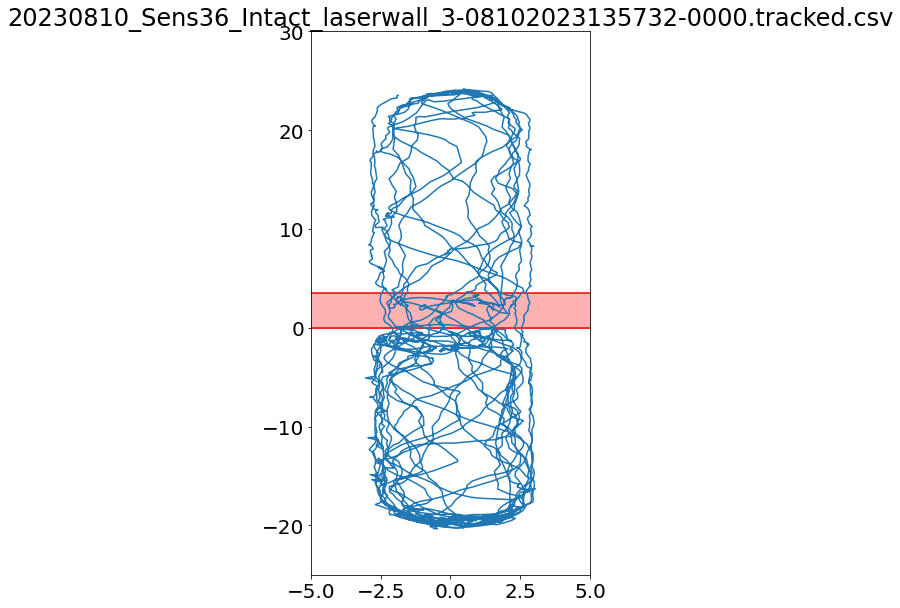

20230810_Sens36_Intact_laserwall_4-08102023140325-0000.tracked.csv
3.04
-3.04


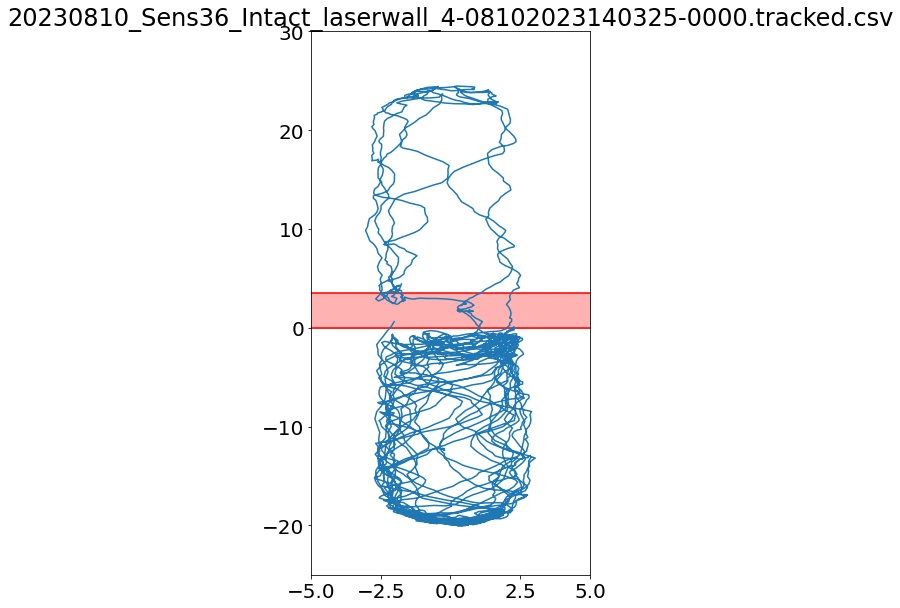

20230810_Sens36_Intact_laserwall_5-08102023140719-0000.tracked.csv
3.04
-3.0399999999999996


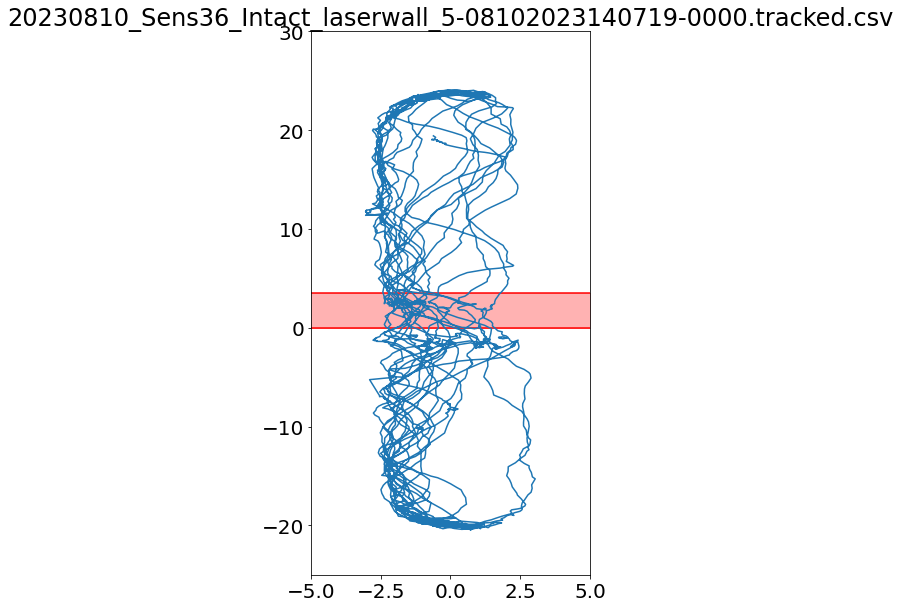

20230810_Sens36_Intact_laserwall_6-08102023141136-0000.tracked.csv
3.04
-3.04


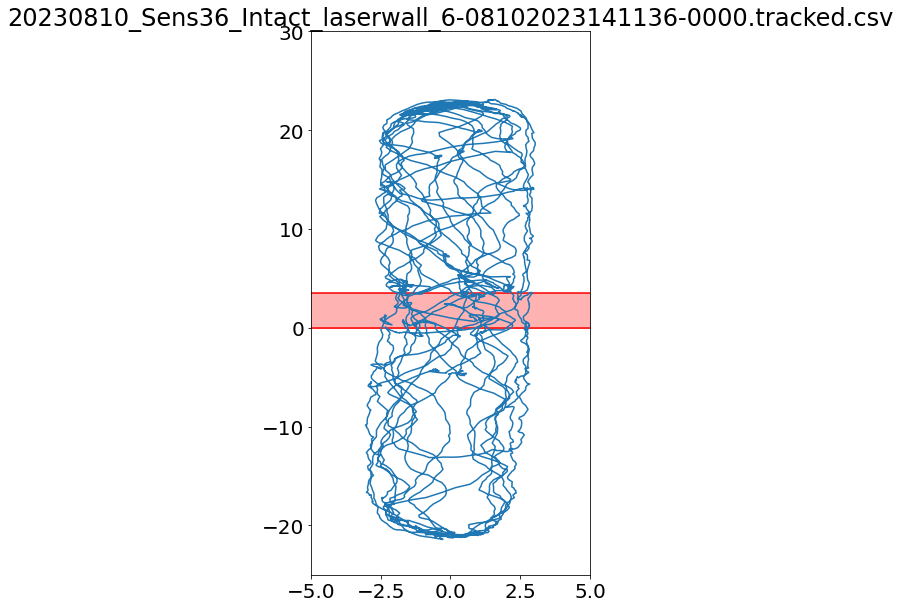

20230810_Sens36_Intact_laserwall_7-08102023141549-0000.tracked.csv
3.04
-3.04


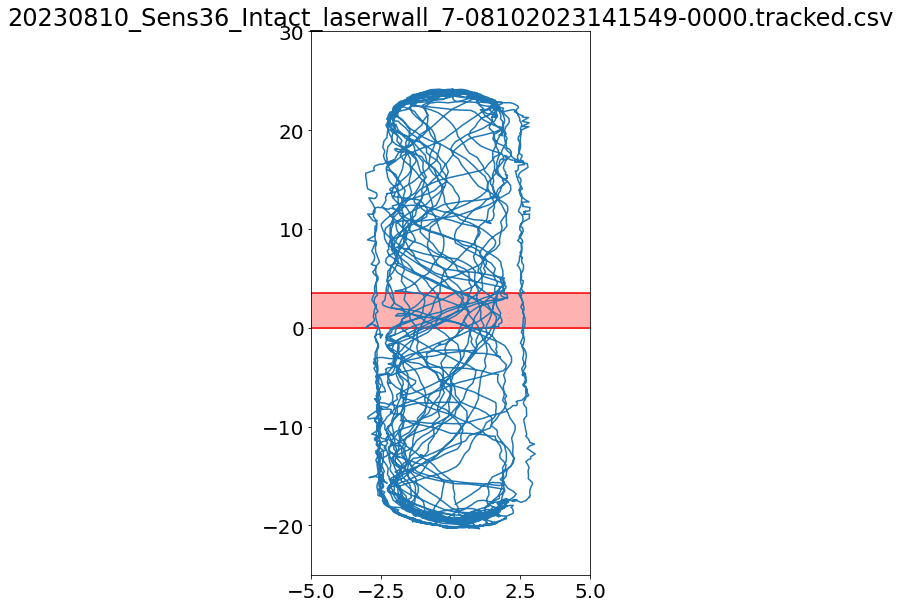

20230810_Sens36_Intact_laserwall_8-08102023141945-0000.tracked.csv
3.04
-3.0399999999999996


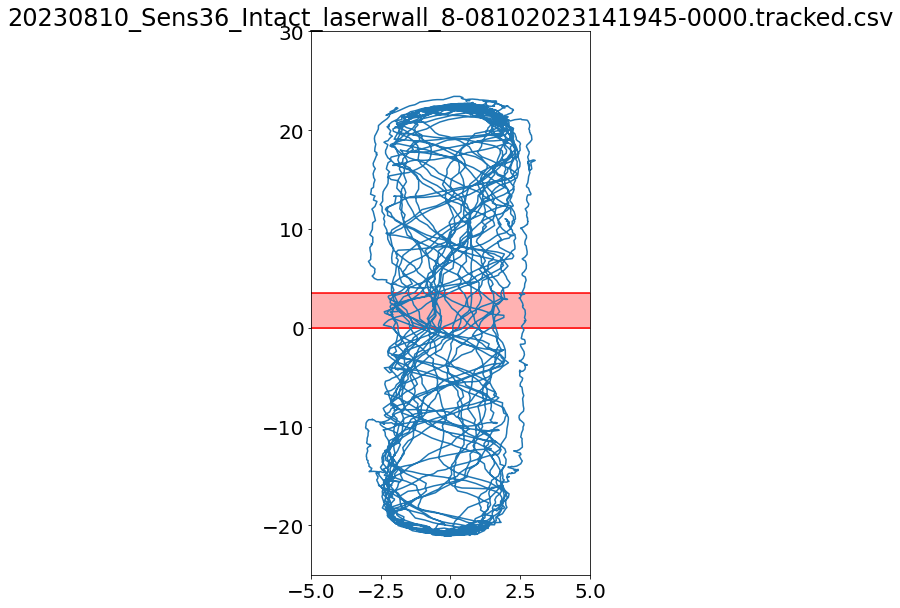

20230810_Sens36_Intact_laserwall_9-08122023121644-0000.tracked.csv
3.04
-3.0399999999999996


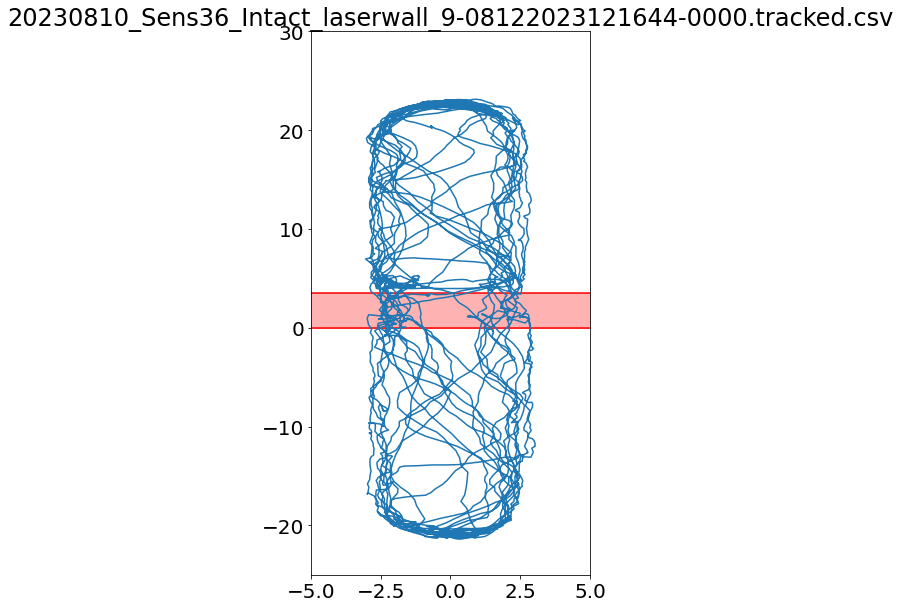

20230725_Sens13_Intact_laserwall_1.csv
3.039999999999999
-3.04


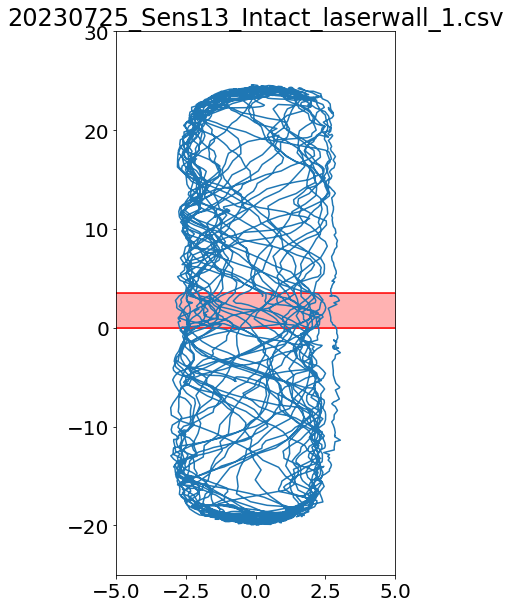

20230725_Sens13_Intact_laserwall_10.csv
3.039999999999999
-3.04


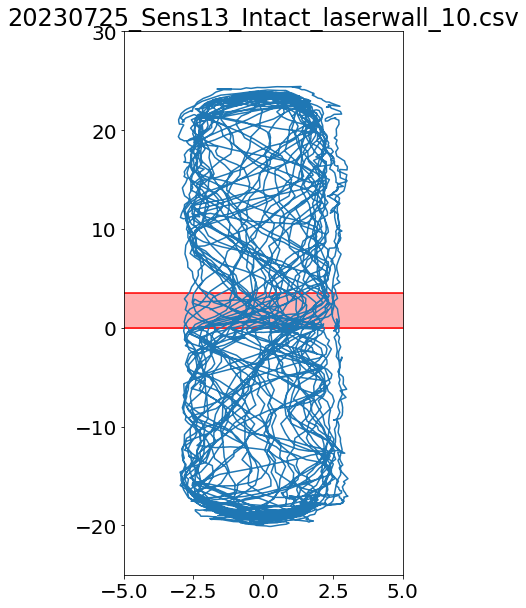

20230725_Sens13_Intact_laserwall_2.csv
3.040000000000001
-3.04


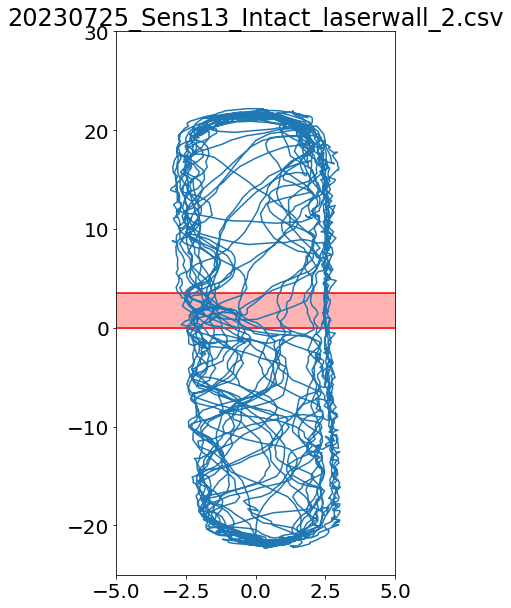

20230725_Sens13_Intact_laserwall_3.csv
3.04
-3.04


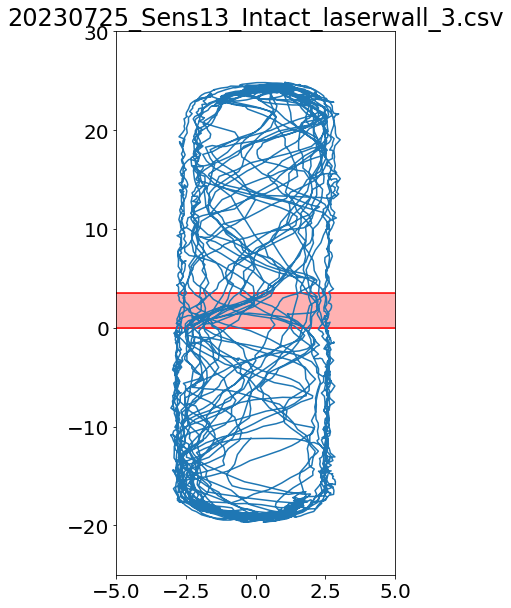

20230725_Sens13_Intact_laserwall_4.csv
3.04
-3.04


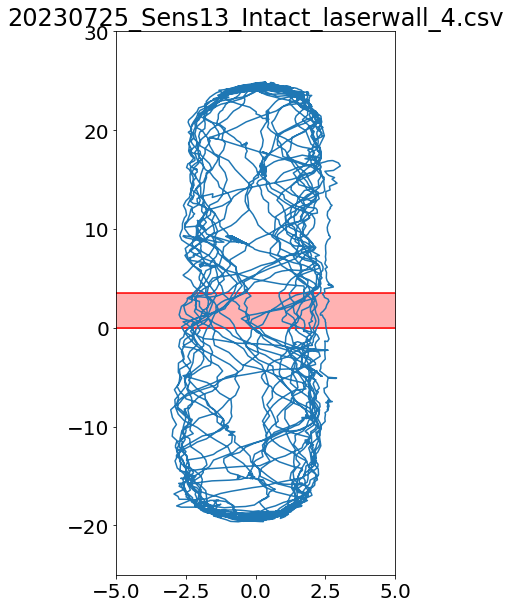

20230725_Sens13_Intact_laserwall_5.csv
3.04
-3.04


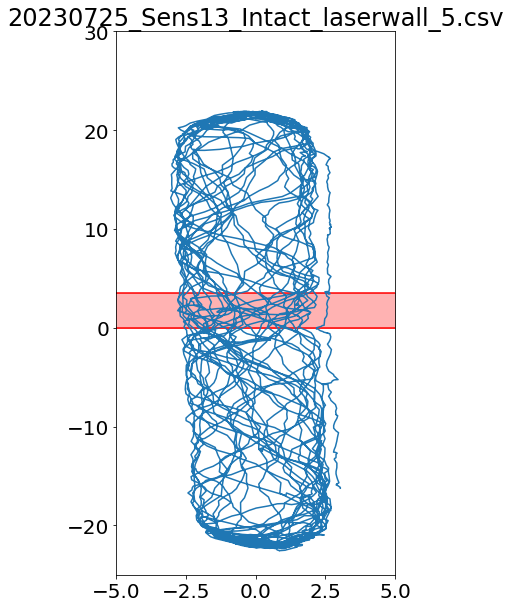

20230725_Sens13_Intact_laserwall_6.csv
3.040000000000001
-3.04


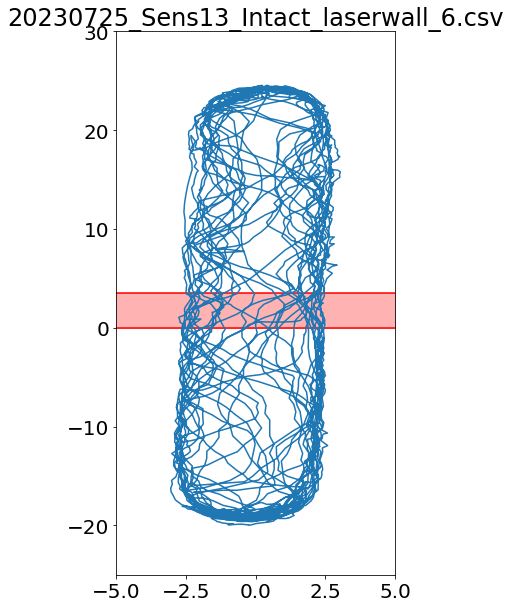

20230725_Sens13_Intact_laserwall_7.csv
3.039999999999999
-3.0399999999999996


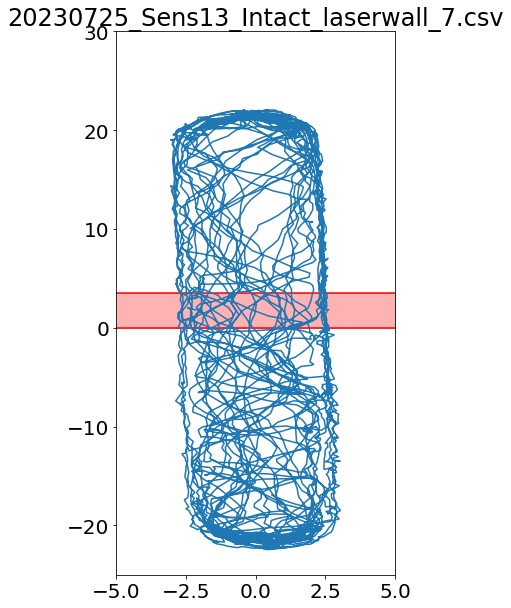

20230725_Sens13_Intact_laserwall_8.csv
3.040000000000001
-3.04


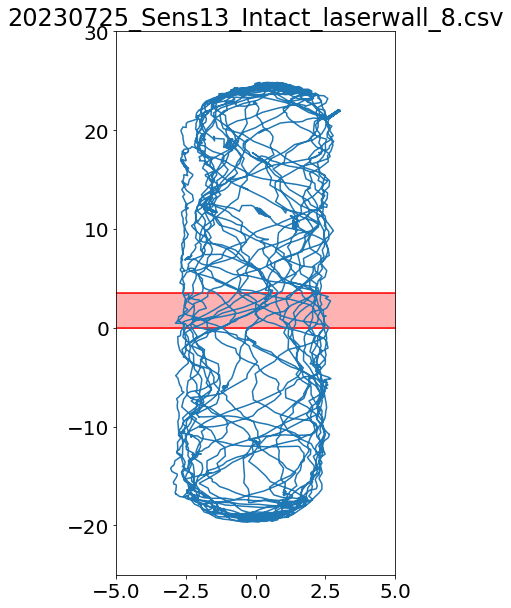

20230725_Sens13_Intact_laserwall_9.csv
3.04
-3.0400000000000005


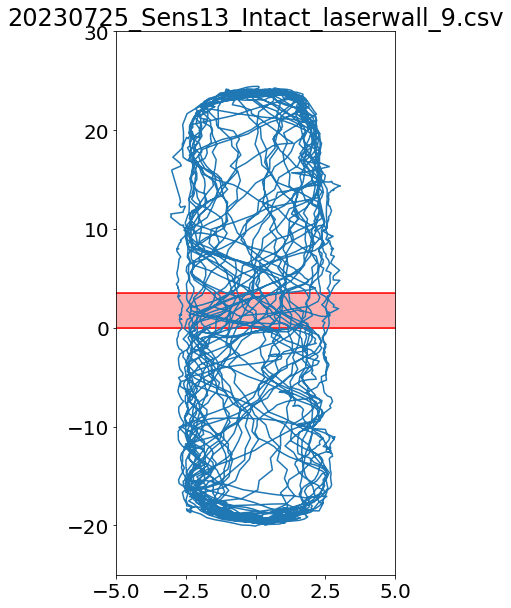

20230727_Sens13_Intact_laserwall_14.csv
3.04
-3.0399999999999996


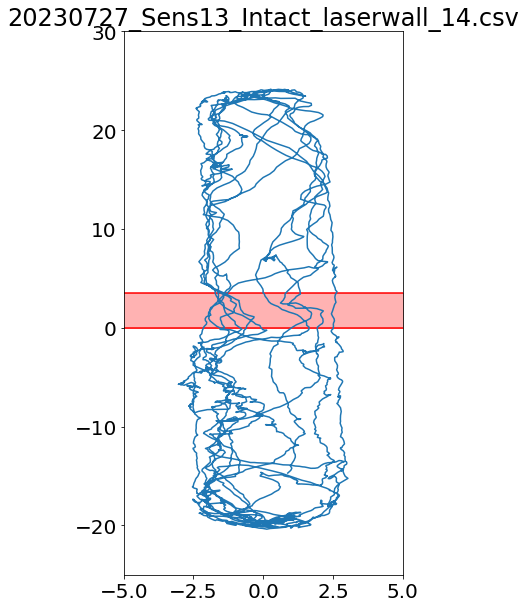

20230727_Sens13_Intact_laserwall_15.csv
3.04
-3.04


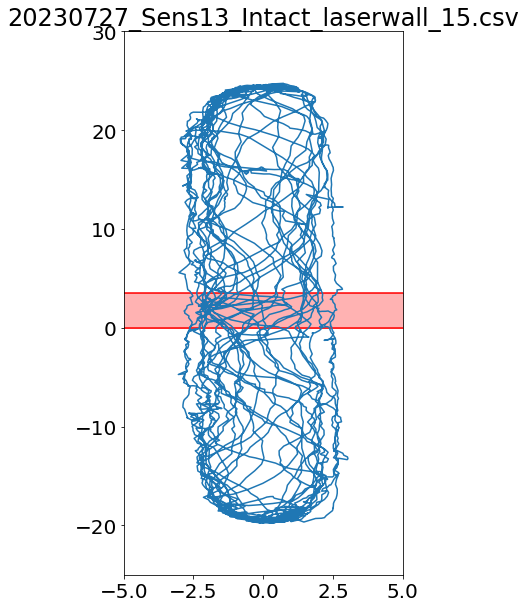

20230727_Sens13_Intact_laserwall_16.csv
3.04
-3.0400000000000005


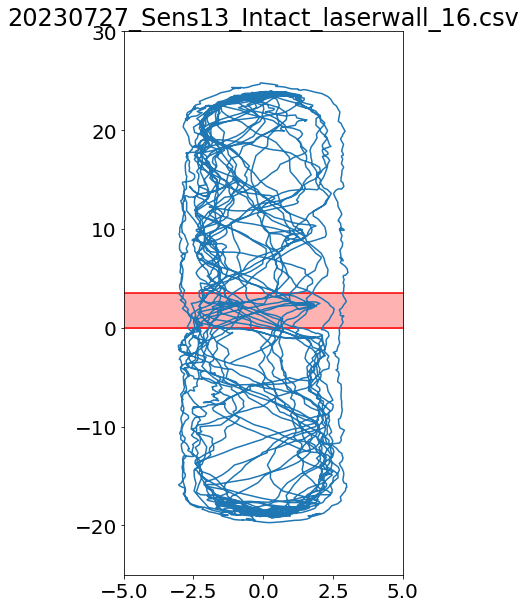

20230727_Sens13_Intact_laserwall_17.csv
3.040000000000001
-3.04


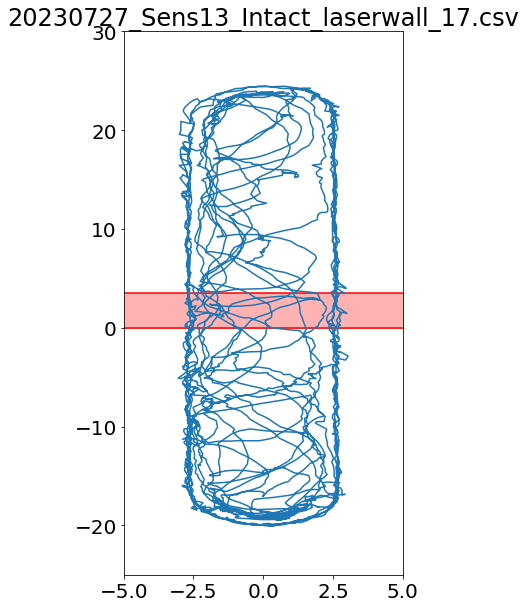

20230727_Sens13_Intact_laserwall_18.csv
3.04
-3.0400000000000005


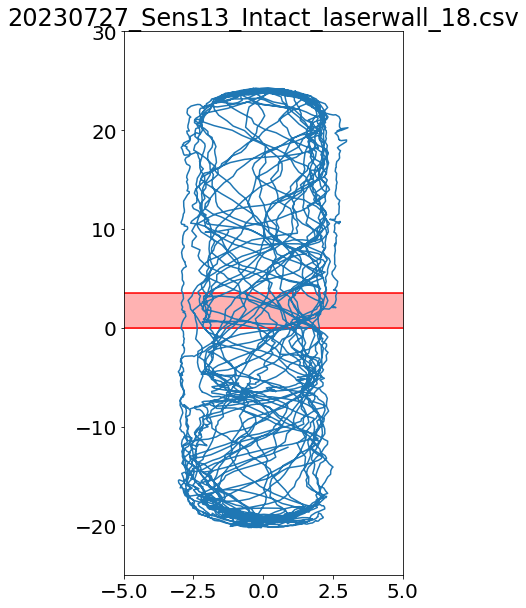

20230810_Sens13_Intact_laserwall_19.csv
3.04
-3.04


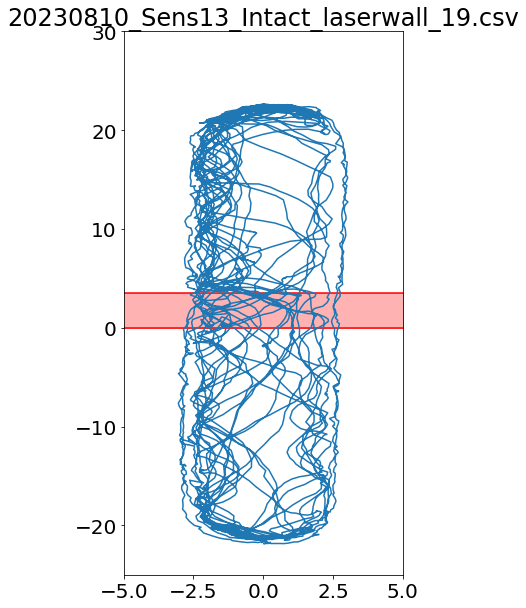

20230810_Sens13_Intact_laserwall_20.csv
3.039999999999999
-3.0399999999999996


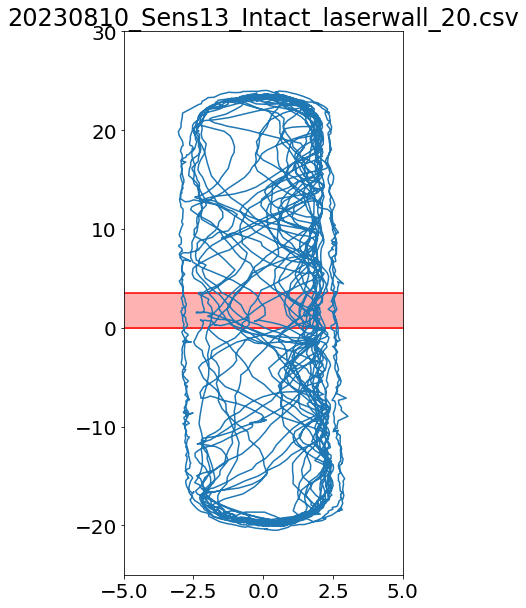

20230725_Sens34_Intact_laserwall_11-07312023123449-0000.tracked.csv
3.04
-3.04


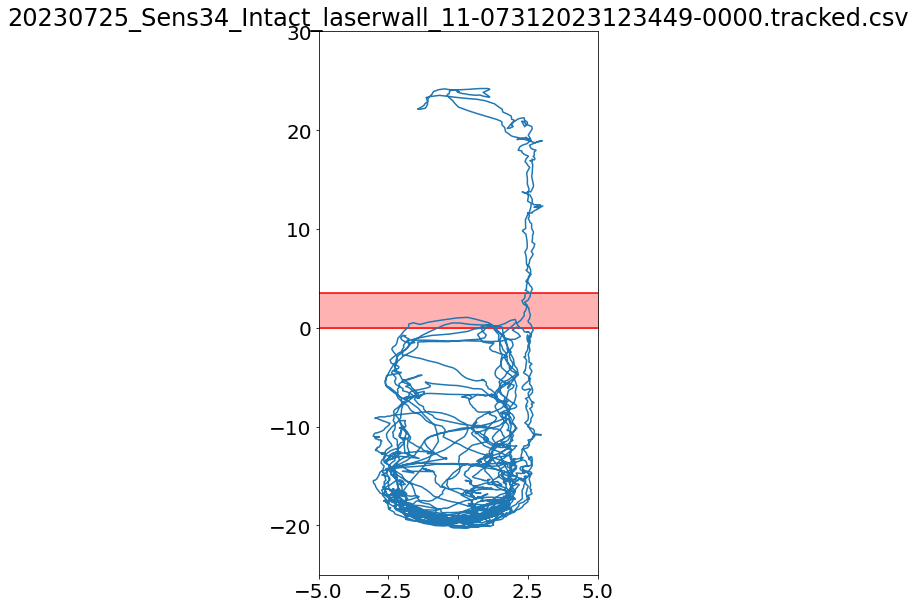

20230725_Sens34_Intact_laserwall_12-07312023123946-0000.tracked.csv
3.04
-3.0399999999999996


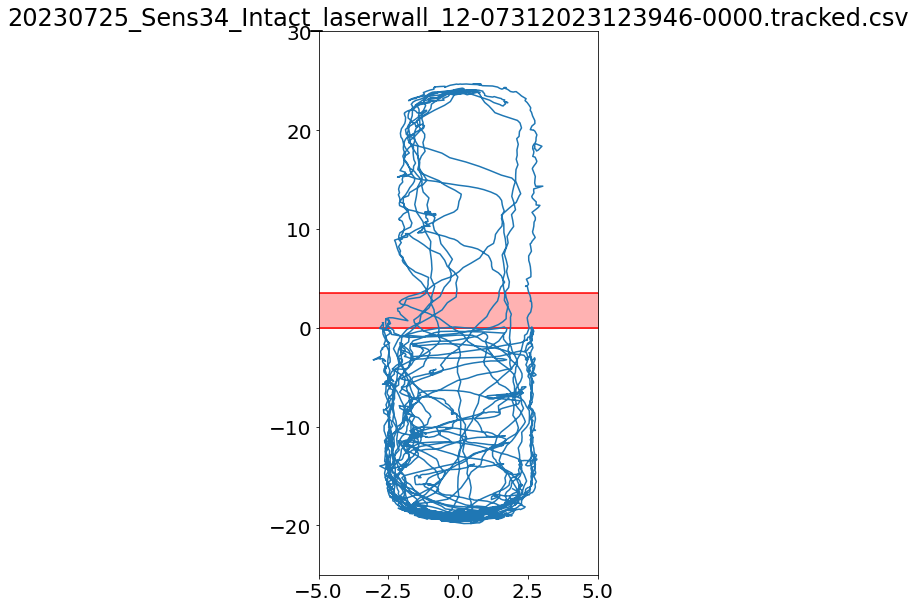

20230725_Sens34_Intact_laserwall_13-07312023124434-0000.tracked.csv
3.039999999999999
-3.0399999999999996


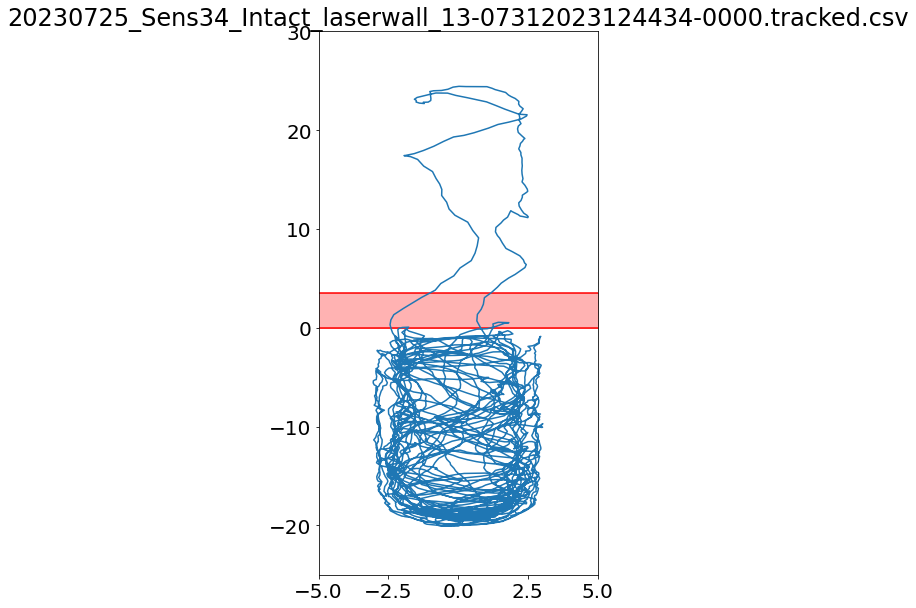

20230725_Sens34_Intact_laserwall_14-07312023125318-0000.tracked.csv
3.04
-3.0400000000000005


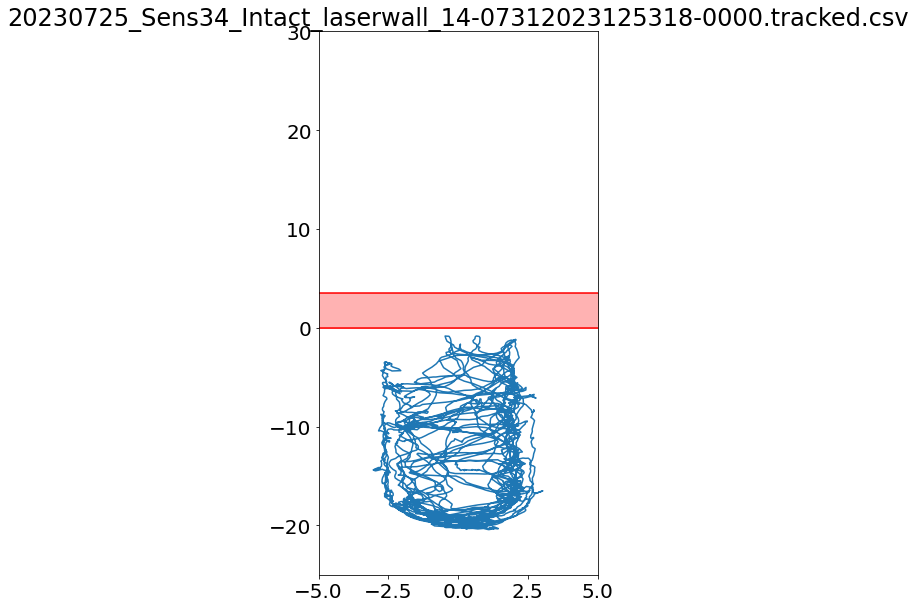

20230725_Sens34_Intact_laserwall_15-07312023130023-0000.tracked.csv
3.04
-3.04


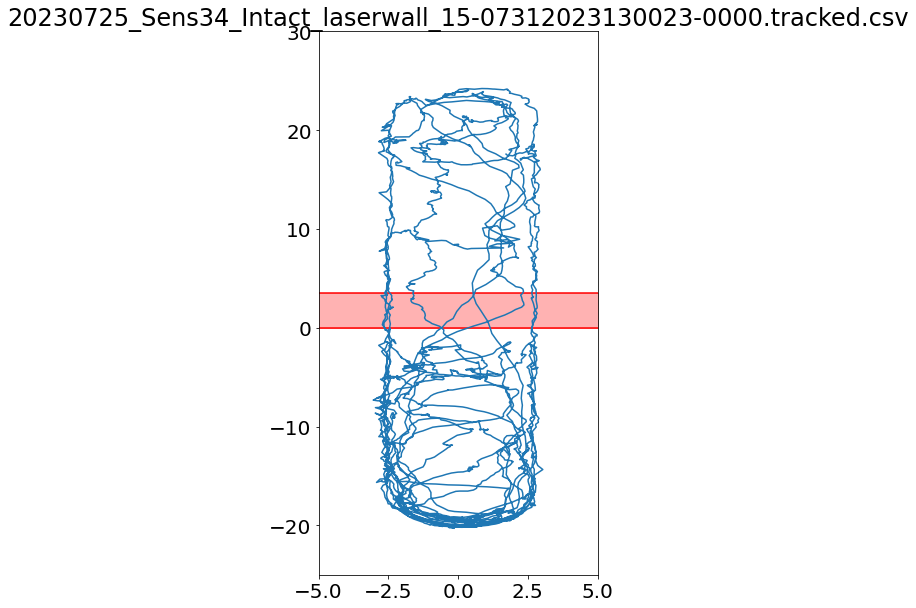

20230725_Sens34_Intact_laserwall_16-07312023135601-0000.tracked.csv
3.039999999999999
-3.0399999999999996


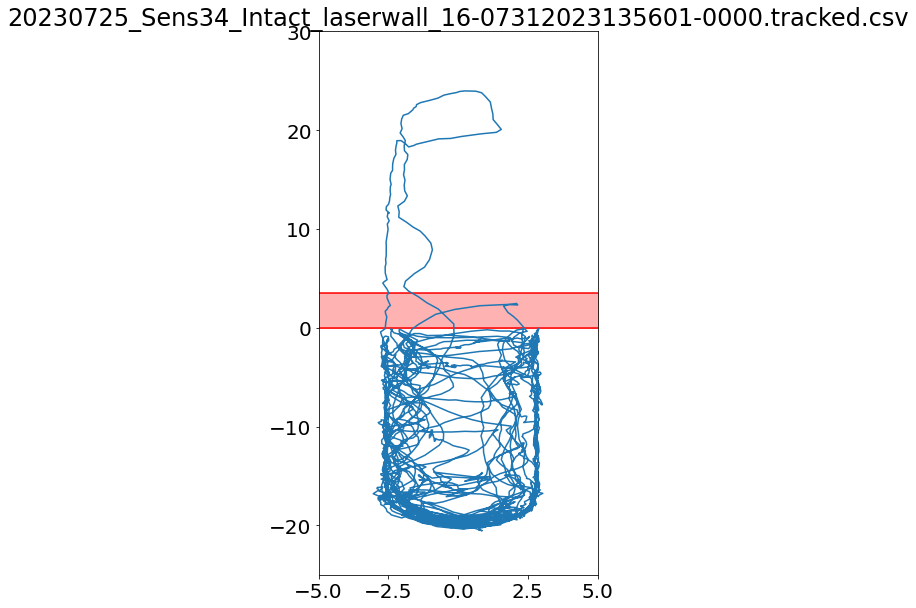

20230725_Sens34_Intact_laserwall_17-07312023140004-0000.tracked.csv
3.04
-3.04


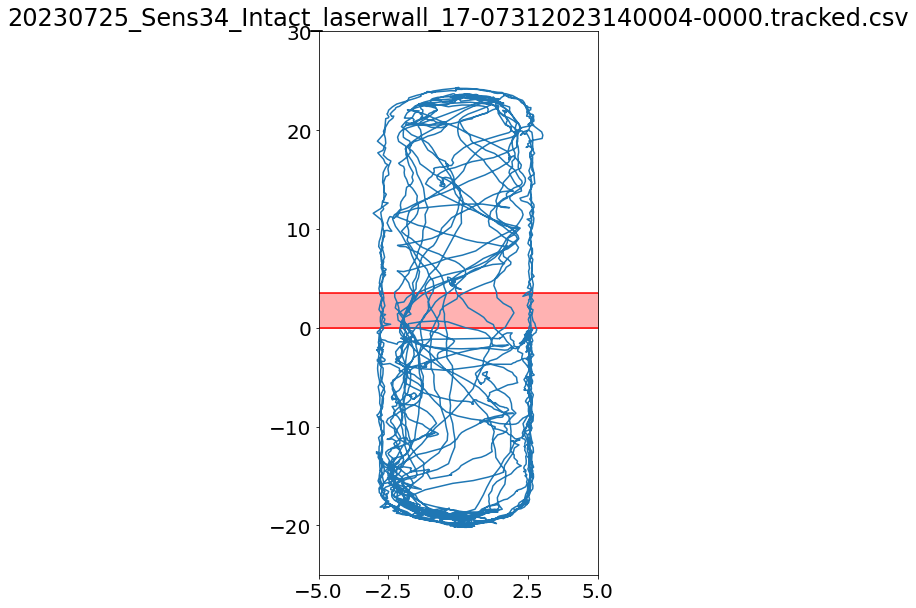

20230725_Sens34_Intact_laserwall_18-07312023140359-0000.tracked.csv
3.04
-3.0400000000000005


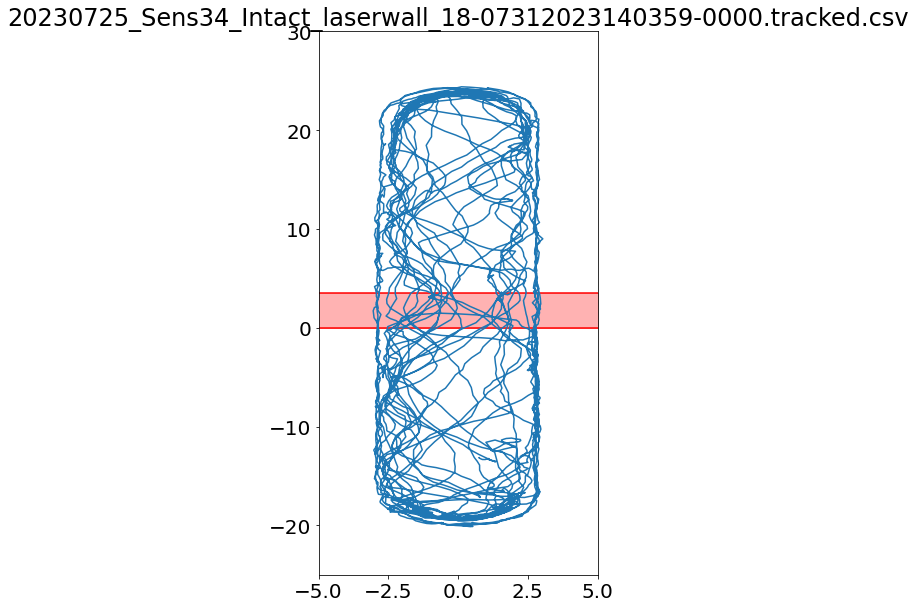

20230725_Sens34_Intact_laserwall_19-07312023140835-0000.tracked.csv
3.04
-3.0399999999999996


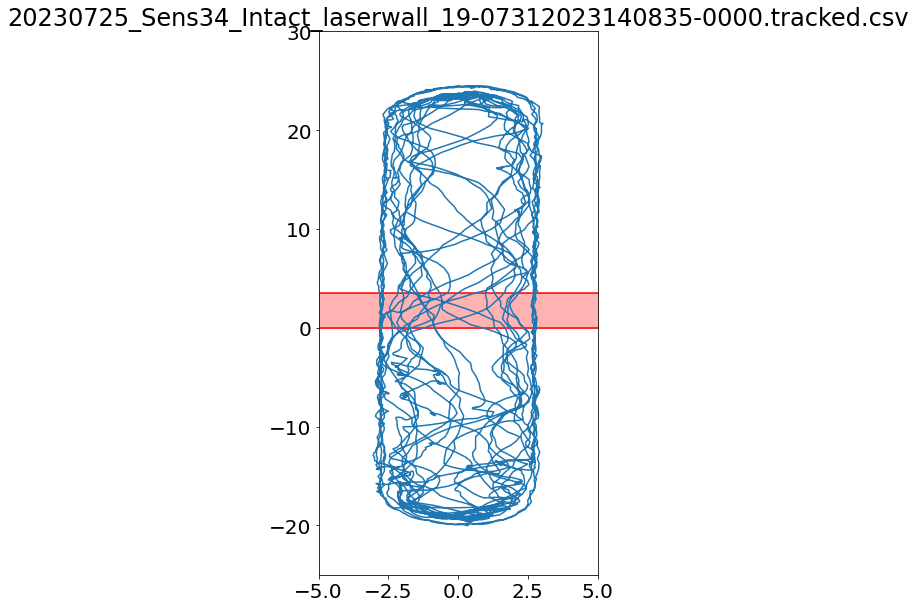

20230725_Sens34_Intact_laserwall_20-07312023141217-0000.tracked.csv
3.04
-3.04


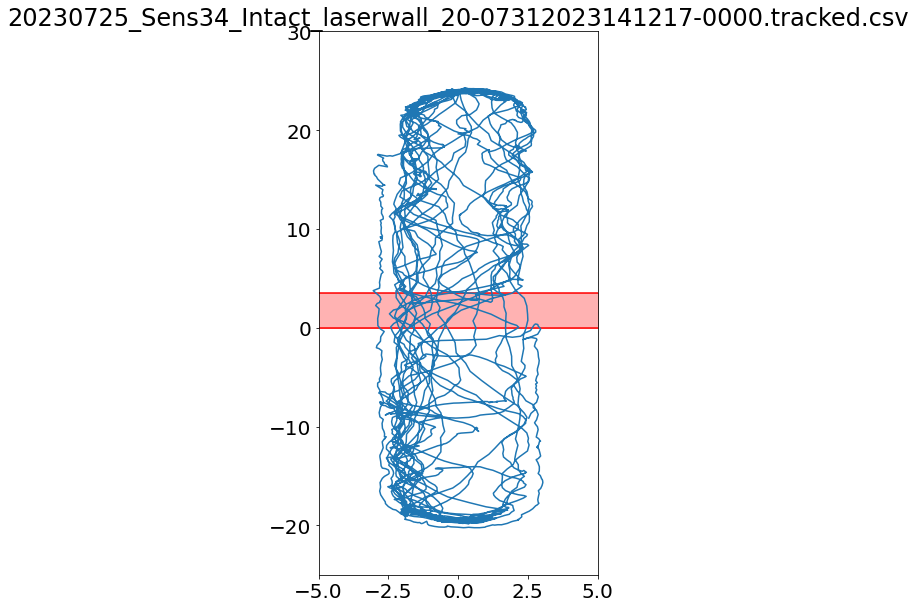

20230725_Sens34_Intact_laserwall_21-07312023141605-0000.tracked.csv
3.039999999999999
-3.04


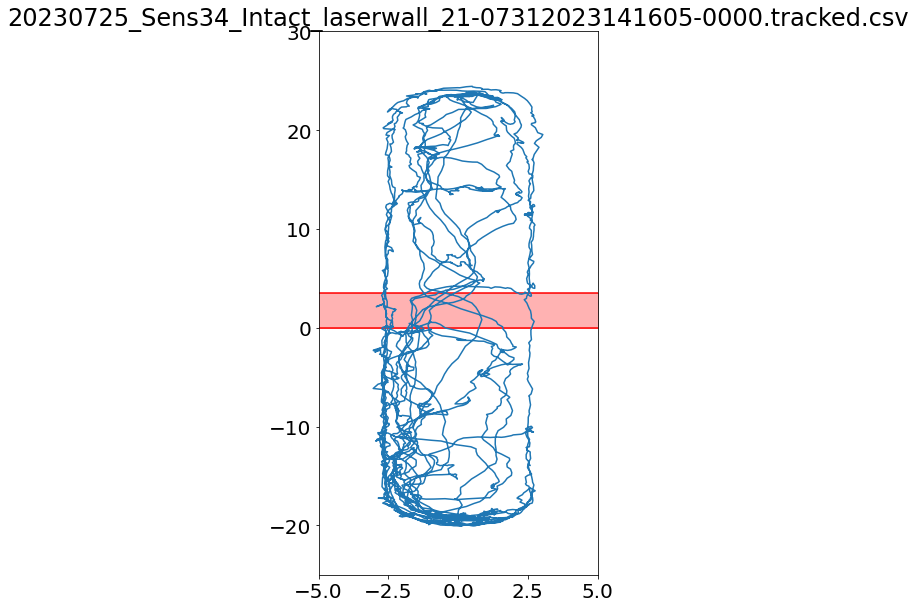

20230725_Sens34_Intact_laserwall_22-07312023142352-0000.tracked.csv
3.039999999999999
-3.04


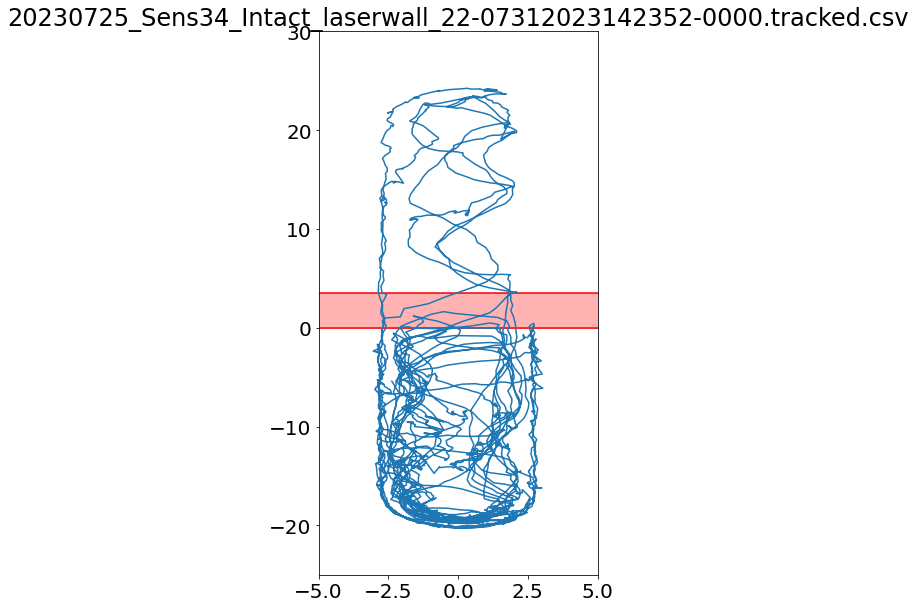

20230725_Sens34_Intact_laserwall_23-07312023142751-0000.tracked.csv
3.04
-3.04


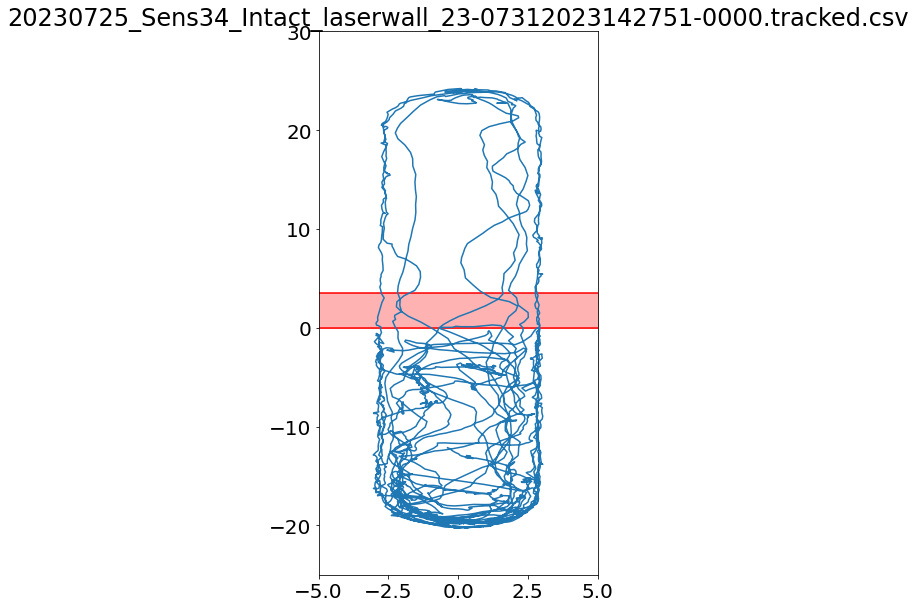

20230725_Sens34_Intact_laserwall_3.csv
3.04
-3.04


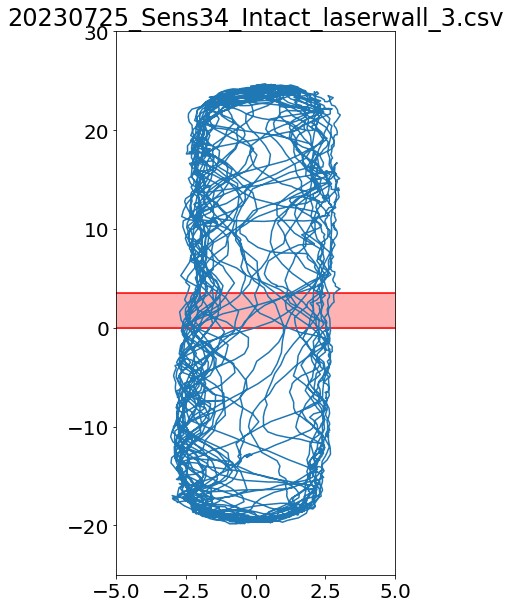

20230725_Sens34_Intact_laserwall_4.csv
3.04
-3.0400000000000005


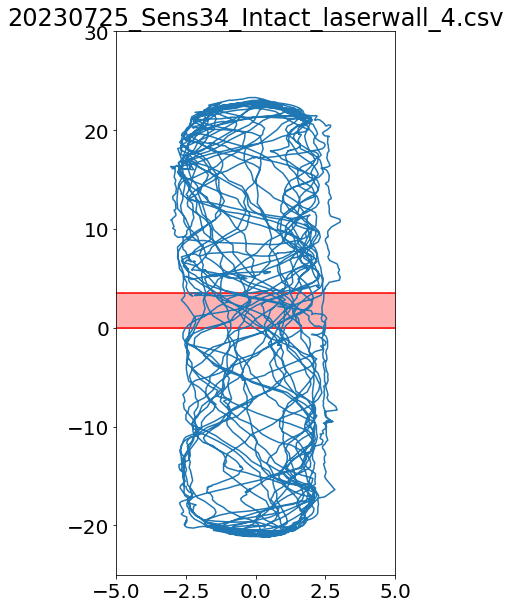

20230725_Sens34_Intact_laserwall_5.csv
3.04
-3.04


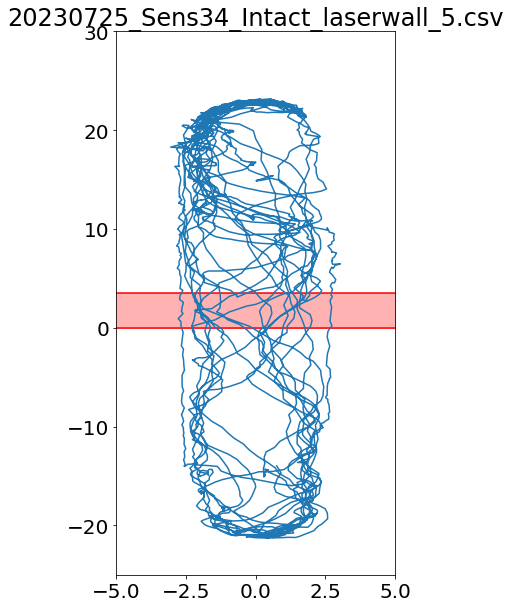

20230725_Sens34_Intact_laserwall_6.csv
3.04
-3.0400000000000005


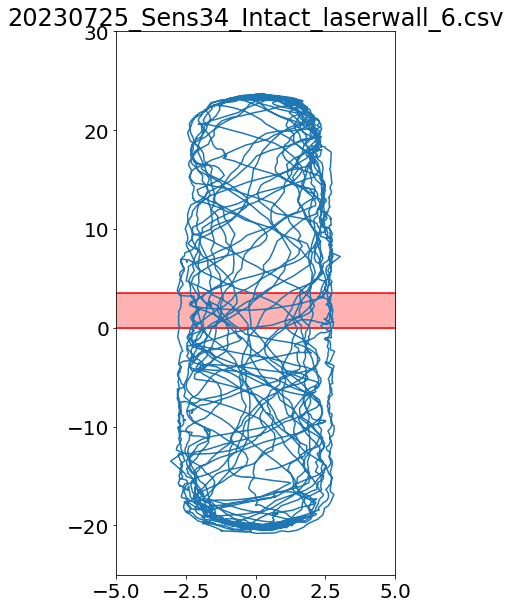

20230725_Sens34_Intact_laserwall_7.csv
3.04
-3.04


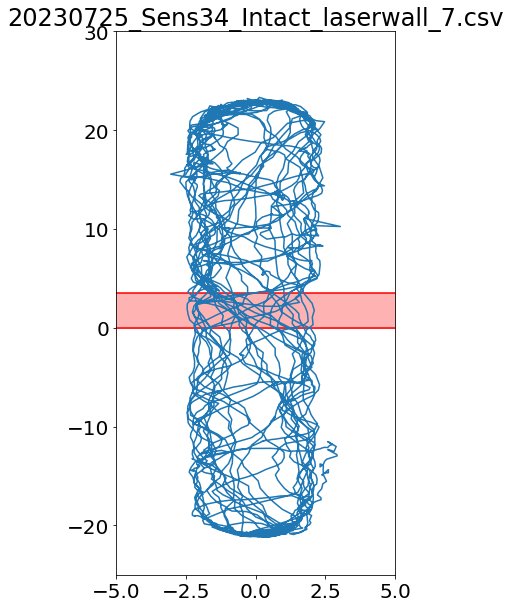

20230725_Sens34_Intact_laserwall_8.csv
3.039999999999999
-3.04


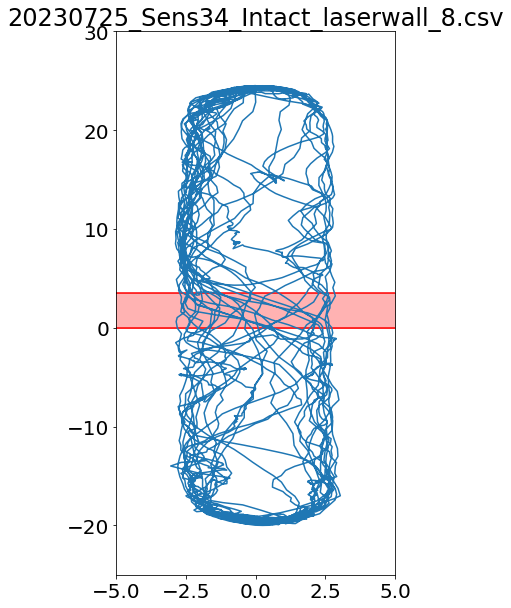

In [42]:
graphs_indivs(CHO,save_loc="cho/")
graphs_indivs(empty,save_loc="empty/")
graphs_indivs(MSB,save_loc="msb/")
graphs_indivs(MSB4,save_loc="msb4/")
graphs_indivs(MSB5,save_loc="msb5/")
graphs_indivs(MSB6,save_loc="msb6/")
graphs_indivs(MSB7,save_loc="msb7/")

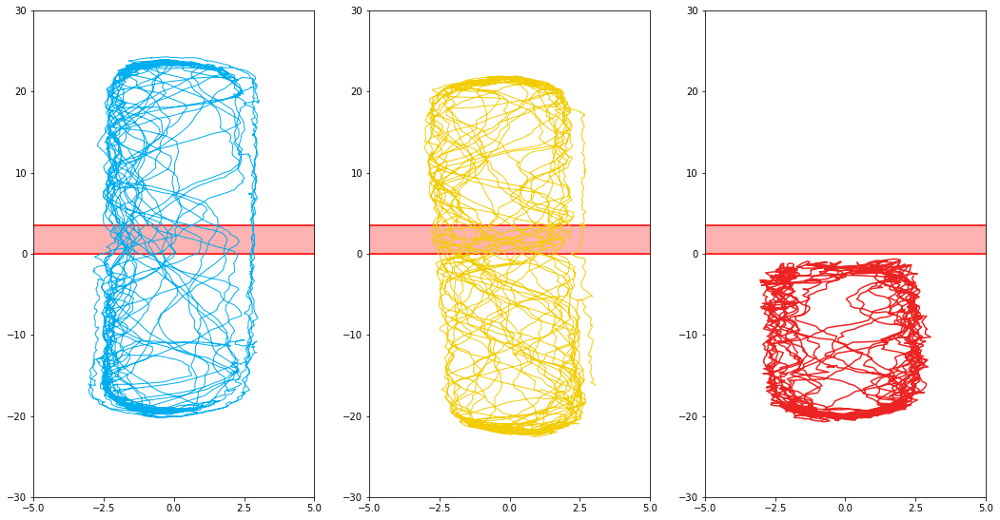

In [7]:
## for paper

y_lims = 30

fig, ax = plt.subplots(1,3,figsize = [15,8])

plt.rcParams.update({'font.size':20})

for file in empty.Filename.unique()[5:6]:
    ax[0].plot(empty.query("Filename == @file")['norm_x'],empty.query("Filename == @file")['norm_y'],linewidth = 1,color='#00ADEF')
ax[0].hlines(0,-7,7,color='r')
ax[0].hlines(laser_height_all,-6,6,color='r')
ax[0].fill_between([-6,6],[0,0],[laser_height_all,laser_height_all],color='r',alpha=0.3)
ax[0].set_xlim(-5,5)
ax[0].set_ylim(-y_lims,y_lims)

for file in MSB6.Filename.unique()[5:6]:
    ax[1].plot(MSB6.query("Filename == @file")['norm_x'],MSB6.query("Filename == @file")['norm_y'],linewidth = 1, color='#F2CD05')
ax[1].hlines(0,-6,6,color='r')
ax[1].hlines(laser_height_all,-6,6,color='r')
ax[1].fill_between([-6,6],[0,0],[laser_height_all,laser_height_all],color='r',alpha=0.3)

ax[1].set_xlim(-5,5)
ax[1].set_ylim(-y_lims,y_lims)

for file in MSB.Filename.unique()[5:6]:
    ax[2].plot(MSB.query("Filename == @file")['norm_x'],MSB.query("Filename == @file")['norm_y'], color='#ED2424')
ax[2].hlines(0,-6,6,color='r')
ax[2].hlines(laser_height_all,-6,6,color='r')
ax[2].fill_between([-6,6],[0,0],[laser_height_all,laser_height_all],color='r',alpha=0.3)
ax[2].set_xlim(-5,5)
ax[2].set_ylim(-y_lims,y_lims)

plt.tight_layout()
#plt.savefig('IndTraces.svg')
#plt.show()

In [8]:
perc_MSB4 = perc_time(MSB4,"MSB4")
perc_MSB5 = perc_time(MSB5,"MSB5")
perc_MSB6 = perc_time(MSB6,"MSB6")
perc_MSB7 = perc_time(MSB7,"MSB7")
perc_MSB = perc_time(MSB,"MSB")
perc_empty = perc_time(empty,"empty")
perc_ChO = perc_time(CHO,"ChO")

percs_all = pd.concat([perc_empty,perc_MSB4,perc_MSB5,perc_MSB6,perc_MSB7,perc_MSB,perc_ChO])



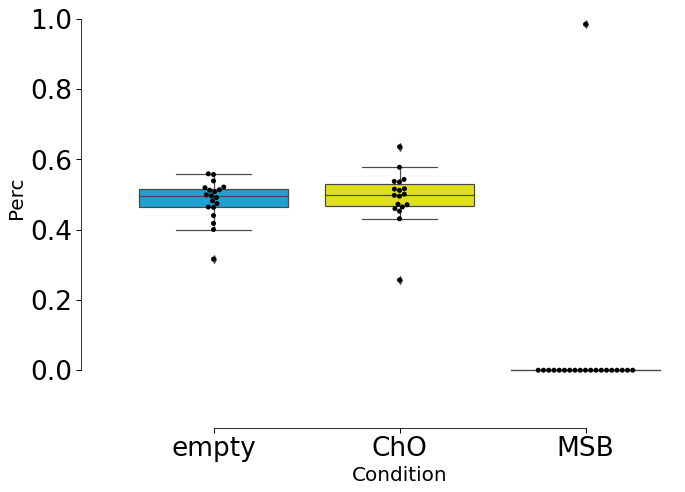

In [9]:
fig, ax = plt.subplots(figsize = [10,7])

sns.set_context("paper", font_scale=3)
sns.boxplot(data = percs_all,x="Condition",y="Perc",order = ["empty","ChO","MSB"],palette=my_pal)
sns.swarmplot(data = percs_all,x="Condition",y="Perc",order = ["empty","ChO","MSB"],color='k')
sns.despine(offset=40, trim=True)
#plt.savefig('percentage_occupancy.svg')

In [12]:
def density_plot(datax,title,vmax = 100,save_loc=""):
    bins = np.linspace(datax.norm_y.min(),datax.norm_y.max(),50)
    histogram = np.histogram(datax.norm_y,bins = bins)
    fig2,ax2 = plt.subplots(1,2,figsize = [6,10],gridspec_kw={'width_ratios': [8, 2]})
    ax2[0].hist2d(datax.norm_x, datax.norm_y, bins=(50, 50), cmap=plt.cm.jet, vmin= 0, vmax= vmax)
    ax2[0].set_axis_off()
    ax2[0].set_ylim([-23,26])
    
    ax2[1].plot(histogram[0],histogram[1][:-1],linewidth=4,c='k')
    ax2[1].set_axis_off()
    ax2[1].set_ylim([-23,26])
    if len(save_loc) > 0:
        fig2.savefig(save_location+save_loc+title+'density_plot.svg')

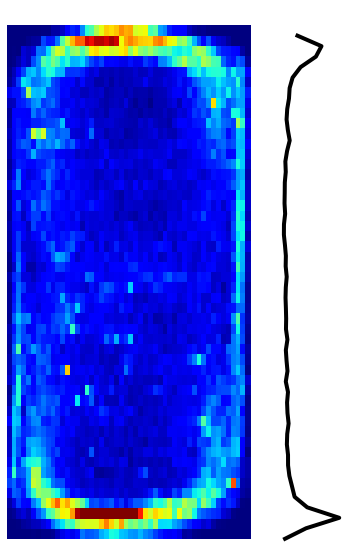

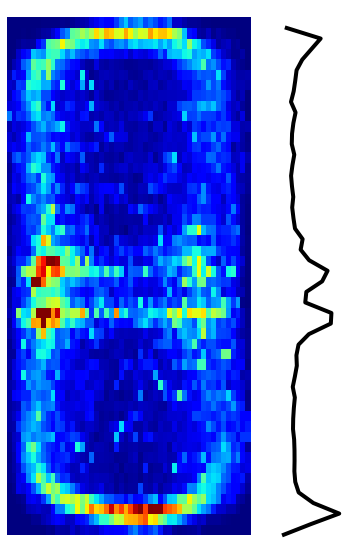

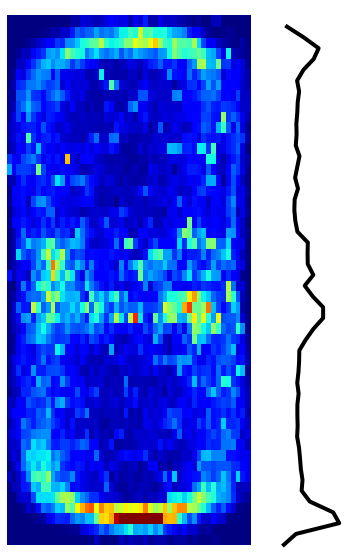

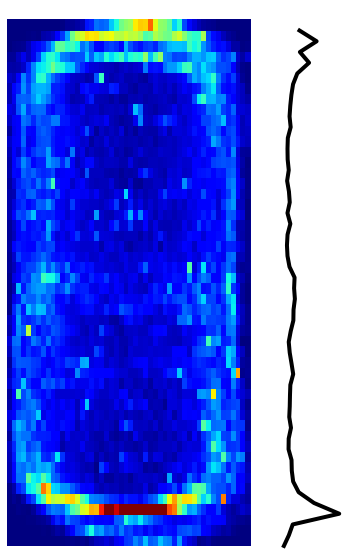

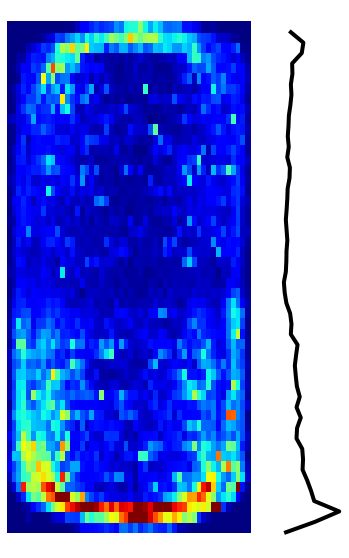

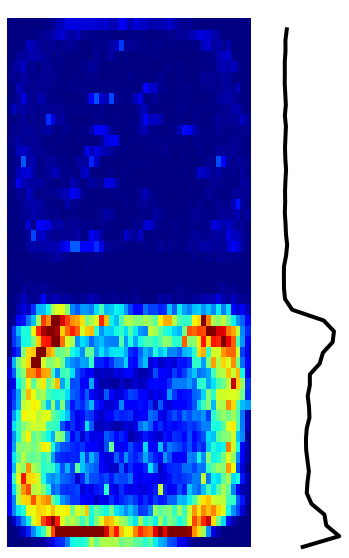

In [13]:
maxv = 250
density_plot(empty, "Empty",vmax = maxv,save_loc="empty/")
#density_plot(CHO, "ChO",vmax = maxv,save_loc="cho/")
density_plot(MSB4, "MSB4",vmax = maxv,save_loc="msb4/")
density_plot(MSB5,"MSB5",vmax = maxv,save_loc="msb5/")
density_plot(MSB6, "MSB6",vmax = maxv,save_loc="msb6/")
density_plot(MSB7,"MSB7",vmax = maxv,save_loc="msb7/")
density_plot(MSB, "MSB",vmax = maxv,save_loc="msb/")


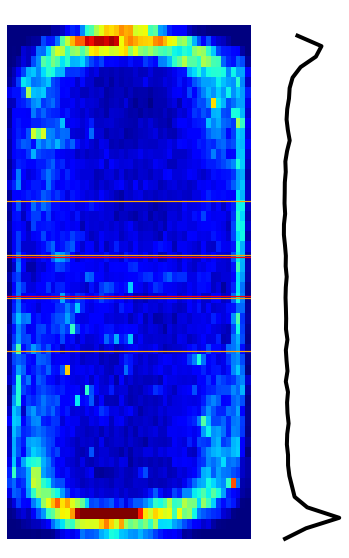

In [24]:
### Density graph showing the laser area and the outside areas
## Red lines show where the laser area is
## Orange lines show where the peri-laser area is

vmax=250
threshold = 0
threshold_out = 5
threshold_in = 0.2

bins = np.linspace(empty.norm_y.min(),empty.norm_y.max(),50)
histogram = np.histogram(empty.norm_y,bins = bins)
fig2,ax2 = plt.subplots(1,2,figsize = [6,10],gridspec_kw={'width_ratios': [8, 2]})
ax2[0].hist2d(empty.norm_x, empty.norm_y, bins=(50, 50), cmap=plt.cm.jet, vmin= 0, vmax= vmax)
ax2[0].set_axis_off()
ax2[0].set_ylim([-23,26])    
ax2[1].plot(histogram[0],histogram[1][:-1],linewidth=4,c='k')
ax2[1].set_axis_off()
ax2[1].set_ylim([-23,26])
ax2[0].hlines(threshold,-6,6,color='r')
ax2[0].hlines(laser_height_all+threshold,-6,6,color='r')

ax2[0].hlines(-threshold_out,-6,6,color='orange')
ax2[0].hlines(-threshold_in,-6,6,color='orange')
ax2[0].hlines(laser_height_all+threshold_out,-6,6,color='orange')
ax2[0].hlines(laser_height_all+threshold_in,-6,6,color='orange')
#ax2[0].hlines(threshold,-6,6,color='orange')
#ax2[0].hlines(laser_height_all+threshold,-6,6,color='r')

fig2.savefig(save_location+'density_plot_with_laser_lines.svg')

### Crosses data

20230725_Sens34_Intact_laserwall_11-07312023123449-0000.tracked.csv


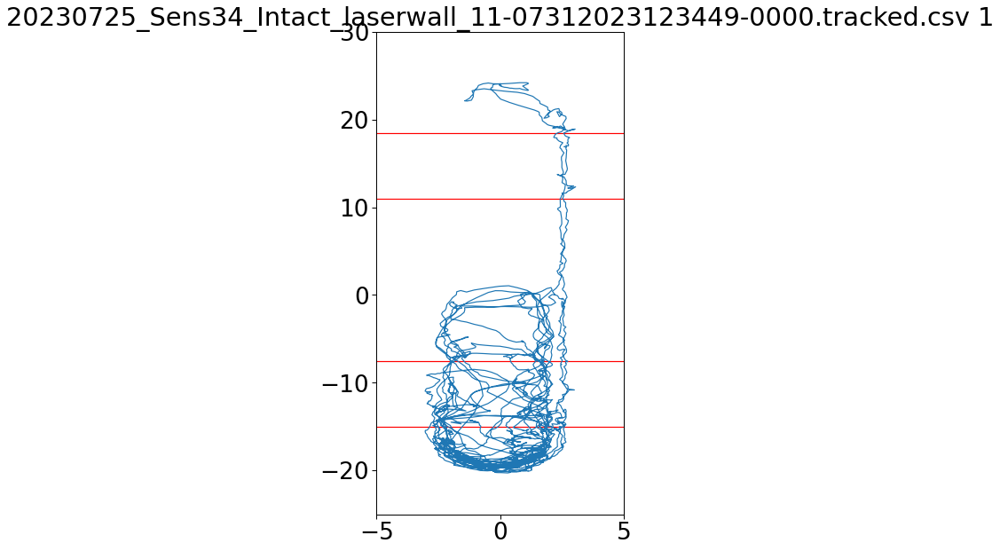

20230725_Sens34_Intact_laserwall_12-07312023123946-0000.tracked.csv


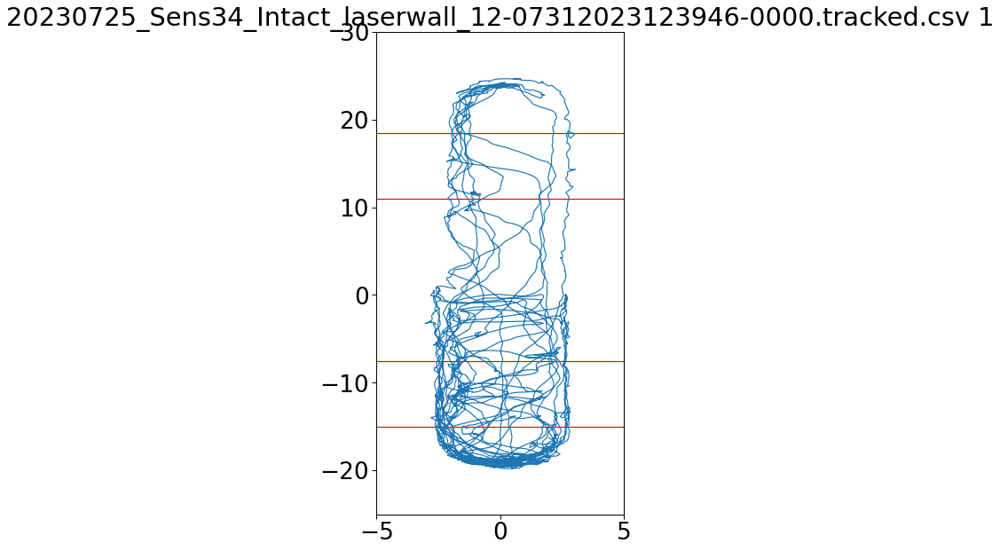

20230725_Sens34_Intact_laserwall_13-07312023124434-0000.tracked.csv


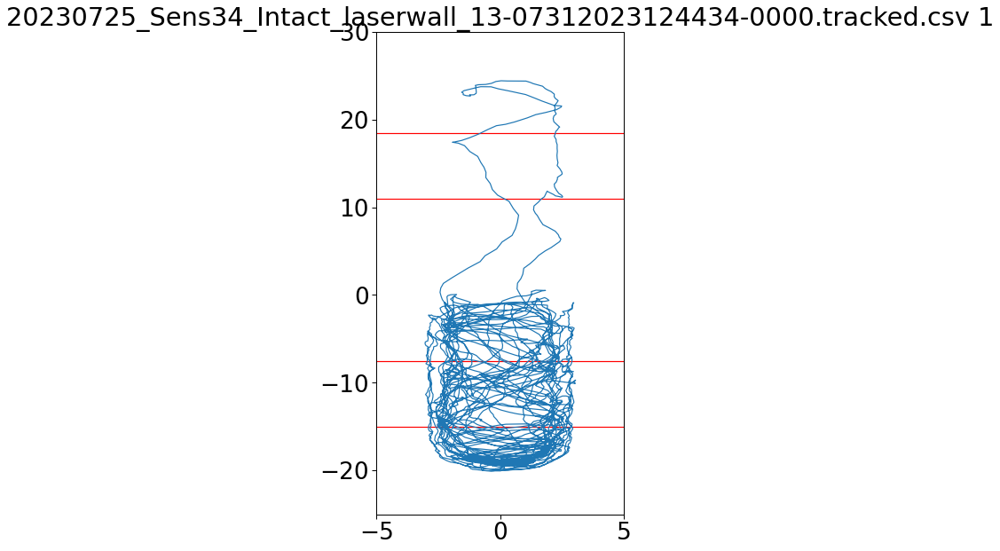

20230725_Sens34_Intact_laserwall_14-07312023125318-0000.tracked.csv


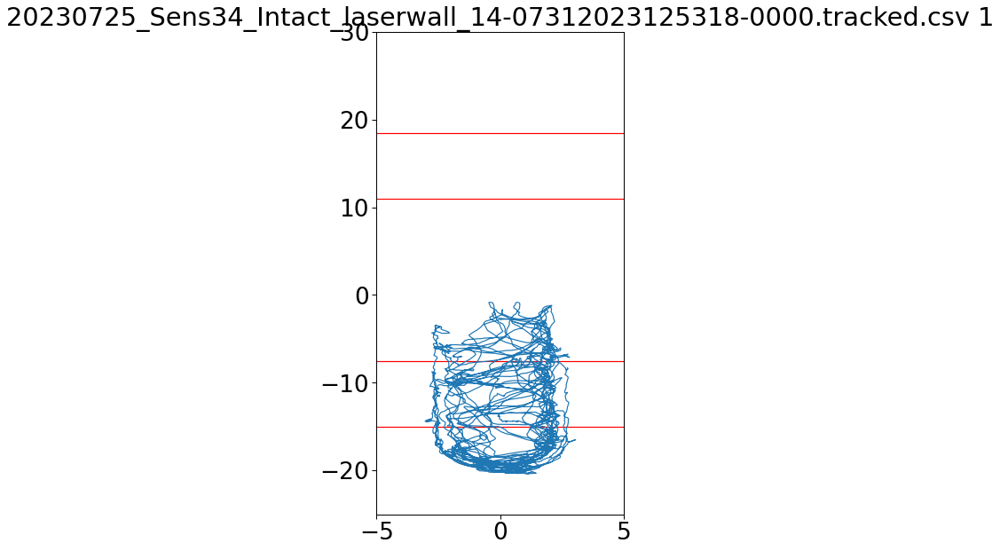

20230725_Sens34_Intact_laserwall_15-07312023130023-0000.tracked.csv


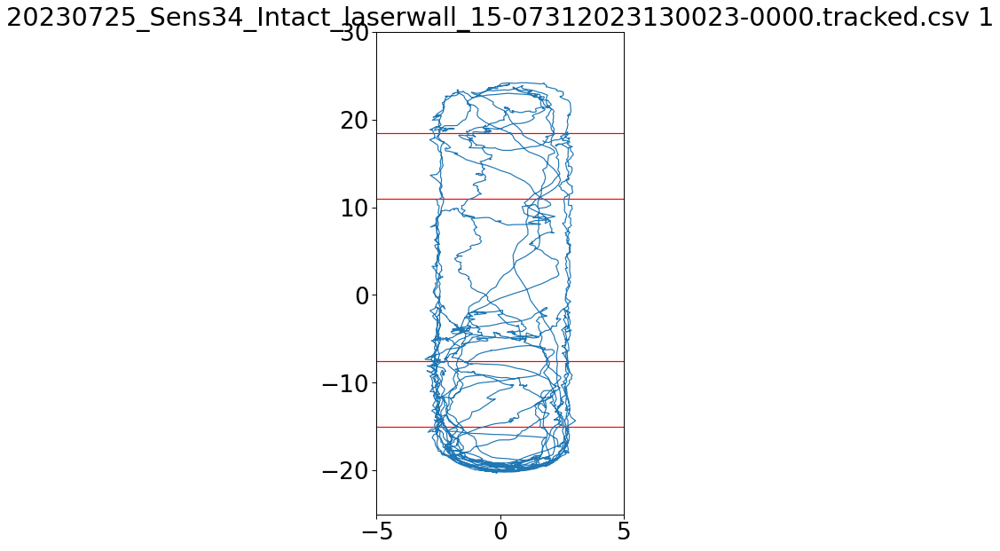

20230725_Sens34_Intact_laserwall_16-07312023135601-0000.tracked.csv


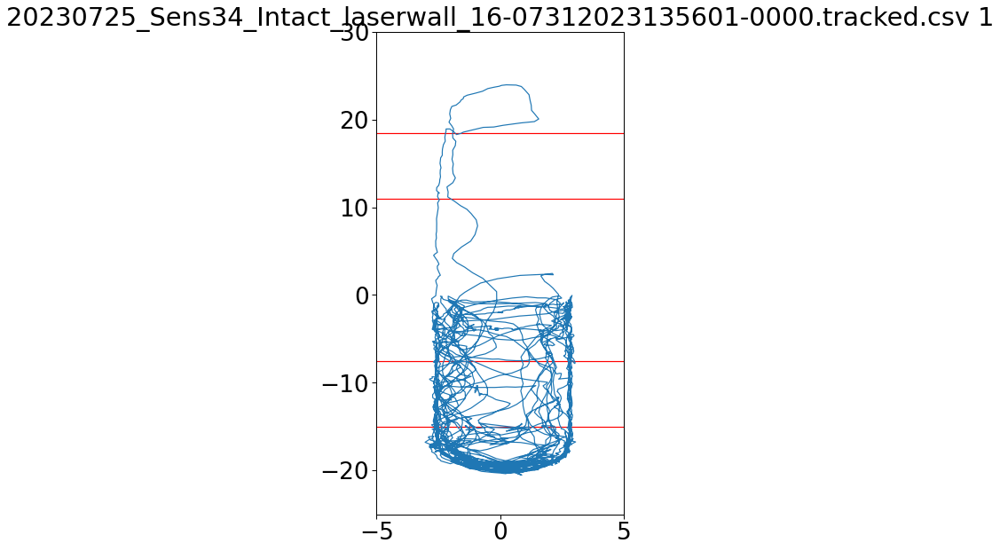

20230725_Sens34_Intact_laserwall_17-07312023140004-0000.tracked.csv


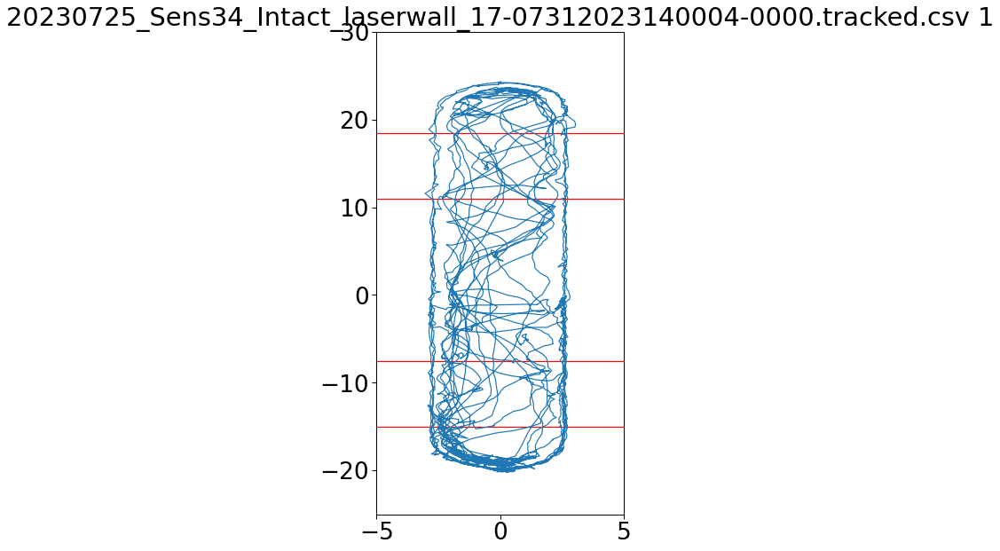

20230725_Sens34_Intact_laserwall_18-07312023140359-0000.tracked.csv


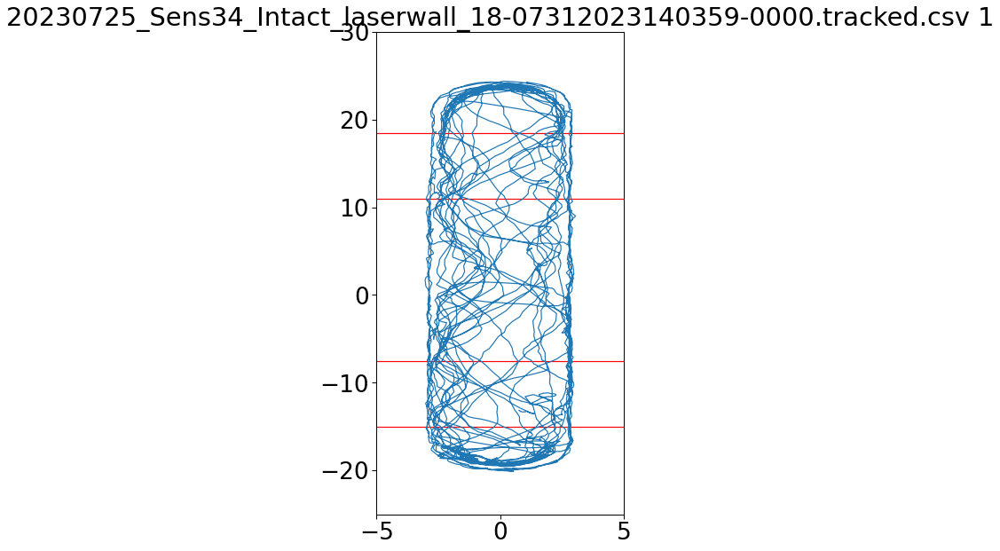

20230725_Sens34_Intact_laserwall_19-07312023140835-0000.tracked.csv


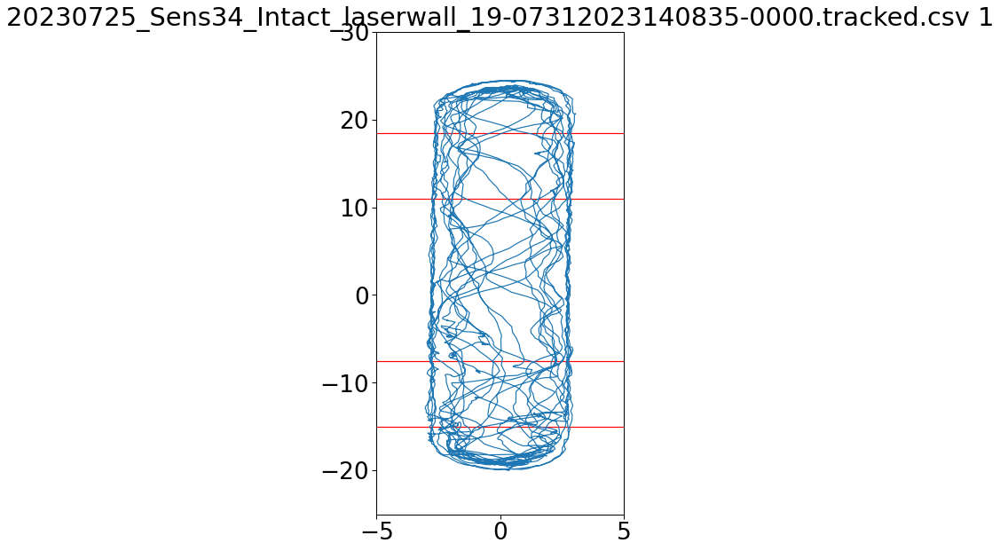

20230725_Sens34_Intact_laserwall_20-07312023141217-0000.tracked.csv


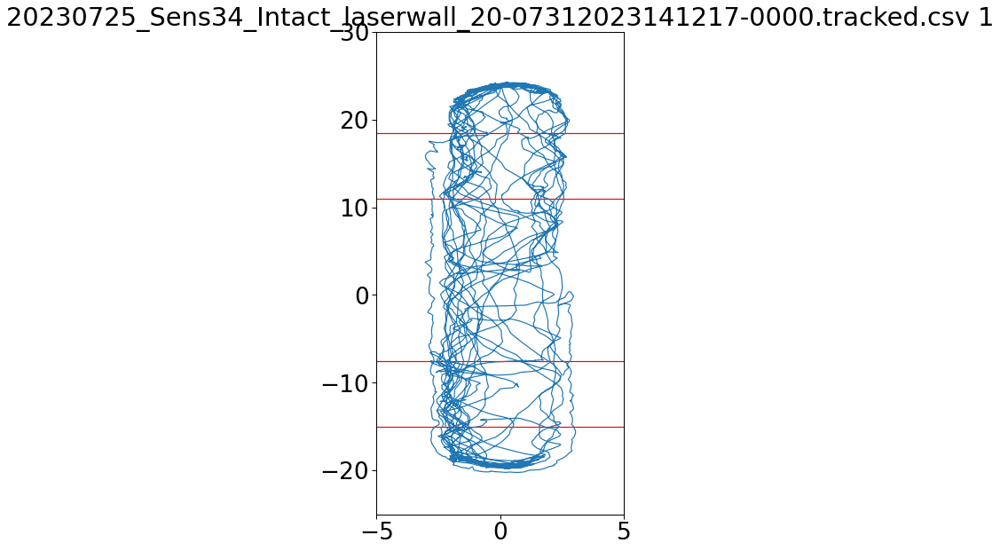

20230725_Sens34_Intact_laserwall_21-07312023141605-0000.tracked.csv


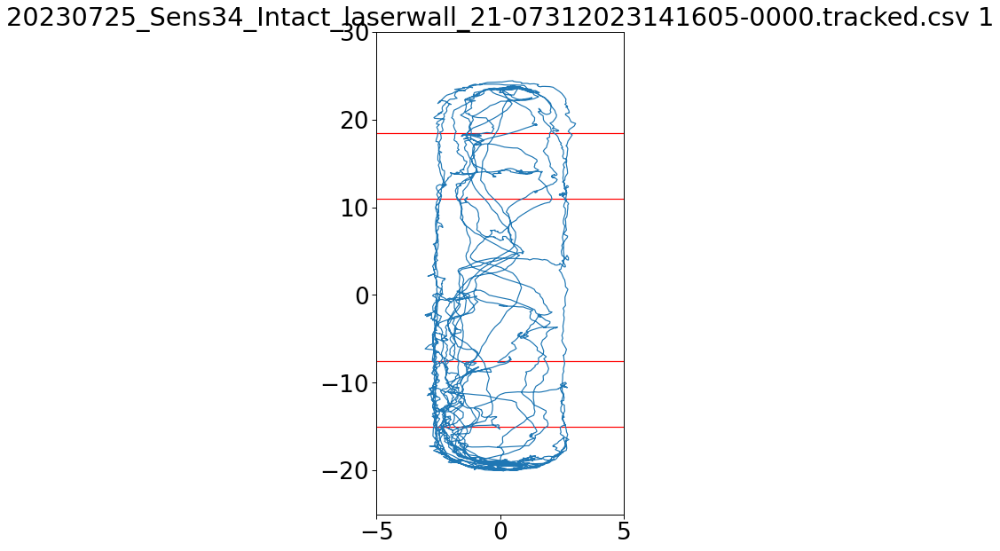

20230725_Sens34_Intact_laserwall_22-07312023142352-0000.tracked.csv


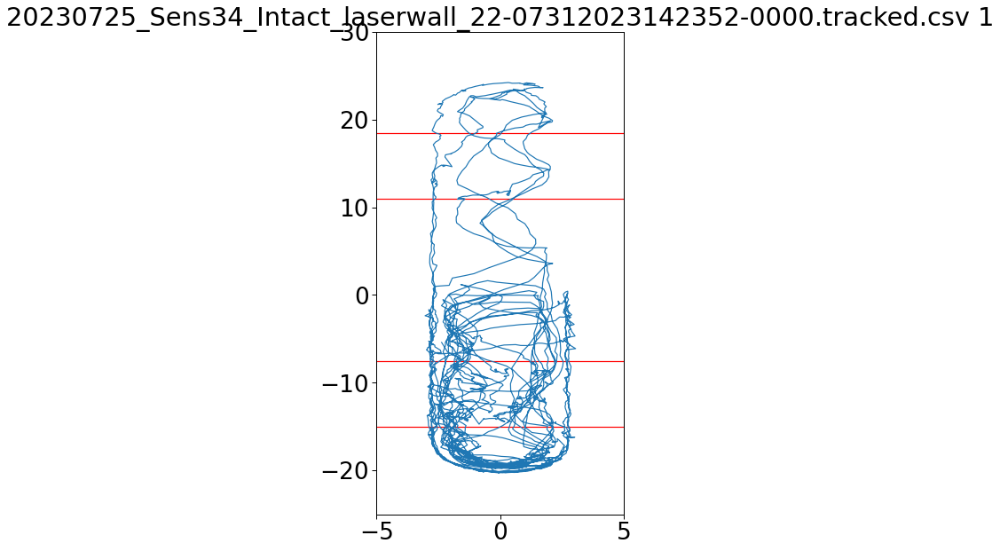

20230725_Sens34_Intact_laserwall_23-07312023142751-0000.tracked.csv


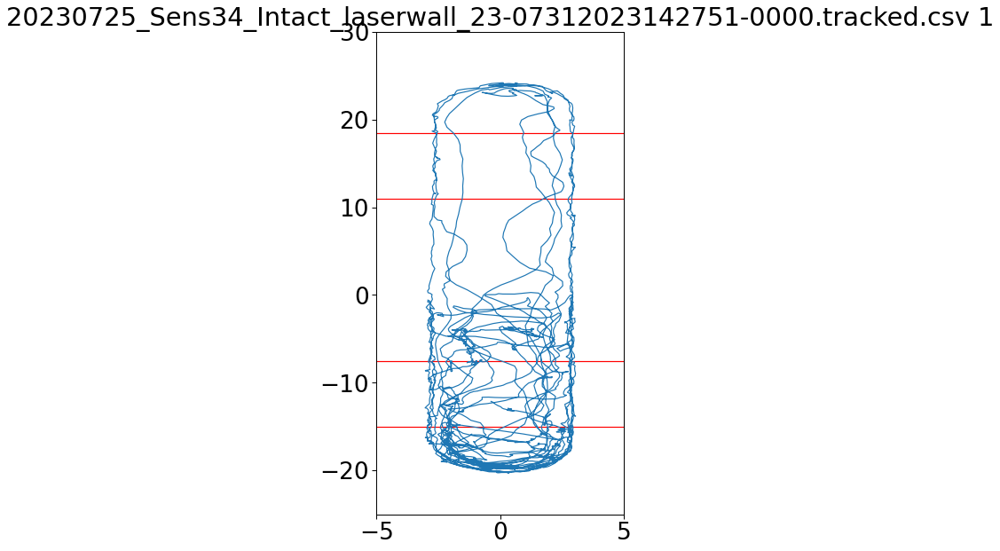

20230725_Sens34_Intact_laserwall_3.csv


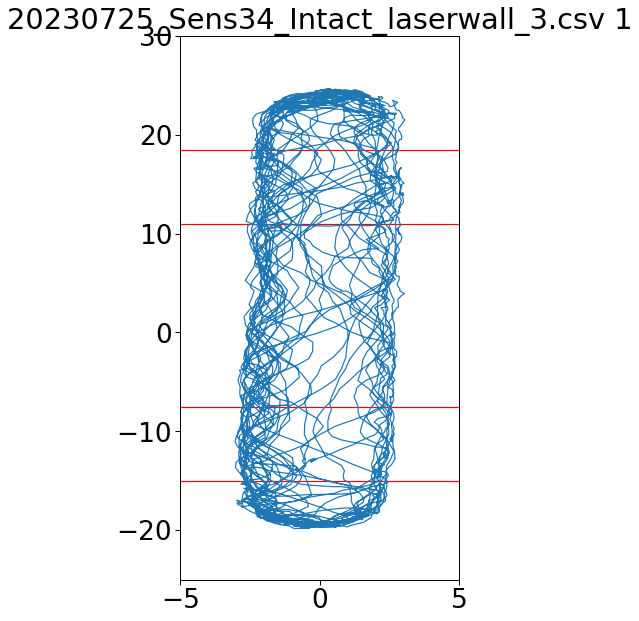

20230725_Sens34_Intact_laserwall_4.csv


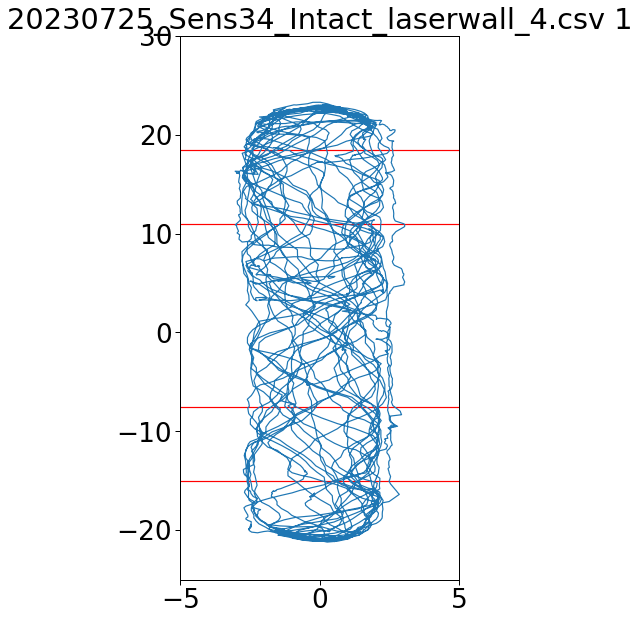

20230725_Sens34_Intact_laserwall_5.csv


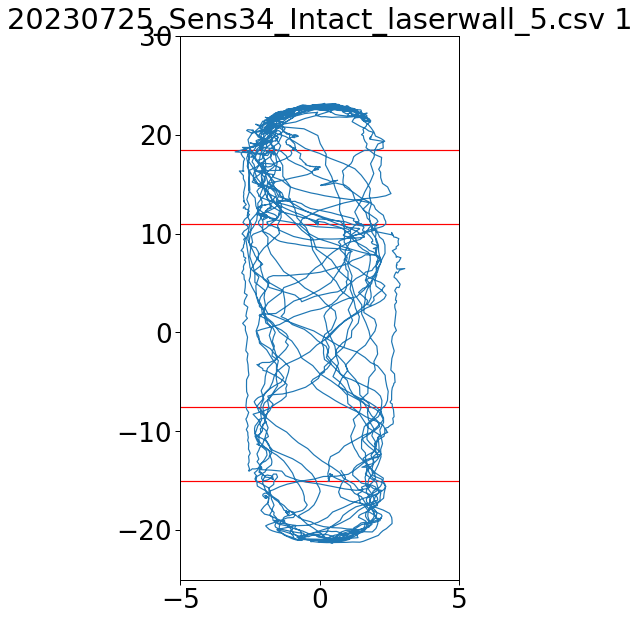

20230725_Sens34_Intact_laserwall_6.csv


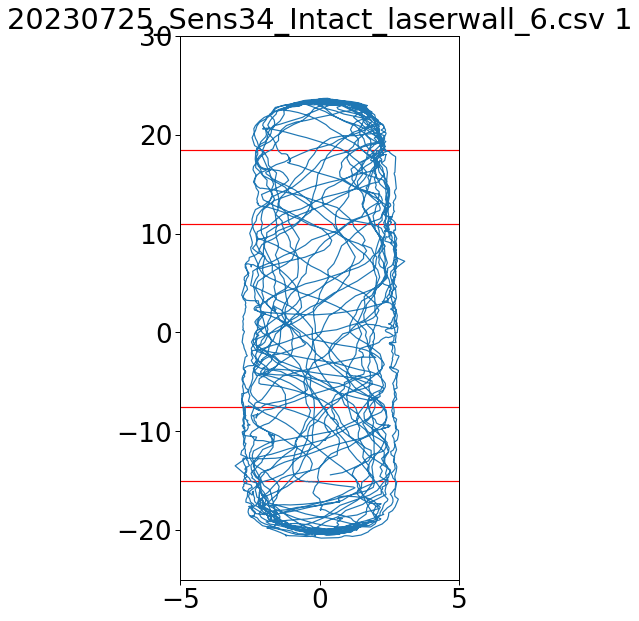

20230725_Sens34_Intact_laserwall_7.csv


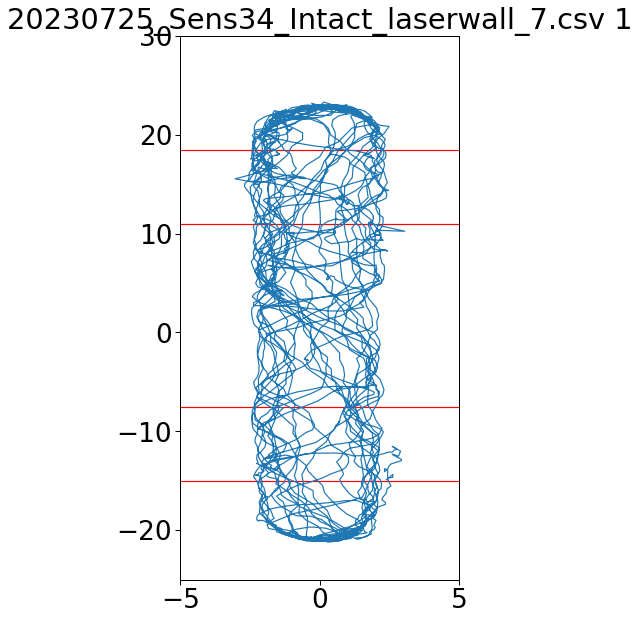

20230725_Sens34_Intact_laserwall_8.csv


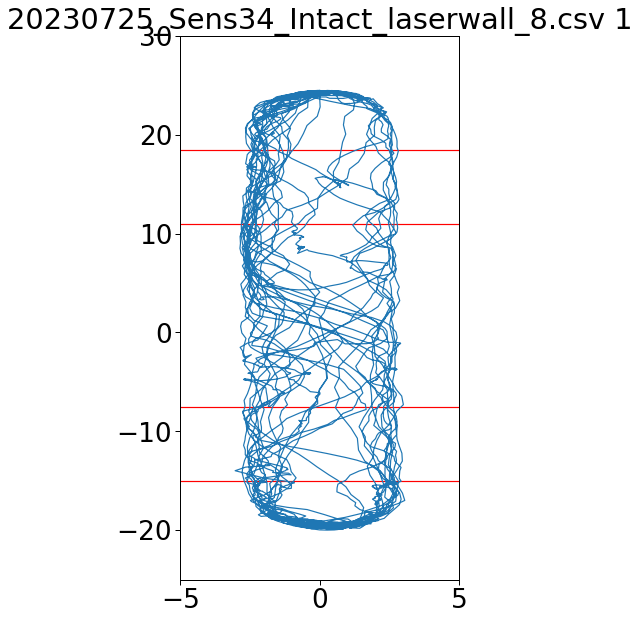

In [25]:
### Graphs showing the part of the data to use to caluclate the speed

graphs_indivs_edges(MSB7,threshold_out = 15,threshold_in = 7.5,time = 1)

In [26]:
empty_crosses, empty_reversals = crosses(empty,"empty",threshold_out = 15,threshold_in = 7.5)
#ChO_crosses,ChO_reversals = crosses(CHO,"ChO",threshold_out = 15,threshold_in = 7.5)
MSB4_crosses, MSB4_reversals = crosses(MSB4,"MSB4",threshold_out = 15,threshold_in = 7.5)
MSB5_crosses, MSB5_reversals = crosses(MSB5,"MSB5",threshold_out = 15,threshold_in = 7.5)
MSB6_crosses, MSB6_reversals = crosses(MSB6,"MSB6",threshold_out = 15,threshold_in = 7.5)
MSB7_crosses, MSB7_reversals = crosses(MSB7,"MSB7",threshold_out = 15,threshold_in = 7.5)
MSB_crosses, MSB_reversals = crosses(MSB,"MSB",threshold_out = 15,threshold_in = 7.5)


crosses_all = pd.concat([empty_crosses,MSB4_crosses,MSB5_crosses,MSB6_crosses,MSB7_crosses,MSB_crosses])
crosses_all["Cross_per_pixel"] = crosses_all["Crosses"]/crosses_all["Distance"]
crosses_all["Cross_per_meanv"] = crosses_all["Crosses"]/crosses_all["Speed_mean"]
crosses_all["Cross_per_medv"] = crosses_all["Crosses"]/crosses_all["Speed_median"]


                MSB      MSB4      MSB5          MSB6      MSB7         empty
MSB    1.000000e+00  0.000866  0.000411  4.320093e-09  0.000010  6.524898e-12
MSB4   8.658241e-04  1.000000  1.000000  2.144855e-01  1.000000  1.589629e-02
MSB5   4.110008e-04  1.000000  1.000000  4.111859e-01  1.000000  3.895943e-02
MSB6   4.320093e-09  0.214485  0.411186  1.000000e+00  1.000000  1.000000e+00
MSB7   9.585759e-06  1.000000  1.000000  1.000000e+00  1.000000  3.796070e-01
empty  6.524898e-12  0.015896  0.038959  1.000000e+00  0.379607  1.000000e+00


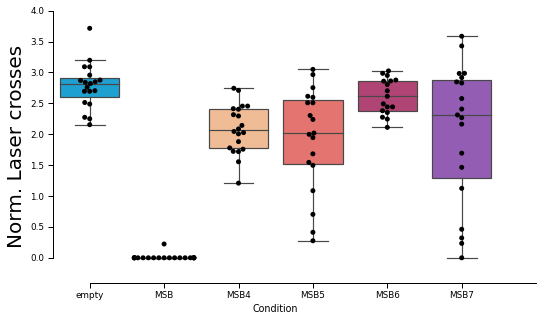

In [28]:
## CROSSES PER MEAN SPEAD - USE THIS ONE
fig, ax = plt.subplots(figsize = [8,5])
sns.set_context("paper", font_scale=1)
sns.boxplot(data=crosses_all,x="Condition",y="Cross_per_meanv",fliersize=0,order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"], palette=my_pal)
sns.swarmplot(data=crosses_all,x="Condition",y="Cross_per_meanv",color='k',order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
#sns.despine(offset=10, trim=True)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_bounds(0,4)
ax.spines['bottom'].set_bounds(0,6)
plt.ylim([-0.4,4])
plt.ylabel("Norm. Laser crosses",fontsize=20)
p_sep = scph.posthoc_dunn(crosses_all,val_col = 'Cross_per_meanv',group_col="Condition", p_adjust = 'bonferroni')
print(p_sep)

                MSB      MSB4      MSB5          MSB6      MSB7         empty
MSB    1.000000e+00  0.000155  0.000210  6.059320e-10  0.000517  6.062001e-12
MSB4   1.547269e-04  1.000000  1.000000  2.634187e-01  1.000000  5.586356e-02
MSB5   2.102685e-04  1.000000  1.000000  2.770162e-01  1.000000  6.080089e-02
MSB6   6.059320e-10  0.263419  0.277016  1.000000e+00  0.161679  1.000000e+00
MSB7   5.170366e-04  1.000000  1.000000  1.616786e-01  1.000000  3.175746e-02
empty  6.062001e-12  0.055864  0.060801  1.000000e+00  0.031757  1.000000e+00


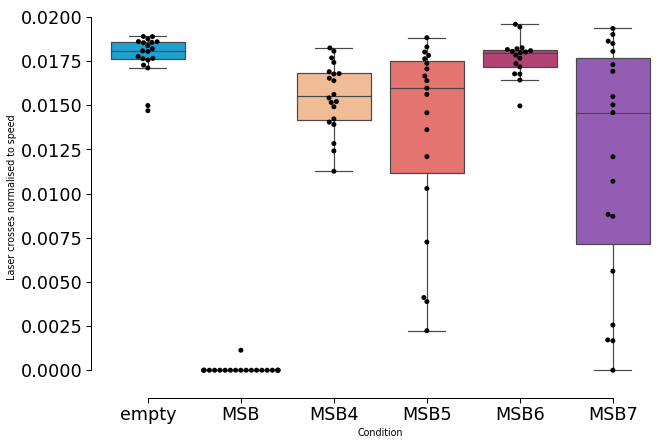

In [29]:
## CROSSES PER PIXEL - DON'T USE THIS ONE
fig, ax = plt.subplots(figsize = [10,7])
sns.set_context("paper", font_scale=2)
sns.boxplot(data=crosses_all,x="Condition",y="Cross_per_pixel",fliersize=0,order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"], palette=my_pal)
sns.swarmplot(data=crosses_all,x="Condition",y="Cross_per_pixel",color='k',order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
sns.despine(offset=10, trim=True)

plt.ylabel("Laser crosses normalised to speed")
p_sep = scph.posthoc_dunn(crosses_all,val_col = 'Cross_per_pixel',group_col="Condition", p_adjust = 'bonferroni')
print(p_sep)

## Time spent in Laser area 

In [32]:
def time_in_laser2(dataframe,threshold = 0,cond = "",graphs_indiv = "No",graphs_heat = 'Yes'):
    time = pd.DataFrame()
    
    for file in dataframe['Filename'].unique():
        #print(file)
        filtered_data = dataframe.query('Filename == @file')
        upp = laser_height_all + threshold
        low = -threshold
        threshed = filtered_data.query("norm_y > @ low and norm_y < @upp")
        #print(filtered_data.shape)
        #print(threshed)
        #NB this gives the percentage, could also be in seconds
        timez = pd.DataFrame({"Filename":[file],"Laser_time":[threshed.shape[0]*100/filtered_data.shape[0]],
                              "Condition":[cond],"speed_med":[threshed.speed.median()],
                              "speed_mean":[threshed.speed.mean()]})
        time = pd.concat([timez,time])
        if graphs_indiv == 'Yes':
            graphs_indivs(filtered_data,threshold = threshold,time = threshed.shape[0]/filtered_data.shape[0])
        
    
    if graphs_heat == "Yes":
        fig, ax = plt.subplots(figsize = [3,8])    
        #plt.rcParams.update({'font.size':20})
        ax.hist2d(dataframe.norm_x, dataframe.norm_y, bins=(50, 50), cmap=plt.cm.jet,vmin= 0, vmax= 250)

        ax.hlines(threshold,-6,6,color='r')
        ax.hlines(laser_height_all+threshold,-6,6,color='r')
        ax.set_title(cond)#[-50:-30])
        
        #ax[0].fill_between([0,200],[0,0],[empty["laser_height"].iloc[0],empty["laser_height"].iloc[0]],color='r',alpha=0.3)
        ax.set_xlim(-3.2,3.2)
        ax.set_ylim(-23,27)
        ax.set_axis_off()
        fig.savefig(save_location + cond+"_density_laser.png")    
        
    return(time)
    

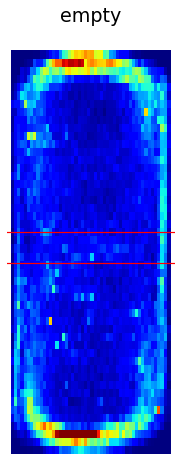

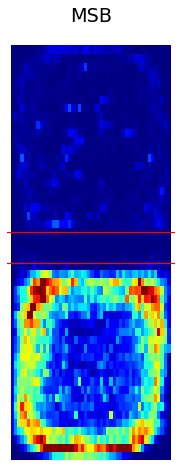

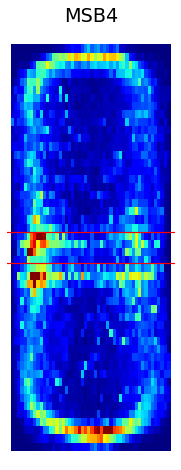

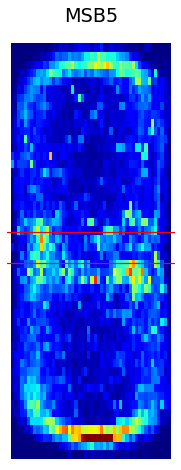

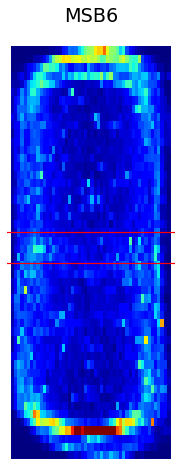

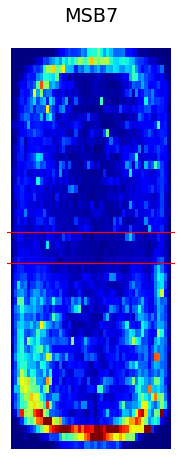

In [33]:
thres = 0
Time_in_laser_empty = time_in_laser2(empty,cond = "empty",threshold = thres)
#Time_in_laser_ChO = time_in_laser2(CHO,cond = "ChO",threshold = thres)
Time_in_laser_MSB = time_in_laser2(MSB,cond = "MSB",threshold = thres)
Time_in_laser_MSB4 = time_in_laser2(MSB4,cond = "MSB4",threshold = thres)
Time_in_laser_MSB5 = time_in_laser2(MSB5,cond = "MSB5",threshold = thres)
Time_in_laser_MSB6 = time_in_laser2(MSB6,cond = "MSB6",threshold = thres)
Time_in_laser_MSB7 = time_in_laser2(MSB7,cond = "MSB7",threshold = thres)


times_all = pd.concat([Time_in_laser_empty,Time_in_laser_MSB,Time_in_laser_MSB4,Time_in_laser_MSB5,Time_in_laser_MSB6,
                      Time_in_laser_MSB7])



### Time spent in the area of the laser

                MSB          MSB4          MSB5          MSB6          MSB7  \
MSB    1.000000e+00  3.857639e-15  5.985162e-09  8.576899e-07  5.301527e-01   
MSB4   3.857639e-15  1.000000e+00  1.000000e+00  2.294026e-01  3.310811e-08   
MSB5   5.985162e-09  1.000000e+00  1.000000e+00  1.000000e+00  6.256160e-04   
MSB6   8.576899e-07  2.294026e-01  1.000000e+00  1.000000e+00  1.240642e-02   
MSB7   5.301527e-01  3.310811e-08  6.256160e-04  1.240642e-02  1.000000e+00   
empty  2.433025e-04  2.402584e-03  8.256338e-01  1.000000e+00  4.396770e-01   

          empty  
MSB    0.000243  
MSB4   0.002403  
MSB5   0.825634  
MSB6   1.000000  
MSB7   0.439677  
empty  1.000000  


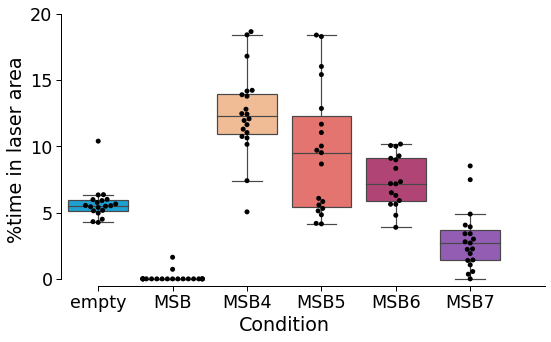

In [34]:

fig, ax = plt.subplots(figsize = [8,5])
sns.set_context("paper", font_scale=2)
g=sns.boxplot(data = times_all, x="Condition",y="Laser_time",fliersize=0,palette = my_pal,order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
sns.swarmplot(data = times_all, x="Condition",y="Laser_time",color='k',order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
# Set thetitle and labels
plt.ylabel("%time in laser area")
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_bounds(0,20)
ax.spines['bottom'].set_bounds(0,6)
plt.ylim([-0.5,20])

p_sep = scph.posthoc_dunn(times_all,val_col = 'Laser_time',group_col="Condition", p_adjust = 'bonferroni')
print(p_sep)

plt.show()

       MSB      MSB4      MSB5      MSB6      MSB7     empty
MSB    1.0  1.000000  1.000000  1.000000  1.000000  1.000000
MSB4   1.0  1.000000  1.000000  0.013373  0.000004  0.000425
MSB5   1.0  1.000000  1.000000  0.119953  0.000131  0.007392
MSB6   1.0  0.013373  0.119953  1.000000  1.000000  1.000000
MSB7   1.0  0.000004  0.000131  1.000000  1.000000  1.000000
empty  1.0  0.000425  0.007392  1.000000  1.000000  1.000000


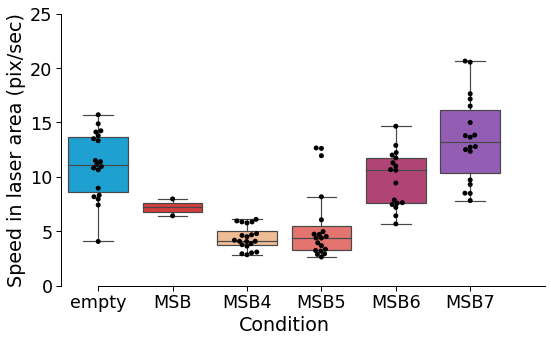

In [35]:
fig, ax = plt.subplots(figsize = [8,5])
g=sns.boxplot(data = times_all, x="Condition",y="speed_mean",palette= my_pal,fliersize=0,order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
sns.swarmplot(data = times_all, x="Condition",y="speed_mean",color='k',order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
# Set thetitle and labels
plt.ylabel("Speed in laser area (pix/sec)")
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_bounds(0,25)
ax.spines['bottom'].set_bounds(0,6)
plt.ylim([0,25])
#plt.savefig('Speed_prox_laser_MSBgroups.svg')

# Show the plot


p_sep = scph.posthoc_dunn(times_all,val_col = 'speed_mean',group_col="Condition", p_adjust = 'bonferroni')
print(p_sep)

plt.show()

### TIme spent around the edges of the laser

In [36]:
def time_around_laser_edges(dataframe,threshold_out = 5,threshold_in = 0.2,cond = "",graphs_indiv = "No",graphs_heat = "Yes"):
    time = pd.DataFrame() 
    for file in dataframe['Filename'].unique():
        #print(file)
        filtered_data = dataframe.query('Filename == @file')
        upp_u = laser_height_all + threshold_out
        upp_l = laser_height_all + threshold_in
        
        #print(upp_u)
        #print(upp_l)
        
        low_u = -threshold_in
        low_l = -threshold_out
        
        threshed_up = filtered_data.query("norm_y > @upp_l and norm_y < @upp_u")
        threshed_down = filtered_data.query("norm_y > @low_l and norm_y < @low_u")
        
        threshed_all = pd.concat([threshed_up,threshed_down])
        #print(filtered_data.shape)
        #print(threshed)
        #NB this gives the percentage, could also be in seconds
        timez = pd.DataFrame({"Filename":[file],"Laser_time":[(threshed_all.shape[0])*100/filtered_data.shape[0]],
                              "Condition":[cond],"speed":[threshed_all.speed.median()]})
        time = pd.concat([timez,time])
        if graphs_indiv == 'Yes':
            graphs_indivs_edges(filtered_data,threshold_out,threshold_in,time = (threshed_up.shape[0]+threshed_down.shape[0])/filtered_data.shape[0])
        
    
    if graphs_heat == "Yes":
        fig, ax = plt.subplots(figsize = [4,8])    
        #plt.rcParams.update({'font.size':20})
        ax.hist2d(dataframe.norm_x, dataframe.norm_y, bins=(50, 50), cmap=plt.cm.jet,vmin= 0, vmax= 250)
        ax.hlines(-threshold_out,-6,6,color='r')
        ax.hlines(-threshold_in,-6,6,color='r')
        ax.hlines(laser_height_all+threshold_out,-6,6,color='r')
        ax.hlines(laser_height_all+threshold_in,-6,6,color='r')
        ax.set_title(cond)#[-50:-30])
        
        #ax[0].fill_between([0,200],[0,0],[empty["laser_height"].iloc[0],empty["laser_height"].iloc[0]],color='r',alpha=0.3)
        ax.set_xlim(-3.2,3.2)
        ax.set_ylim(-23,27)
        ax.set_axis_off()    
        fig.savefig(save_location + cond+"density_edges.png")    
            
    
    return(time)

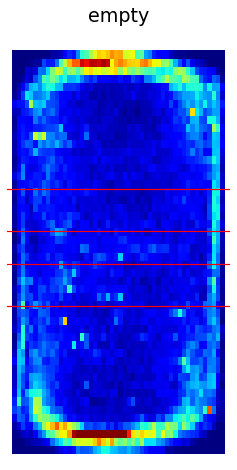

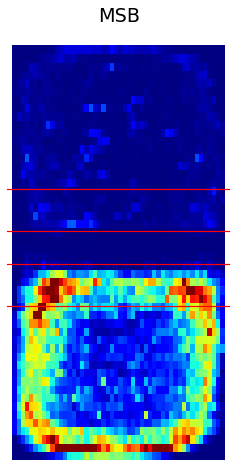

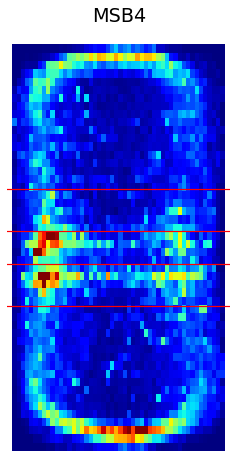

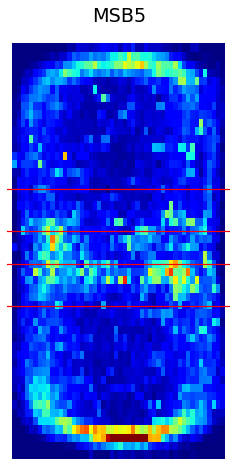

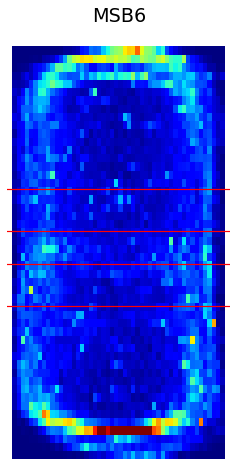

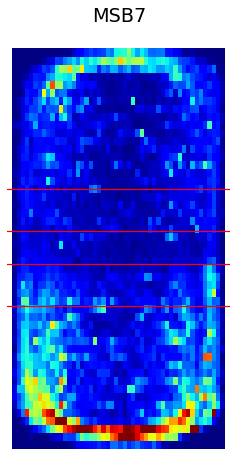

In [37]:
### NB set "graphs_indiv" to 'Yes' to see the individual graphs

Time_around_laser_edges_empty = time_around_laser_edges(empty,cond = "empty")
#Time_around_laser_edges_ChO = time_around_laser_edges(CHO,cond = "ChO")
Time_around_laser_edges_MSB = time_around_laser_edges(MSB,cond = "MSB")#,graphs_indiv = 'Yes')
Time_around_laser_edges_MSB4 = time_around_laser_edges(MSB4,cond = "MSB4")
Time_around_laser_edges_MSB5 = time_around_laser_edges(MSB5,cond = "MSB5")
Time_around_laser_edges_MSB6 = time_around_laser_edges(MSB6,cond = "MSB6")
Time_around_laser_edges_MSB7 = time_around_laser_edges(MSB7,cond = "MSB7")


times_edges_all = pd.concat([Time_around_laser_edges_empty,Time_around_laser_edges_MSB,
                             Time_around_laser_edges_MSB4,Time_around_laser_edges_MSB5,
                             Time_around_laser_edges_MSB6,Time_around_laser_edges_MSB7])

            MSB          MSB4      MSB5      MSB6          MSB7         empty
MSB    1.000000  1.000000e+00  1.000000  0.001034  2.270968e-06  2.598263e-06
MSB4   1.000000  1.000000e+00  1.000000  0.000413  6.734412e-07  7.745910e-07
MSB5   1.000000  1.000000e+00  1.000000  0.029903  2.350738e-04  2.626420e-04
MSB6   0.001034  4.128110e-04  0.029903  1.000000  1.000000e+00  1.000000e+00
MSB7   0.000002  6.734412e-07  0.000235  1.000000  1.000000e+00  1.000000e+00
empty  0.000003  7.745910e-07  0.000263  1.000000  1.000000e+00  1.000000e+00


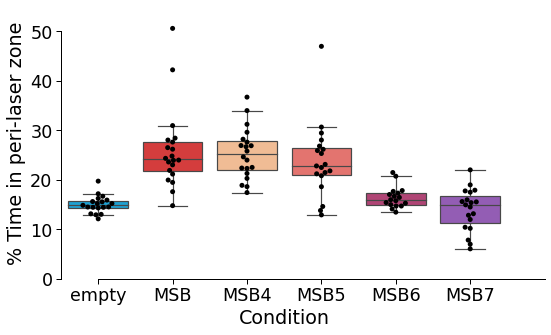

In [38]:
# Create a boxplot
fig, ax = plt.subplots(figsize = [8,5])
g=sns.boxplot(data = times_edges_all, x="Condition",y="Laser_time",palette= my_pal,fliersize=0,order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
sns.swarmplot(data = times_edges_all, x="Condition",y="Laser_time",color = 'k',order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
# Set thetitle and labels
plt.ylabel("% Time in peri-laser zone")
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_bounds(0,50)
ax.spines['bottom'].set_bounds(0,6)
plt.ylim([0,55])
#plt.savefig('Speed_prox_laser_MSBgroups.svg')
p_sep = scph.posthoc_dunn(times_edges_all,val_col = 'Laser_time',group_col="Condition", p_adjust = 'bonferroni')
print(p_sep)
# Show the plot


plt.show()

            MSB      MSB4      MSB5      MSB6      MSB7     empty
MSB    1.000000  1.000000  1.000000  0.000004  0.001413  0.000003
MSB4   1.000000  1.000000  1.000000  0.000029  0.006762  0.000023
MSB5   1.000000  1.000000  1.000000  0.000445  0.052469  0.000398
MSB6   0.000004  0.000029  0.000445  1.000000  1.000000  1.000000
MSB7   0.001413  0.006762  0.052469  1.000000  1.000000  1.000000
empty  0.000003  0.000023  0.000398  1.000000  1.000000  1.000000


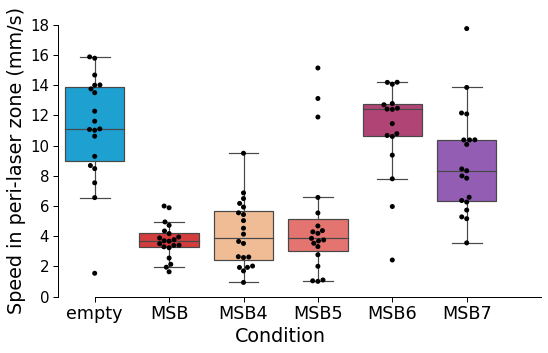

In [39]:
fig, ax = plt.subplots(figsize = [8,5])

g=sns.boxplot(data = times_edges_all, x="Condition",y="speed",fliersize = 0,palette= my_pal,order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
sns.swarmplot(data = times_edges_all, x="Condition",y="speed",color='k',order=["empty","MSB","MSB4","MSB5","MSB6","MSB7"])
# Set thetitle and labels
plt.ylabel("Speed in peri-laser zone (mm/s)")

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_bounds(0,18)
ax.spines['bottom'].set_bounds(0,6)
plt.ylim([0,18])
plt.yticks(np.arange(0,20,2),fontsize=15)
#sns.despine(offset=10, trim=True)
#plt.savefig('Speed_prox_laser_MSBgroups.svg')
p_sep = scph.posthoc_dunn(times_edges_all,val_col = 'speed',group_col="Condition", p_adjust = 'bonferroni')
print(p_sep)
# Show the plot
plt.show()

In [ ]:
## Correlations between the different speed and distance measures - DON'T USE FOR PAPER
fig, ax = plt.subplots(figsize = [10,7])
sns.scatterplot(data=crosses_all,x="Distance",y="Speed_mean")
fig, ax = plt.subplots(figsize = [10,7])
sns.scatterplot(data=crosses_all,x="Distance",y="Speed_median")
fig, ax = plt.subplots(figsize = [10,7])
sns.scatterplot(data=crosses_all,x="Speed_mean",y="Speed_median")